<center><br> <img src="https://www.iscte-iul.pt/assets/images/logo_iscte_detailed.svg" style="width: 300px;"></center><br><br>

<img src="https://radaresavista.pt/wp-content/uploads/2023/01/logo-ANSR.svg" style="width: 200px;margin-top:90px;margin-bottom:100px;" align="left">
   <div style= "font-size: 28px;font-weight:bold;margin-top:20px;margin-bottom:20px;margin-left:360px;margin-right:150px; line-height: 1.1;color:#242c64;"><center>Análise da Influência dos Radares e Tendências Temporais</center></div>
   <div style= "font-size: 17px;font-weight:bold;"><center>Projeto Aplicado para Ciência de Dados II</center></div>
   <div><center><b>Docentes:</b> Anabela Costa <b>|</b> Fernando Batista <b>|</b> Margarida Cardoso </center></div>
 <br>
    <div style= "font-size: 17px;font-weight:bold;"><center>Grupo 5</center></div>
    <div><center>André Silvestre Nº104532 </center></div>
    <div><center>Eliane Gabriel Nº103303 <b>|</b> Maria João Lourenço Nº104716 </center></div>
    <div><center>Margarida Pereira Nº105877 <b>|</b> Umeima Mahomed Nº99239</center></div>
    <br>
    <div><center><b>CDC1</b> & <b>CDC2</b></center></div>
 <br>

<div style="background: linear-gradient(to right,#95B6DF, #222E65); 
            padding: .7px; color: white; border-radius: 300px; text-align: center;">
</div>

# Índice


<ol style="list-style-type: upper-roman;font-weight: bold;">
  <li><span style = "font-weight: normal;"><a href="#1">Business Understanding</a></span></li>
  <li><span style = "font-weight: normal;"><a href="#1">Data Understanding</a></span></li>
  <li>
    <span style="font-weight: normal;">
      <a href="#2">Data Preparation</a>
    </span>
    <ol style="list-style-type:decimal;">
      <li><span style="font-weight: normal;"><a href="#DP_1Obje">1º Objetivo | Radares</a></span></li>
      <li><span style="font-weight: normal;"><a href="#DP_2Obje">2º Objetivo | Tendências</a></span></li>
      <!-- Adicione mais subitens conforme necessário -->
    </ol>
  </li>
  <li>
    <span style = "font-weight: normal;">
        <a href="#3">Modeling</a>
    </span>
    <ol style="list-style-type:decimal;">
      <li><span style="font-weight: normal;"><a href="#M_1Obje">1º Objetivo | Radares</a></span></li>
      <li><span style="font-weight: normal;"><a href="#M_2Obje">2º Objetivo | Tendências</a></span></li>
      <!-- Adicione mais subitens conforme necessário -->
    </ol>  
  </li>
  <li><span style = "font-weight: normal;"><a href="#4">Evaluation</a></span></li>
  <li><span style = "font-weight: normal;"><a href="#4">Deployment</a></span></li>
</ol>

<br>
<div style="background: linear-gradient(to right,#95B6DF, #222E65); 
            padding: .7px; color: white; border-radius: 300px; text-align: center;">
</div>
<br>

In [1]:
from IPython.core.display import HTML
HTML("""<style>ol > li::marker {font-weight: bold;font-size: 15px;}
               .output_png {display: table-cell;text-align: center;vertical-align: middle;}</style>""")

# <a class='anchor' id='1'></a>
<br>
<style>
@import url('https://fonts.cdnfonts.com/css/avenir-next-lt-pro?styles=29974');
</style>

<div style="background: linear-gradient(to right,#95B6DF, #222E65); 
            padding: 10px; color: white; border-radius: 300px; text-align: center;">
    <center><h1 style="margin-left: 140px;margin-top: 10px; margin-bottom: 4px; color: white;
                       font-size: 32px; font-family: 'Avenir Next LT Pro', sans-serif;">
        <b>1 | Business & Data Understanding</b></h1></center>
</div>

## Informação Geral sobre o Dataset | Formulação do Problema

<br>

> O conjunto de dados em análise diz respeito a **Acidentes Rodoviários que ocorreram em Portugal entre 2010 e 2019**, cuja a ocorrência tenha sido na via pública e que nela tenha origem envolvendo pelo menos um veículo em movimento, do conhecimento das entidades fiscalizadoras (*GNR* e *PSP*) e da qual resultem vítimas e/ou danos materiais.


> Para complementar a análise, utilizaram-se 2 conjuntos de dados adicional que apresentam a localização dos radares de velocidade em Portugal segundo a [**ANSR**](https://radaresavista.pt/wp-content/themes/ansr-radares/data.json) e o *website* dos [**Radares de Portugal**](https://temporeal.radaresdeportugal.pt/index.php?action=map#).

<br>


| **Coluna/Variável**               | **Descrição**                                    |
| :-------------------------------: | :----------------------------------------------- |
| **Id. Acidente**                  | Identificador único dos acidentes que ocorreram  |
| **Datahora**                      | Indica a hora e o dia em que o acidente ocorreu  |
| **Entidades Fiscalizadoras**      | GNR ou PSP                                       |
| **Velocidade local**              | Velocidade máxima permitida no local             |
| **Velocidade geral**              | Limite geral de velocidade da via                |
| **Dia da Semana**                 | Dia da semana em que ocorreu o acidente          |
| **Latitude GPS**                  | Coordenada geográfica (latitude) do local do acidente (8 dígitos, Ex.: +39,249271) |
| **Longitude GPS**                 | Coordenada geográfica (longitude) do local do acidente (8 dígitos, Ex.: -8,679199) |
| **Num. Mortos a 30 dias**         | Número de vítimas que morreram no local ou até 30 dias após a ocorrência |
| **Num. Feridos graves a 30 dias** | Número de vítimas que ficaram em ambiente hospitalar por mais de 1 dia e não faleceram nos próximos 30 dias após o acidente |
| **Num. Feridos ligeiros a 30 dias**| Número de vítimas que não são consideradas Feridos Graves, nem Mortes |
| **Características Tecnicas1**     | Condições existentes no local e momento do acidente, como características da via |
| **Cond. Aderência**               | Condições de aderência da estrada (ex.: molhado, seco, com lama, com óleo) |
| **Distrito**                      | Distrito onde ocorreu o acidente                |
| **Concelho**                      | Concelho onde ocorreu o acidente                |
| **Freguesia**                     | Freguesia onde ocorreu o acidente               |
| **Pov. Proxima**                  | Designação da povoação referente ao local do acidente (quando aplicável) |
| **Nome arruamento**               | Designação da rua, avenida, etc., onde ocorreu o acidente |
| **Tipos Vias**                    | Tipo da via onde ocorreu o acidente (ex.: Estrada Municipal, Autoestrada) |
| **Cod Via**                       | Designação abreviada da via onde ocorreu o acidente (quando aplicável) |
| **Estado Conservação**            | Condição da via em que os envolvidos circulavam (bom estado, regular, mau estado) |
| **Km**                            | Quilómetro onde ocorreu o acidente (quando aplicável) |
| **Factores Atmosféricos**         | Fator atmosférico que mais contribuiu para o acidente (ex.: chuva, neve) |
| **Reg Circulação1**               | Quantidade de sentidos da faixa de rodagem (um, dois, reversível) |
| **Intersecção Vias**              | Caracterização do local (cruzamento, entroncamento, fora da interseção) |
| **Localizações**                  | Tipo de estrada onde ocorreu o acidente (dentro, fora da localidade) |
| **Luminosidade**                  | Condições de luminosidade no momento do acidente (ex.: pleno dia, crepúsculo) |
| **Marca Via**                     | Indicação se a via possuía marcas (com marcas, sem marcas) |
| **Natureza**                      | Tipo de acidente (atropelamento, colisão, despiste, etc.) |
| **Obras Arte**                    | Se o acidente ocorreu nas imediações de obras de arte (túnel, viadutos) |
| **Obstáculos**                    | Objetos ou perigos na faixa de rodagem no momento do acidente (pedras, buracos) |
| **Sentidos**                      | No sentido crescente/decrescente da quilometragem.                     |
| **Sinais**                        | Sinalização no local do acidente (stop, cedência de passagem) |
| **Sinais Luminosos**              | Funcionamento da sinalização luminosa no momento do acidente |
| **Tipo Piso**                     | Tipo de piso onde ocorreu o acidente (calçada, terra batida, betuminoso) |
| **Traçado 1**                     | Traçado do local do acidente (reta, curva)      |
| **Traçado 2**                     | Características do perfil do local do acidente (patamar, inclinação) |
| **Traçado 3**                     | Estado da berma no local do acidente (sem, não pavimentada, pavimentada) |
| **Traçado 4**                     | Situação do acidente (plena via, na berma, no passeio) |
| **Via Trânsito**                  | Via em que o acidente ocorreu (direita, esquerda, central) |








<br>
<center><b>Figura 1 | </b> Tabela com a descrição das variáveis do <b>df_acidentes</b>.</center> 
<br> 

<br>
<br>
<br>


| **Coluna**                        | **Descrição**                                    |
| :-------------------------------: | :----------------------------------------------- |
| **Id. Acidente**                  | Identificador do acidente                           |
| **Datahora**                      | Hora e data em que o acidente ocorreu                |
| **Sexo**                          | Masculino ou Feminino                               |
| **Lesões a 30 dias**              | Ferido Mortal, Leve, Grave ou Ileso                  |
| **Licença Condução**              | Possui licença ou carta adequada ao veículo          |
| **Teste de Álcool**               | Foi submetido a teste de alcoolemia                 |
| **Acções Condutores**             | Manobra que o condutor estava a realizar no momento do acidente |
| **Inf. Comp. a Acções e Manobras**| Informação sobre erros/manobras do condutor ou outros acontecimentos relacionados, como falhas mecânicas |
| **Nomeoutrosfactores**            | Fatores que afetam o comportamento do condutor e podem ter contribuído para o acidente |
| **Tempo Condução Continuada**     | Durante quanto tempo o condutor conduziu sem parar (ex: menos 1 hora, 1 a 3 horas) |
| **Acessórios Condutores**         | Indica se na altura do acidente o condutor usava o dispositivo de segurança adequado |
| **Categoria Veículos**            | Classificações usadas para identificar diferentes veículos, como velocípede, ciclomotor |
| **Tipo Veículo**                  | Indicação do tipo de utilização do veículo, como mercadorias, passageiros, trator |
| **Tipo Serviço**                  | Indicação se o veículo é particular ou público       |
| **Veículo Especial**              | Se o veículo era considerado especial, por exemplo, uma ambulância |
| **Ano Matrícula**                 | Ano da primeira matrícula do veículo                |
| **Inspeção Periódica**            | Indicação da validade da inspeção do veículo        |
| **Certificado ADR**               | Existência do Certificado ADR para transporte de mercadorias perigosas |
| **Carga/Lotação**                 | Se o veículo tinha carga e a condição da mesma      |
| **Pneus**                         | Estado dos pneus, se tinham deficiências ou não     |
| **Seguro**                        | Existência de seguro do veículo                     |
| **Distrito**                      | Nome e código do distrito onde o acidente ocorreu   |
| **Concelho**                      | Nome e código do concelho onde o acidente ocorreu   |
| **Condutor Gr. Etário**           | Grupo etário do condutor                            |



<br>
<center><b>Figura 2 | </b> Tabela com a descrição das variáveis do <b>df_cond_veic</b>.</center> 
<br> 

---

### Questão Problema a responder

> 1. Verificar a influência da presença de radares no número dos acidentes entre 2010 e 2019 no concelho de Lisboa e recomendar locais estratégicos mais propícios para a instalação dos mesmos.
> 2. Análise das tendências temporais na incidência de acidentes em Portugal entre 2010 e 2019.

---

## 📚 Import das Bibliotecas

In [2]:
# Bibliotecas que vamos usar no Projeto
import os

# Para dados
import pandas as pd
import numpy as np
pd.set_option('display.max_colwidth', None)  # Visualizar a informação toda
pd.set_option('display.max_columns', None)
import re
from collections import defaultdict

# Para gráficos
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import datetime
import folium
from folium import plugins
from folium.plugins import HeatMapWithTime, HeatMap
from folium.map import Layer
from folium import FeatureGroup
import jinja2
from jinja2 import Template
import branca
import branca.colormap as cm
from branca.element import Element, Figure, JavascriptLink, MacroElement

# Criar a diretoria 'Gráficos', para guardar os gráficos do relatório em .svg
# if not os.path.exists('Gráficos/'):
#     os.makedirs('Gráficos/')

# Machine Learning
import scipy
import statsmodels.formula.api as smf
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn import model_selection, preprocessing, feature_selection, ensemble, linear_model, metrics, decomposition
from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from sklearn.cluster import OPTICS
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import BallTree
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX


# Estilo dos Gráficos    
plt.style.use('ggplot')
from IPython.display import display        # Allows the use of display() for DataFrames
import warnings
warnings.filterwarnings('ignore')
sns.set_style("white")

# Semente para reprodutibilidade
import random
random.seed(123)

---

## 🧮 Importar as Bases de Dados

```Python
import os                # Operating System
from tqdm import tqdm    # Barra de Progresso

# Lista para armazenar os DataFrames de acidentes e cond_veic para cada ano
acidentes_dfs = []
cond_veic_dfs = []

# Lista de anos de 2010 a 2019
anos = list(range(2010, 2020))

# Colunas a serem excluídas
cols_to_exclude_acidentes = ['Obras Arte', 'Certificado Adr', 'Sentidos', 'Entidades Fiscalizadoras', 'Km', 
                             'Pov. Proxima', 'Marca Via', 'Obstáculos', 'Sinais', 'Sinais Luminosos', 
                             'Tipo Piso','Via Trânsito']
cols_to_exclude_cond_veic = ['Datahora', 'Distrito', 'Concelho', 'Certificado Adr', 'Veiculo Especial',
                            'Licença Condução', 'Teste Alcool', 'Inspecção Periódica', 'Carga Lotação',
                             'Pneus', 'Seguros']

# Ciclo for que percorre todos os anos
for ano in tqdm(anos):
    # Construir o caminho do arquivo para acidentes e cond_veic
    file_path_acidentes = f'ANSR-acidentes/dados/acidentes-{ano}.xlsx'
    file_path_cond_veic = f'ANSR-acidentes/dados/acidentes-{ano}.xlsx'
    
    # Ler os DataFrames de acidentes e cond_veic
    df_acidentes = pd.read_excel(file_path_acidentes, sheet_name='30 Dias _ Acidentes', 
                                 usecols=lambda col: col not in cols_to_exclude_acidentes,
                                 na_values=[""," ","NA","NÃO DEFINIDO","<Sem Freguesia>"])
    df_cond_veic = pd.read_excel(file_path_cond_veic, sheet_name='30 Dias_Cond_Veic', 
                                 usecols=lambda col: col not in cols_to_exclude_cond_veic,
                                 na_values=[""," ","NA","NÃO DEFINIDO","<Sem Freguesia>"])

    # Adicionar os DataFrames à lista
    acidentes_dfs.append(df_acidentes)
    cond_veic_dfs.append(df_cond_veic)

# Concatenar todos os DataFrames em um único DataFrame para 'acidentes' e 'cond_veic'
df_acidentes = pd.concat(acidentes_dfs, ignore_index=True)
df_cond_veic = pd.concat(cond_veic_dfs, ignore_index=True)

# Guardar os DataFrames em arquivos .CSV
df_acidentes.to_csv('dados/acidentes_2010_2019.csv', sep=';', index=False)
df_cond_veic.to_csv('dados/cond_veic_2010_2019.csv', sep=';', index=False)
```

In [3]:
# Leitura das Bases de Dados compiladas
df_acidentes = pd.read_csv('dados/acidentes_2010_2019.csv', sep= ';')
df_cond_veic = pd.read_csv('dados/cond_veic_2010_2019.csv', sep= ';')

In [4]:
# Base de dados dos Acidentes
print('Nº de Colunas do "df_acidentes" sobrantes:', len(df_acidentes.columns))
df_acidentes.columns

Nº de Colunas do "df_acidentes" sobrantes: 32


Index(['Id. Acidente', 'Datahora', 'Dia', 'Mês', 'Hora', 'Velocidade local',
       'Velocidade geral', 'Dia da Semana', 'Latitude GPS', 'Longitude GPS',
       'Num. Mortos a 30 dias', 'Num. Feridos graves a 30 dias',
       'Num. Feridos ligeiros a 30 dias', 'Características Tecnicas1',
       'Cond Aderência', 'Distrito', 'Concelho', 'Freguesia',
       'Nome arruamento', 'Tipos Vias', 'Cod Via', 'Estado Conservação',
       'Factores Atmosféricos', 'Reg Circulação1', 'Intersecção Vias',
       'Localizações', 'Luminosidade', 'Natureza', 'Traçado 1', 'Traçado 2',
       'Traçado 3', 'Traçado 4'],
      dtype='object')

In [5]:
# Base de dados dos Condutores
print('Nº de Colunas do "df_cond_veic" sobrantes:', len(df_cond_veic.columns))
df_cond_veic.columns

Nº de Colunas do "df_cond_veic" sobrantes: 29


Index(['Id. Acidente', 'Sexo', 'Lesões a 30 dias', 'Acções Condutores',
       'Inf. Comp. a Acções e Manobras', 'Nomeoutrosfactores',
       'Tempo Condução Continuada', 'Acessórios Condutores',
       'Categoria Veículos', 'Tipo Veiculo', 'Tipo Serviço', 'Ano matricula',
       'Condutor Gr.Etario(<=5) SUM', 'Condutor Gr.Etario(6-9) SUM',
       'Condutor Gr.Etario(10-14) SUM', 'Condutor Gr.Etario(15-17) SUM',
       'Condutor Gr.Etario(18-20) SUM', 'Condutor Gr.Etario(21-24) SUM',
       'Condutor Gr.Etario(25-29) SUM', 'Condutor Gr.Etario(30-34) SUM',
       'Condutor Gr.Etario(35-39) SUM', 'Condutor Gr.Etario(40-44) SUM',
       'Condutor Gr.Etario(45-49) SUM', 'Condutor Gr.Etario(50-54) SUM',
       'Condutor Gr.Etario(55-59) SUM', 'Condutor Gr.Etario(65-69) SUM',
       'Condutor Gr.Etario(70-74) SUM', 'Condutor Gr.Etario(>=75) SUM',
       'Condutor Gr.Etario(Não Def.) SUM'],
      dtype='object')

In [6]:
# Observações Aleatórias da base de dados de modo a ver a sua estrutura
df_acidentes.sample(4)

,Id. Acidente,Datahora,Dia,Mês,Hora,Velocidade local,Velocidade geral,Dia da Semana,Latitude GPS,Longitude GPS,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Características Tecnicas1,Cond Aderência,Distrito,Concelho,Freguesia,Nome arruamento,Tipos Vias,Cod Via,Estado Conservação,Factores Atmosféricos,Reg Circulação1,Intersecção Vias,Localizações,Luminosidade,Natureza,Traçado 1,Traçado 2,Traçado 3,Traçado 4
141927,2014849254,2014:06:27 12:55:00,1900-01-27,1900-06-01,1900-01-01 12:55:00,120.0,120.0,Sexta-Feira,"41,174937","-8,328135",0,0,1,Auto-estrada,Seco e limpo,Porto,Trofa,São Romão Coronado,NaN,A - Auto-Estrada,A3,Em bom estado,Bom tempo,Sentido único,Fora da intersecção,Fora das localidades,Em pleno dia,Despiste com dispositivo de retenção,Recta,Com inclinação,Berma pavimentada,Em plena via
22372,2010492501,2010:08:26 11:50:00,1900-01-26,1900-08-01,1900-01-01 11:50:00,50.0,50.0,Quinta-Feira,"39,09940","9,13531",0,0,1,Estrada sem separador,Com gravilha ou areia,Lisboa,Torres Vedras,Ramalhal,NaN,EF - Estrada Florestal,0,Em mau estado,Bom tempo,Dois sentidos,Fora da intersecção,Fora das localidades,Em pleno dia,Colisão frontal,Curva,Em patamar,Sem berma ou impraticável,Em plena via
151707,2015881880,2014:10:13 16:40:00,1900-01-13,1900-10-01,1900-01-01 16:40:00,90.0,90.0,Segunda-Feira,"38,075351","-8,390833",0,0,1,Estrada sem separador,Molhado,Setúbal,Grandola,União das freguesias de Grândola e Santa Margarida da Serra,NaN,IC - Itinerário Complementar,IC33,Em bom estado,Chuva,Dois sentidos,Em entroncamento,Fora das localidades,Em pleno dia,Colisão lateral com outro veículo em movimento,Recta,Em patamar,Berma pavimentada,Em plena via
12995,2010465866,2010:05:25 05:00:00,1900-01-25,1900-05-01,1900-01-01 05:00:00,90.0,90.0,Terça-Feira,"39,18350","8,07850",0,0,1,Estrada sem separador,Molhado,Santarém,Abrantes,Bemposta,NaN,EN - Estrada Nacional,EN2,Em bom estado,Chuva,Dois sentidos,Fora da intersecção,Fora das localidades,"Noite, sem iluminação",Despiste simples,Recta,Em patamar,Sem berma ou impraticável,Em plena via


In [7]:
df_cond_veic.sample(4)

,Id. Acidente,Sexo,Lesões a 30 dias,Acções Condutores,Inf. Comp. a Acções e Manobras,Nomeoutrosfactores,Tempo Condução Continuada,Acessórios Condutores,Categoria Veículos,Tipo Veiculo,Tipo Serviço,Ano matricula,Condutor Gr.Etario(<=5) SUM,Condutor Gr.Etario(6-9) SUM,Condutor Gr.Etario(10-14) SUM,Condutor Gr.Etario(15-17) SUM,Condutor Gr.Etario(18-20) SUM,Condutor Gr.Etario(21-24) SUM,Condutor Gr.Etario(25-29) SUM,Condutor Gr.Etario(30-34) SUM,Condutor Gr.Etario(35-39) SUM,Condutor Gr.Etario(40-44) SUM,Condutor Gr.Etario(45-49) SUM,Condutor Gr.Etario(50-54) SUM,Condutor Gr.Etario(55-59) SUM,Condutor Gr.Etario(65-69) SUM,Condutor Gr.Etario(70-74) SUM,Condutor Gr.Etario(>=75) SUM,Condutor Gr.Etario(Não Def.) SUM
13704,2010455847,Masculino,Ferido leve,Em marcha normal,Não identificada,Exames Psicotrópicos,De 3 a 5 horas,Cinto de segurança,Automóvel ligeiro,Mercadorias,Particular,2006.0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
41960,2010496764,Masculino,Ileso,Em marcha normal,Não identificada,Normal,Menos de 1 hora,Cinto de segurança,Automóvel ligeiro,Passageiros,Particular,1992.0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
330175,20171207843,Feminino,Ileso,Em marcha normal,Não identificada,Normal,Menos de 1 hora,Cinto de segurança,Automóvel ligeiro,Passageiros,Particular,1998.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
50528,2010495347,Masculino,Ferido leve,Em marcha normal,Não identificada,Normal,Menos de 1 hora,Capacete,Motociclos,NaN,Particular,2000.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0


In [8]:
# Importação da base de dados dos Radares, segundo a ANSR
# Fonte: https://radaresavista.pt/wp-content/themes/ansr-radares/data.json
radares_ANSR = pd.read_json('dados/radares_ANSR.json')
radares_ANSR

,Estrada,Concelho,Freguesia,Km Inicial,Coordenada,Km Final,Tipo,EGV,Sentido,Velocidade,Fase
0,A1,Aveiro,Mealhada/Anadia,217.400,"40.441784°, -8.515219°",211.9,VM,Brisa,Norte-Sul,120,2
1,A25,Aveiro,Águeda,42.469,"40.669187°, -8.345346°",37.6,VM,Ascendi,Este-Oeste,100,2
2,A29,Aveiro,Espinho,37.300,"40.996606°, -8.617525°",_,VI,Ascendi,Sul-Norte,80,1
3,EN223,Aveiro,Santa Maria da Feira,18.820,"40.931116°, -8.523679°",_,VI,Infraestruturas de Portugal,Norte-Sul,70,1
4,IC2,Aveiro,Águeda,238.970,"40.628199, -8.464962",_,VI,Infraestruturas de Portugal,dois sentidos,90,2
...,...,...,...,...,...,...,...,...,...,...,...
93,A25,Viseu,Oliveira de Frades,52.200,"40.688134°, -8.244589°",_,VI,Ascendi,Este-Oeste,120,1
94,A25,Viseu,Vouzela,62.400,"40.693284°, -8.136925°",_,VI,Ascendi,Este-Oeste,120,1
95,A25,Viseu,Viseu,94.000,"40.651168°, -7.867431°",_,VI,Ascendi,Oeste-Este,80,1
96,A25,Viseu,Viseu,96.000,"40.643185°, -7.858440°",_,VI,Ascendi,Este-Oeste,80,1


---

In [9]:
# Importação da base de dados dos Radares, segundo a aplicação Radares de Portugal
# Fonte: https://temporeal.radaresdeportugal.pt/index.php?action=map#
# Ler o JavaScript de um ficheiro .txt retirado do código-fonte da página
with open('dados/radares_Portugal.txt', 'r') as file:
    script_text = file.read()

# Filtrar Coordenadas 'lat', 'log' e a Velocidade Máxima
pattern = re.compile(r'lat:\s*(-?\d+\.\d+),\s*lng:\s*(-?\d+\.\d+).*?icon:\s*[\'"](.*?)[\'"].*?title:\s*[\'"](.*?)[\'"]', re.DOTALL)
matches = pattern.findall(script_text)

# Criar um DataFrame com as Coordenadas e Velocidade Máxima
radares_Portugal = pd.DataFrame(
    {'Latitude': [float(match[0]) for match in matches],
     'Longitude': [float(match[1]) for match in matches],
     'Icon': [match[2] for match in matches]}
)

# Extrair a velocidade máxima do link do ícone, se disponível e eliminar a coluna 'Icon'
radares_Portugal['Speed'] = radares_Portugal['Icon'].str.extract(r'sign_max_p_speed_(\d+)')
radares_Portugal['Speed'] = radares_Portugal['Icon'].str.extract(r'sign_max_p_speed(?:_blue)?_(\d+)')
radares_Portugal = radares_Portugal.drop('Icon', axis=1)

# Adicionar a coluna 'Type' indicando se é 'VI' (Velocidade Instantânea) ou 'VM' (Velocidade Média)
radares_Portugal['Type'] = radares_Portugal['Speed'].apply(lambda x: 'VI' if pd.notna(x) else 'VM')
radares_Portugal

,Latitude,Longitude,Speed,Type
0,39.849544,-7.697532,30,VI
1,38.685530,-9.310330,50,VI
2,38.694820,-9.207240,50,VI
3,38.695270,-9.202570,50,VI
4,38.711250,-9.214930,50,VI
...,...,...,...,...
179,37.514340,-8.283580,NaN,VM
180,37.501200,-8.297750,NaN,VM
181,38.536560,-8.637540,NaN,VM
182,38.578660,-8.675700,NaN,VM


---

# <a class='anchor' id='2'></a>
<br>
<style>
@import url('https://fonts.cdnfonts.com/css/avenir-next-lt-pro?styles=29974');
</style>

<div style="background: linear-gradient(to right,#95B6DF, #222E65); 
            padding: 10px; color: white; border-radius: 300px; text-align: center;">
    <center><h1 style="margin-left: 120px;margin-top: 10px; margin-bottom: 4px; color: white;
                       font-size: 34px; font-family: 'Avenir Next LT Pro', sans-serif;"><b>2 | Data Preparation</b></h1></center>
</div>

## 🧹 Limpeza dos Dados


### Radares [ANSR](https://radaresavista.pt/)

> Fonte da Base de Dados: [📄](https://radaresavista.pt/wp-content/themes/ansr-radares/data.json)

In [10]:
# Dataframe dos Radares segundo a ANSR
radares_ANSR

,Estrada,Concelho,Freguesia,Km Inicial,Coordenada,Km Final,Tipo,EGV,Sentido,Velocidade,Fase
0,A1,Aveiro,Mealhada/Anadia,217.400,"40.441784°, -8.515219°",211.9,VM,Brisa,Norte-Sul,120,2
1,A25,Aveiro,Águeda,42.469,"40.669187°, -8.345346°",37.6,VM,Ascendi,Este-Oeste,100,2
2,A29,Aveiro,Espinho,37.300,"40.996606°, -8.617525°",_,VI,Ascendi,Sul-Norte,80,1
3,EN223,Aveiro,Santa Maria da Feira,18.820,"40.931116°, -8.523679°",_,VI,Infraestruturas de Portugal,Norte-Sul,70,1
4,IC2,Aveiro,Águeda,238.970,"40.628199, -8.464962",_,VI,Infraestruturas de Portugal,dois sentidos,90,2
...,...,...,...,...,...,...,...,...,...,...,...
93,A25,Viseu,Oliveira de Frades,52.200,"40.688134°, -8.244589°",_,VI,Ascendi,Este-Oeste,120,1
94,A25,Viseu,Vouzela,62.400,"40.693284°, -8.136925°",_,VI,Ascendi,Este-Oeste,120,1
95,A25,Viseu,Viseu,94.000,"40.651168°, -7.867431°",_,VI,Ascendi,Oeste-Este,80,1
96,A25,Viseu,Viseu,96.000,"40.643185°, -7.858440°",_,VI,Ascendi,Este-Oeste,80,1


In [11]:
# Informação sobre a base de dados toda
radares_ANSR.describe

<bound method NDFrame.describe of    Estrada Concelho             Freguesia  Km Inicial  \
0      A1    Aveiro       Mealhada/Anadia     217.400   
1      A25   Aveiro                Águeda      42.469   
2      A29   Aveiro               Espinho      37.300   
3    EN223   Aveiro  Santa Maria da Feira      18.820   
4      IC2   Aveiro                Águeda     238.970   
..     ...      ...                   ...         ...   
93     A25    Viseu    Oliveira de Frades      52.200   
94     A25    Viseu               Vouzela      62.400   
95     A25    Viseu                 Viseu      94.000   
96     A25    Viseu                 Viseu      96.000   
97   EN234   Viseu                  Nelas      88.672   

                  Coordenada Km Final Tipo                          EGV  \
0    40.441784°,  -8.515219°    211.9   VM                        Brisa   
1    40.669187°,  -8.345346°     37.6   VM                      Ascendi   
2    40.996606°,  -8.617525°        _   VI              

In [12]:
# Limpeza das 'Coordenadas' dos radares
radares_ANSR['Latitude'] = radares_ANSR['Coordenada'].str.split(',').str[0].str.strip().str.replace('°', '', regex=True).astype(float)
radares_ANSR['Longitude'] = radares_ANSR['Coordenada'].str.split(',').str[-1].str.strip().str.replace('°', '', regex=True).astype(float)

In [13]:
# Medidas descritivas da 'Latitude' e 'Longitude'
print(radares_ANSR['Latitude'].describe(), "\n\n ----- \n")
radares_ANSR['Longitude'].describe()

count    98.000000
mean     39.780801
std       1.285766
min      37.032439
25%      38.730828
50%      39.630083
75%      41.135455
max      41.519874
Name: Latitude, dtype: float64 

 ----- 



count    98.000000
mean     -8.671649
std       0.453398
min      -9.310406
25%      -9.118008
50%      -8.625366
75%      -8.453672
max      -7.340219
Name: Longitude, dtype: float64

In [14]:
# Limpeza dos 'Concelho' dos radares   
#   - Verifica-se que esta coluna não diz respeito aos 'Concelhos', mas sim aos 'Distritos'
pd.DataFrame(radares_ANSR['Concelho'].unique())

,0
0,Aveiro
1,Beja
2,Braga
3,Braga
4,Castelo Branco
5,Coimbra
6,Coimbra
7,Évora
8,Faro
9,Leiria


In [15]:
# Limpeza dos 'Freguesia' dos radares 
#    - Verifica-se que esta coluna não diz respeito às 'Freguesias' , mas sim aos 'Concelhos'
pd.DataFrame(radares_ANSR['Freguesia'].unique())

,0
0,Mealhada/Anadia
1,Águeda
2,Espinho
3,Santa Maria da Feira
4,Beja
5,Guimarães
6,Guimarães
7,Barcelos
8,Fafe
9,Braga


In [16]:
# Remover os espaços extra entre as palavras de forma a uniformizar as designações dos 'Concelho' e 'Freguesia'
radares_ANSR['Concelho'] = radares_ANSR['Concelho'].str.strip()
radares_ANSR['Freguesia'] = radares_ANSR['Freguesia'].str.strip()

In [17]:
# Restringir a 'Lisboa' [NOTA: Na base de dados o 'Concelho' representa o 'Distrito' onde o radar está colocado]
radares_ANSR_lisboa = radares_ANSR[radares_ANSR['Concelho'] == 'Lisboa']

In [18]:
# Tipos de Radares
radares_ANSR_lisboa['Tipo'].value_counts()

Tipo
VI    23
VM     3
Name: count, dtype: int64

**Codificação:**

> **`VI`** - **Velocidade Instantânea**

> **`VM`** - **Velocidade Média**

---

### Acidentes [ANSR](http://www.ansr.pt/Pages/default.aspx)

In [19]:
# Verificar duplicados
print("Número de linhas duplicadas do 'df_acidentes': ", df_acidentes.duplicated().sum(), '(', round(df_acidentes.duplicated().sum()/len(df_acidentes) * 100, 3) ,'%)')
print("Número de linhas duplicadas do 'df_cond_veic': ", df_cond_veic.duplicated().sum(), '(', round(df_cond_veic.duplicated().sum()/len(df_cond_veic) * 100, 3) ,'%)')

Número de linhas duplicadas do 'df_acidentes':  0 ( 0.0 %)
Número de linhas duplicadas do 'df_cond_veic':  19 ( 0.004 %)


In [20]:
# Verificar as 38 observações duplicados
print(len(df_cond_veic), '\n')
pd.DataFrame(df_cond_veic[df_cond_veic.duplicated(keep=False)].sort_values(by='Id. Acidente')).head(6)

495982 



,Id. Acidente,Sexo,Lesões a 30 dias,Acções Condutores,Inf. Comp. a Acções e Manobras,Nomeoutrosfactores,Tempo Condução Continuada,Acessórios Condutores,Categoria Veículos,Tipo Veiculo,Tipo Serviço,Ano matricula,Condutor Gr.Etario(<=5) SUM,Condutor Gr.Etario(6-9) SUM,Condutor Gr.Etario(10-14) SUM,Condutor Gr.Etario(15-17) SUM,Condutor Gr.Etario(18-20) SUM,Condutor Gr.Etario(21-24) SUM,Condutor Gr.Etario(25-29) SUM,Condutor Gr.Etario(30-34) SUM,Condutor Gr.Etario(35-39) SUM,Condutor Gr.Etario(40-44) SUM,Condutor Gr.Etario(45-49) SUM,Condutor Gr.Etario(50-54) SUM,Condutor Gr.Etario(55-59) SUM,Condutor Gr.Etario(65-69) SUM,Condutor Gr.Etario(70-74) SUM,Condutor Gr.Etario(>=75) SUM,Condutor Gr.Etario(Não Def.) SUM
24612,2010470448,Feminino,Ferido leve,Início de marcha,Não identificada,Normal,Menos de 1 hora,Cinto de segurança,Automóvel ligeiro,Passageiros,Particular,2008.0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
24613,2010470448,Feminino,Ferido leve,Início de marcha,Não identificada,Normal,Menos de 1 hora,Cinto de segurança,Automóvel ligeiro,Passageiros,Particular,2008.0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
25565,2010477364,Masculino,Ferido leve,Em marcha normal,Não identificada,Normal,Menos de 1 hora,Cinto de segurança,Automóvel ligeiro,Mercadorias,Particular,2006.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
25568,2010477364,Masculino,Ferido leve,Em marcha normal,Não identificada,Normal,Menos de 1 hora,Cinto de segurança,Automóvel ligeiro,Mercadorias,Particular,2006.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
33348,2010482483,Masculino,Ileso,Trânsito em filas paralelas,Obstáculo imprevisto na faixa de rodagem,Normal,De 1 a 3 horas,Cinto de segurança,Automóvel ligeiro,Passageiros,Particular,2007.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
33356,2010482483,Masculino,Ileso,Trânsito em filas paralelas,Obstáculo imprevisto na faixa de rodagem,Normal,De 1 a 3 horas,Cinto de segurança,Automóvel ligeiro,Passageiros,Particular,2007.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [21]:
# Como se verifica que realmente as 19 observações estão duplicadas, eliminámo-las
df_cond_veic = df_cond_veic.drop_duplicates()
len(df_cond_veic)

495963

In [22]:
# Informações Gerais da Base de Dados
print(f"Dimensão do df_acidentes: ",df_acidentes.shape, "\n")
df_acidentes.info()
print("\n ---- \n")
print(f"Dimensão do df_cond_veic: ",df_cond_veic.shape, "\n")
df_cond_veic.info()

Dimensão do df_acidentes:  (327384, 32) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 327384 entries, 0 to 327383
Data columns (total 32 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   Id. Acidente                     327384 non-null  int64  
 1   Datahora                         327384 non-null  object 
 2   Dia                              327384 non-null  object 
 3   Mês                              327384 non-null  object 
 4   Hora                             327384 non-null  object 
 5   Velocidade local                 324553 non-null  float64
 6   Velocidade geral                 327195 non-null  float64
 7   Dia da Semana                    327384 non-null  object 
 8   Latitude GPS                     294013 non-null  object 
 9   Longitude GPS                    293866 non-null  object 
 10  Num. Mortos a 30 dias            327384 non-null  int64  
 11  Num. Feridos graves a 3

In [23]:
# Confirmar os 'Id. Acidentes' duplicados nas bases de dados
print(f'Duplicatas em df_acidentes: {df_acidentes["Id. Acidente"].duplicated().sum()}')
print(f'Duplicatas em df_cond_veic: {df_cond_veic["Id. Acidente"].duplicated().sum()}')

Duplicatas em df_acidentes: 0
Duplicatas em df_cond_veic: 185551


#### Principais Problemas Indentificados *a priori* nas variáveis

- Variável **`Datahora`** está em formato *object*.
- Variáveis **`Dia`**, **`Mês`** e **`Hora`** não estão de acordo com a variável **`Datahora`**.

---

- Limpeza da **`Latitude GPS`** e a **`Longitude GPS`** (Valores Omissos, Dados fora de Portugal, entre outros)

---
- Nome dos **`Arruamento`** não normalizados $\rightarrow$ Ex.: "Avenida", "Av." ou "Av“

---

> Assim, procedemos à limpeza desses problemas.

---

### `DataHora`

In [24]:
# Tratamento da variável 'Datahora' para o formato datetime correto
df_acidentes['Datahora'] = pd.to_datetime(df_acidentes['Datahora'], format='%Y:%m:%d %H:%M:%S')

In [25]:
# Correção das variáveis 'Dia','Mês' com a 'Datahora' e criação das variáveis 'Hora' e 'Ano'
df_acidentes["Dia"] = df_acidentes["Datahora"].dt.day
df_acidentes["Mês"] = df_acidentes["Datahora"].dt.month
df_acidentes["Hora"] = df_acidentes["Datahora"].dt.strftime('%H:%M')
df_acidentes["Ano"] = df_acidentes["Datahora"].dt.year

---

### `Velocidade geral` e `Velocidade local`

In [26]:
# Verificar os valores possíveis da 'Velocidade geral' e 'Velocidade local'
print(df_acidentes["Velocidade geral"].unique(), '\n')
print(df_acidentes["Velocidade local"].unique())

[ 50. 120.  90.  60. 100.  80.  70.  40.  20.  30.  10. 110.  nan   0.] 

[ 50. 120.  70.  90.  60. 100.  80.  40.  30.  20.  nan  10. 110.  45.
   0.   5.  55.]


In [27]:
# Sendo sempre números inteiros, iremos colocar nesse formato
df_acidentes["Velocidade geral"] = pd.to_numeric(df_acidentes["Velocidade geral"], errors='coerce').astype('Int64')
df_acidentes["Velocidade local"] = pd.to_numeric(df_acidentes["Velocidade local"], errors='coerce').astype('Int64')

In [28]:
# Verificar conversão
df_acidentes[['Velocidade geral', 'Velocidade local']].dtypes

Velocidade geral    Int64
Velocidade local    Int64
dtype: object

---

### `Longitude GPS`/`Latitude GPS`

In [29]:
# Conversão 'Longitude GPS' e 'Latitude GPS' de 'object' para numérico
df_acidentes['Longitude GPS'] = pd.to_numeric(df_acidentes['Longitude GPS'].str.replace(',', '.'), errors='coerce')
df_acidentes['Latitude GPS'] = pd.to_numeric(df_acidentes['Latitude GPS'].str.replace(',', '.'), errors='coerce')

In [30]:
# Sumário das variáveis 'Longitude GPS' e 'Latitude GPS'
print(df_acidentes['Latitude GPS'].describe(), '\n\n-----\n')
print(df_acidentes['Longitude GPS'].describe())

count    2.940130e+05
mean     3.052853e+02
std      1.044660e+05
min     -2.239684e+01
25%      3.838166e+01
50%      3.924744e+01
75%      4.109003e+01
max      4.131355e+07
Name: Latitude GPS, dtype: float64 

-----

count    2.938650e+05
mean    -2.975963e+00
std      2.078141e+04
min     -7.423148e+06
25%     -8.774969e+00
50%     -8.399370e+00
75%     -7.486572e+00
max      8.473903e+06
Name: Longitude GPS, dtype: float64


In [31]:
# Correção do sinal da Longitude nos casos positivos (trocar para negativos)
df_acidentes['Longitude GPS'].fillna(0, inplace=True)
df_acidentes.loc[df_acidentes['Longitude GPS'] > 0, 'Longitude GPS'] *= -1

# Limitação da Latitude e Longitude a Portugal Continental considerando que:
#     - Portugal Continental tem latitude mínima de 37N e máxima de 43N 
#     - Portugal Continental tem longitude mínima 10W (-10) e máxima de 6W (-6)
df_acidentes.loc[(df_acidentes['Latitude GPS'] < 37) | (df_acidentes['Latitude GPS'] > 43), 'Latitude GPS'] = np.NaN
df_acidentes.loc[(df_acidentes['Longitude GPS'] < -10) | (df_acidentes['Longitude GPS'] > -6), 'Longitude GPS'] = np.NaN

In [32]:
# Nº de Acidentes no Distrito de Lisboa nos anos 2010-2019
print("Desde o ano de 2010 a 2019 houveram:", len(df_acidentes[(df_acidentes["Distrito"]=="Lisboa")]),"acidentes (",
      round((len(df_acidentes[df_acidentes["Distrito"] == "Lisboa"])/len(df_acidentes)) * 100, 2),"%) no distrito de Lisboa.")

Desde o ano de 2010 a 2019 houveram: 73804 acidentes ( 22.54 %) no distrito de Lisboa.


In [33]:
# Nº de Acidentes no Concelho de Lisboa nos anos 2010-2019
print("Desde o ano de 2010 a 2019 houveram:", len(df_acidentes[(df_acidentes["Concelho"]=="Lisboa")]),"acidentes (",
      round((len(df_acidentes[df_acidentes["Concelho"] == "Lisboa"])/len(df_acidentes[(df_acidentes["Distrito"]=="Lisboa")]))* 100,2),"%) no concelho de Lisboa.")

Desde o ano de 2010 a 2019 houveram: 25247 acidentes ( 34.21 %) no concelho de Lisboa.


---

In [34]:
# pip install geopandas

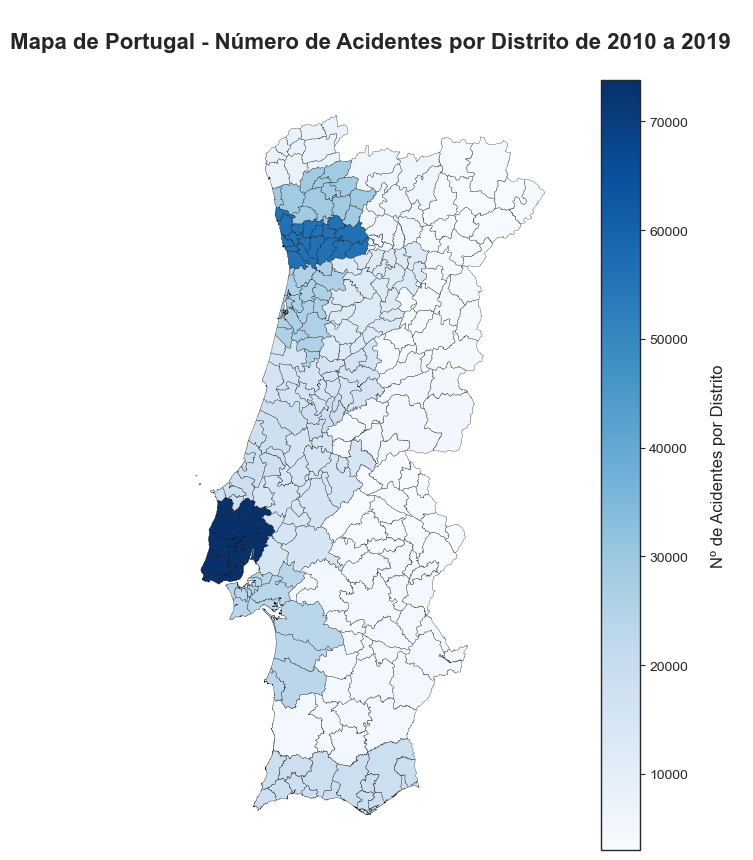

In [35]:
# Choropleth Maps: Mapa de Portugal com as cores dependentes do Nº de Acidentes
# Fonte: https://medium.com/@protobioengineering/how-to-make-colored-country-maps-in-python-tldr-edition-d58147105a8d
import geopandas as gpd

# Carregar as coordenadas de Portugal no Geopandas - Fonte: https://data.metabolismofcities.org/library/maps/35890/view/
# NAME_0: País | NAME_1: Distritos | NAME_2: Concelhos
map_dataframe = gpd.read_file("dados/Municipal Boundaries of Portugal/PRT_adm2.shx")

# Agrupar os dados de acidentes por distrito
acidentes_por_distrito = df_acidentes.groupby('Distrito').size().reset_index(name='NumAcidentes')

# Combinar ambos os dataframes ao longo das colunas de distrito
merged_dataframe = map_dataframe.merge(acidentes_por_distrito, left_on="NAME_1", right_on="Distrito")

# Criar uma Matplotlib plot/map com o dataframe combinado. Usar a coluna "NumAcidentes" para definir as cores.
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged_dataframe.plot(column="NumAcidentes", cmap="Blues", linewidth=0.2, ax=ax, edgecolor="black", legend=True,
                      legend_kwds={'label': "\nNº de Acidentes por Distrito\n", 'orientation': "vertical"})
ax.set_title("\nMapa de Portugal - Número de Acidentes por Distrito de 2010 a 2019\n", fontweight='bold', fontsize=16)
ax.set_axis_off()
sns.despine(top=True, right=True, left=True, bottom=True)
# plt.savefig("Gráficos/1_Mapa de Portugal_Número de Acidentes por Distrito de 2010 a 2019.svg",format='svg',dpi=1200)
plt.show();

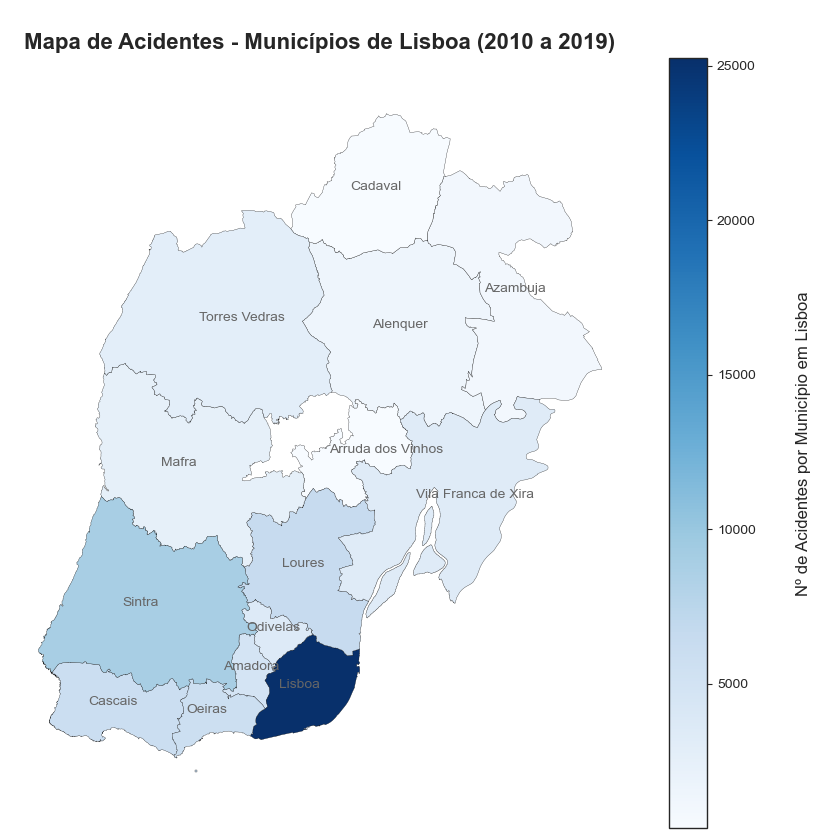

In [36]:
# Choropleth Maps: Mapa de Lisboa com as cores dos municípios dependentes do Nº de Acidentes
# Agrupar os dados de acidentes por municípios
acidentes_por_distrito = df_acidentes.groupby(['Distrito','Concelho']).size().reset_index(name='NumAcidentes')

# Combinar ambos os dataframes ao longo das colunas de municípios
merged_dataframe = map_dataframe.merge(acidentes_por_distrito, left_on="NAME_2", right_on="Concelho")

# Filtrar apenas os municípios de Lisboa
lisboa_dataframe = merged_dataframe[merged_dataframe['Distrito'] == 'Lisboa']

# Criar uma Matplotlib plot/map com o dataframe filtrado. A coluna "NumAcidentes" definir as cores.
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
lisboa_dataframe.plot(column="NumAcidentes", cmap="Blues", linewidth=0.2, ax=ax, edgecolor="0", legend=True,
                      legend_kwds={'label': "\n\nNº de Acidentes por Município em Lisboa\n", 'orientation': "vertical"})
# Adicionar os nomes dos concelhos
for x, y, label in zip(lisboa_dataframe.geometry.centroid.x, lisboa_dataframe.geometry.centroid.y, lisboa_dataframe['Concelho']):
    ax.annotate(label, xy=(x, y), xytext=(-20, 1), textcoords="offset points", fontsize=10, color='0.4')
ax.set_title("\nMapa de Acidentes - Municípios de Lisboa (2010 a 2019)\n", fontweight='bold', fontsize=16)
ax.set_axis_off()
sns.despine(top=True, right=True, left=True, bottom=True)
# plt.savefig("Gráficos/2_Mapa de Acidentes - Municípios de Lisboa (2010 a 2019).svg",format='svg',dpi=1200)
plt.show();

---

#### 🗺️ Funções Auxiliares na Representação dos Mapas **`Folium`**

In [37]:
# Classe para ver o Google Street View | Fonte: https://astro-geo-gis.com/open-street-view-with-python-folium-map/
class ClickForOneMarker(folium.ClickForMarker):
    """
    Description of the tool
    """
    _template = Template(u"""
        {% macro script(this, kwargs) %}
        const fontAwesomeIcon= L.divIcon({
            html: '<i class="fa-solid fa-3x fa-street-view" style="color:#F69423"></i>',
            iconSize: [0,0],
            iconAnchor: [15,0]
            });
        var new_mark = L.marker();
        function newMarker(e){
        new_mark.setLatLng(e.latlng).addTo({{this._parent.get_name()}});
        new_mark.setIcon(fontAwesomeIcon);
        new_mark.dragging.enable();
        new_mark.on('dblclick', function(e){ {{this._parent.get_name()}}.removeLayer(e.target)})
        var lat = e.latlng.lat.toFixed(4),
            lng = e.latlng.lng.toFixed(4);
        new_mark.bindPopup("<b>Latitude : </b>" + lat + "<br><b>Longitude : </b> " + lng +"<br> <a href=https://www.google.com/maps?layer=c&cbll=" + lat + "," + lng + " target=blank> <img src='https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png' style='width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px'></img></a>").openPopup();
        };
        {{this._parent.get_name()}}.on('click', newMarker);
        {% endmacro %}
    """)  # noqa

    def __init__(self, popup=None):
        super(ClickForOneMarker, self).__init__(popup)
        self._name = 'ClickForOneMarker'


In [38]:
# Função Auxiliar - Gerar conteúdo do pop-up para acidentes
def generate_acidentes_popup(row):
    popup_acidentes_content = f'<b>Cluster:</b> {row["Cluster"]} <br>\
                      <b>Ano:</b> {row["Ano"]} <br> \
                      <b>Data:</b> {row["Datahora"]} <br> \
                      <b>Natureza:</b> {row["Natureza"]} <br> \
                      <b>Total de Feridos:</b> {row["Total Feridos Envolvidos"]} <br> \
                      <b>Indicador de Gravidade:</b> {row["Indicador de Gravidade"]} <br> \
                      <b>Factores Atmosféricos:</b> {row["Factores Atmosféricos"]} <br> \
                      <b>Velocidade local:</b> {row["Velocidade local"]} <br> \
                      <b>Velocidade geral:</b> {row["Velocidade geral"]} <br> \
                      <b>Dia da Semana:</b> {row["Dia da Semana"]} <br> \
                      <b>Num. Mortos a 30 dias:</b> {row["Num. Mortos a 30 dias"]} <br> \
                      <b>Num. Feridos graves a 30 dias:</b> {row["Num. Feridos graves a 30 dias"]} <br> \
                      <b>Num. Feridos ligeiros a 30 dias:</b> {row["Num. Feridos ligeiros a 30 dias"]} <br> \
                      <b>Características Tecnicas1:</b> {row["Características Tecnicas1"]} <br> \
                      <b>Cond Aderência:</b> {row["Cond Aderência"]} <br> \
                      <b>Nome arruamento:</b> {row["Nome arruamento"]} <br> \
                      <b>Tipos Vias:</b> {row["Tipos Vias"]} <br> \
                      <b>Cod Via:</b> {row["Cod Via"]} <br> \
                      <b>Estado Conservação:</b> {row["Estado Conservação"]} <br> \
                      <b>Reg Circulação1:</b> {row["Reg Circulação1"]} <br> \
                      <b>Intersecção Vias:</b> {row["Intersecção Vias"]} <br> \
                      <b>Localizações:</b> {row["Localizações"]} <br> \
                      <b>Luminosidade:</b> {row["Luminosidade"]} <br> \
                      <b>Natureza:</b> {row["Natureza"]} <br> \
                      <b>Traçado 1:</b> {row["Traçado 1"]} <br> \
                      <b>Traçado 2:</b> {row["Traçado 2"]} <br> \
                      <b>Traçado 3:</b> {row["Traçado 3"]} <br> \
                      <b>Traçado 4:</b> {row["Traçado 4"]} <br> \
                      <b>Total Feridos Envolvidos:</b> {row["Total Feridos Envolvidos"]} <br> \
                      <b>Indicador de Gravidade:</b> {row["Indicador de Gravidade"]} <br> \
                      <b>Severidade:</b> {row["Severidade"]} <br><br> \
                      <a href=https://www.google.com/maps?layer=c&cbll={row["Latitude GPS"]},{row["Longitude GPS"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>'
    return popup_acidentes_content

# Função Auxiliar - Gerar conteúdo do pop-up para radares ANSR
def generate_radares_ANSR_popup(radar):
    popup_radares_ANSR_content = f'<b>Tipo:</b> {radar["Tipo"]} <br> \
                  <b>Km Inicial:</b> {radar["Km Inicial"]} <br> \
                  <b>Km Final:</b> {radar["Km Final"]} <br> \
                  <b>EGV:</b> {radar["EGV"]} <br> \
                  <b>Sentido:</b> {radar["Sentido"]} <br> \
                  <b>Velocidade:</b> {radar["Velocidade"]} <br> \
                  <b>Fase:</b> {radar["Fase"]} \
                  <a href=https://www.google.com/maps?layer=c&cbll={radar["Latitude"]},{radar["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>'
    return popup_radares_ANSR_content

In [39]:
# Google Earth Engine Python API and Folium Interactive Mapping
# Fonte: https://colab.research.google.com/github/giswqs/qgis-earthengine-examples/blob/master/Folium/ee-api-folium-setup.ipynb#scrollTo=802tXDddaTC5
basemaps = {'Google Maps': folium.TileLayer(
        tiles = 'https://mt1.google.com/vt/lyrs=m&x={x}&y={y}&z={z}',
        attr = 'Google',
        name = 'Google Maps',
        overlay = False,
        control = True
    ),
    'Google Satellite': folium.TileLayer(
        tiles = 'https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',
        attr = 'Google',
        name = 'Google Satellite',
        overlay = False,
        control = True
    )}

In [40]:
# Agrupar por mês e contar o número de acidentes em cada mês
df_acidentes_map2 = df_acidentes
df_acidentes_map2['Datahora'] = pd.to_datetime(df_acidentes_map2['Datahora'])
df_acidentes_map2['Ano'] = df_acidentes_map2['Datahora'].dt.year
year_counts = df_acidentes_map2.groupby(['Ano', 'Latitude GPS', 'Longitude GPS']).size().reset_index(name='counts')

# Criar um mapa
mapa = folium.Map()

# Criar uma lista de dados para o HeatMapWithTime
data = []
year_ = []
for year in range(2010,2020):
    year_.append(year)
    year_data = []
    for index, row in year_counts[year_counts['Ano'] == year].iterrows():
        year_data.append([row['Latitude GPS'], row['Longitude GPS'], row['counts']])
    data.append(year_data)

# Adicionar o HeatMapWithTime ao mapa
HeatMapWithTime(data, index=year_, auto_play=True, radius=15).add_to(mapa)

# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
for index, radar_ in radares_Portugal.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)

sw = df_acidentes_map2[['Latitude GPS', 'Longitude GPS']].min().values.tolist()
ne = df_acidentes_map2[['Latitude GPS', 'Longitude GPS']].max().values.tolist()
mapa.fit_bounds([sw, ne])
mapa

In [41]:
# Observar os acidentes (em 'Lisboa') no mês de 'Dezembro'
df_acidentes_map = df_acidentes[(df_acidentes["Mês"]==12) & (df_acidentes["Ano"]==2011) & (df_acidentes["Distrito"]=="Lisboa")]

# Visualização do Mapa
mapa = folium.Map()
basemaps['Google Maps'].add_to(mapa)
basemaps['Google Satellite'].add_to(mapa)
mapa.add_child(folium.LayerControl())
plugins.Fullscreen().add_to(mapa)

# Adicionar marcadores para os Acidente
for index, acidente in df_acidentes_map.dropna().iterrows():
        acidente["Cluster"] = 'Não Aplicável'
        acidente["Total Feridos Envolvidos"] = ''
        acidente["Indicador de Gravidade"] = ''
        acidente["Severidade"] = ''
        
        # Criar a localização para o marcador
        location = [acidente["Latitude GPS"], acidente["Longitude GPS"]]
        
        # Adicionar marcador ao mapa
        folium.Marker(location, 
                      popup=folium.Popup(generate_acidentes_popup(acidente), max_width=300),
                      icon=folium.Icon(color='red', icon='car', prefix='fa')).add_to(mapa)

        
        
# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
for index, radar_ in radares_Portugal.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)

sw = df_acidentes_map[['Latitude GPS', 'Longitude GPS']].min().values.tolist()
ne = df_acidentes_map[['Latitude GPS', 'Longitude GPS']].max().values.tolist()

mapa.fit_bounds([sw, ne])
mapa

---

### Idade do Condutor

In [42]:
def idade_condutor(df):
    # Definir as condições para criar a coluna Idade.Condutor
    conditions = [
        (df['Condutor Gr.Etario(<=5) SUM'] == 1) | (df['Condutor Gr.Etario(6-9) SUM'] == 1) | (df['Condutor Gr.Etario(10-14) SUM'] == 1),
        (df['Condutor Gr.Etario(15-17) SUM'] == 1),
        (df['Condutor Gr.Etario(18-20) SUM'] == 1),
        (df['Condutor Gr.Etario(21-24) SUM'] == 1) | (df['Condutor Gr.Etario(25-29) SUM'] == 1),
        (df['Condutor Gr.Etario(30-34) SUM'] == 1) | (df['Condutor Gr.Etario(35-39) SUM'] == 1),
        (df['Condutor Gr.Etario(40-44) SUM'] == 1) | (df['Condutor Gr.Etario(45-49) SUM'] == 1),
        (df['Condutor Gr.Etario(50-54) SUM'] == 1) | (df['Condutor Gr.Etario(55-59) SUM'] == 1),
        (df['Condutor Gr.Etario(65-69) SUM'] == 1),
        (df['Condutor Gr.Etario(70-74) SUM'] == 1) | (df['Condutor Gr.Etario(>=75) SUM'] == 1)
    ]

    # Definir os valores correspondentes para cada condição
    values = ["< 15", "15-17", "18-20", "21-29", "30-39", "40-49", "50-59", "65-69", ">= 70"]

    # Criar a coluna Idade.Condutor
    df['Idade.Condutor'] = pd.Series(np.select(conditions, values, default=np.nan))

    # Transformar a coluna Idade.Condutor em uma coluna do tipo categoria com as categorias especificadas
    age_categories = ["< 15", "15-17", "18-20", "21-29", "30-39", "40-49", "50-59", "65-69", ">= 70"]
    df['Idade.Condutor'] = pd.Categorical(df['Idade.Condutor'], categories=age_categories)

    # Lista de colunas de idade a serem removidas, exceto 'Idade.Condutor'
    idade_columns = [col for col in df.columns if 'Condutor Gr.Etario' in col]

    # Eliminar as colunas de idade, exceto 'Idade.Condutor'
    df.drop(columns=idade_columns, inplace=True)
    
# Aplicar aos dataframes
idade_condutor(df_cond_veic)

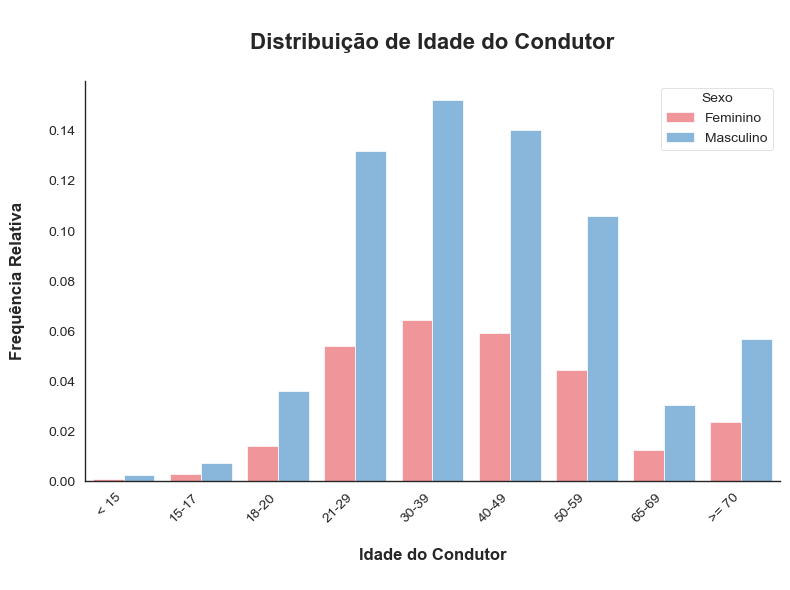

In [43]:
# Calcular frequências relativas
freq_rel_IC = df_cond_veic.groupby(['Idade.Condutor', 'Sexo']).size() / len(df_cond_veic)
freq_rel_IC = freq_rel_IC.reset_index(name='Frequencia Relativa')

# Gráfico da 'Idade.Condutor'
fig, ax = plt.subplots(figsize=(8,6))
sns.barplot(x='Idade.Condutor', y='Frequencia Relativa', hue='Sexo', palette=["#ff878d", "#7cb9e8"], data=freq_rel_IC, ax=ax)
ax.set_title('\nDistribuição de Idade do Condutor\n', fontweight='bold', fontsize=16)
ax.set_xlabel('\nIdade do Condutor\n', fontweight='bold')
ax.set_ylabel('Frequência Relativa\n', fontweight='bold')
sns.despine(top=True, right=True)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
# plt.savefig("Gráficos/Anexo C_Distribuição de Idade do Condutor.svg",format='svg',dpi=1200)
plt.show();

In [44]:
# Estudar os conduntores entre os <15 e 15-17
df_cond_veic['Idade.Condutor'].value_counts()

Idade.Condutor
30-39    107730
40-49     99313
21-29     92437
50-59     74644
>= 70     40065
18-20     24869
65-69     21260
15-17      5016
< 15       1657
Name: count, dtype: int64

In [45]:
df_cond_veic[(df_cond_veic['Idade.Condutor'] == "< 15")].groupby(df_cond_veic["Categoria Veículos"]).size()

Categoria Veículos
Automóvel ligeiro                1171
Automóvel pesado                   50
Ciclomotor                         98
Desconhecido                        2
Motociclo cilindrada <= 125cc      49
Motociclo cilindrada > 125cc       73
Motociclos                         46
Máquina industrial                  1
Quadriciclo                        11
Triciclo                            3
Velocípede                        128
Velocípede com motor                5
Veículo agrícola                   16
Veículo de tracção animal           2
Veículo sobre carris                1
dtype: int64

In [46]:
df_cond_veic[(df_cond_veic['Idade.Condutor'] == "15-17") ].groupby(df_cond_veic["Categoria Veículos"]).size()

Categoria Veículos
Automóvel ligeiro                3657
Automóvel pesado                  150
Ciclomotor                        358
Desconhecido                        5
Motociclo cilindrada <= 125cc     183
Motociclo cilindrada > 125cc      195
Motociclos                        176
Máquina industrial                  3
Quadriciclo                        35
Triciclo                            6
Velocípede                        201
Velocípede com motor               19
Veículo agrícola                   18
Veículo de tracção animal           1
Veículo sobre carris                4
dtype: int64

>A maioria dos casos com **`Idade.Condutor`** $<15$ tratam-se de **Velocípedes**.

>Já quanto a **`Idade.Condutor`** $15-17$, verifica-se que podem já ser motociclos e ciclomotores, visto ser a idade miníma permitida para a obteção do título de condução destes veículos.

Segundo o **Código da Estrada** pode-se tirar a carta de 

- **Motociclos** até $11 \; kW$ a partir dos 16 anos; 
- **Motociclos** até $35 \; kW$ a partir dos 18 anos.
---
Idades Mínimas: 
- **Motociclo** $<\; 50\; cc \rightarrow$  16 anos 
- **Motociclo** $>\; 125\; cc \rightarrow$ 18 anos
- **Ciclomotor** $\rightarrow$ 16 anos
- **Automóvel** $\rightarrow$ 18 anos
- **Quadriciclos** $\rightarrow$ 16 anos 
- **Veículo Agrícola** $\rightarrow$ 18 anos 
---

> Assim sendo, quanto aos restantes casos, iremos **eliminar os casos** que não sejam legais face ao código da estrada, sendo que são poucos comparativamente à totalidade de casos que temos e não sabemos se foi preenchida corretamente a idade.

---

### `Nome arruamento`

In [47]:
# Verificar os valores distintos da variável 'Nome arruamento' 
df_acidentes["Nome arruamento"].unique()

array([nan,
       'Praceta Alves Redol                                                                                 ',
       'AV MATA', ..., 'Rua de Baguim 676', 'Rua Aldeia - Aldeia',
       'Rua João Marques Diniz'], dtype=object)

In [48]:
# Remover espaços extras nos nomes de arruamento
df_acidentes["Nome arruamento"] = df_acidentes["Nome arruamento"].str.strip()

In [49]:
# Capitalizar a primeira letra de cada palavra
df_acidentes["Nome arruamento"] = df_acidentes["Nome arruamento"].str.title()

> Como esta informação não é imprescindível para a nossa análise e contém um elevado número de **`NAs`** , iremos deixar por uniformizar.

---

### `Cod Via`

In [50]:
# Verficar os valores possíveis da variável 'Cod Via'
df_acidentes["Cod Via"].unique()

array(['EM1192-1', 'A4', '0', ..., 'EN343-1', 'EM1396', 'EN117-3'],
      dtype=object)

> O **`"0"`** significa **Arruamento**

---

## 💥 Valores Omissos

In [51]:
# Verificar NAs
print('Nº de Valores Omissos:')
for col in df_acidentes.columns:
    missing_values = df_acidentes[col].isna().sum()
    percentage = round(missing_values / len(df_acidentes) * 100, 2)
    print(f'{col:<35}: {missing_values:<6} ({percentage}%)')

Nº de Valores Omissos:
Id. Acidente                       : 0      (0.0%)
Datahora                           : 0      (0.0%)
Dia                                : 0      (0.0%)
Mês                                : 0      (0.0%)
Hora                               : 0      (0.0%)
Velocidade local                   : 2831   (0.86%)
Velocidade geral                   : 189    (0.06%)
Dia da Semana                      : 0      (0.0%)
Latitude GPS                       : 84356  (25.77%)
Longitude GPS                      : 84719  (25.88%)
Num. Mortos a 30 dias              : 0      (0.0%)
Num. Feridos graves a 30 dias      : 0      (0.0%)
Num. Feridos ligeiros a 30 dias    : 0      (0.0%)
Características Tecnicas1          : 1778   (0.54%)
Cond Aderência                     : 1141   (0.35%)
Distrito                           : 0      (0.0%)
Concelho                           : 0      (0.0%)
Freguesia                          : 883    (0.27%)
Nome arruamento                    : 130895 (39.98

In [52]:
# Filtrar dados para os anos de 2010 e 2011 e verificar o número de NAs para Latitude e Longitude
print(f'Número de NAs para Latitude em 2010 e 2011: {df_acidentes[(df_acidentes["Ano"] == 2010) | (df_acidentes["Ano"] == 2011)]["Latitude GPS"].isna().sum()}')
print(f'Número de NAs para Longitude em 2010 e 2011: {df_acidentes[(df_acidentes["Ano"] == 2010) | (df_acidentes["Ano"] == 2011)]["Longitude GPS"].isna().sum()}')

Número de NAs para Latitude em 2010 e 2011: 46090
Número de NAs para Longitude em 2010 e 2011: 46218


In [53]:
# Lista dos anos únicos presentes no DataFrame
anos_unicos = df_acidentes['Ano'].unique()

# Iterar sobre cada ano
for ano in anos_unicos:
    # Filtrar dados para o ano atual
    df_subset = df_acidentes[df_acidentes['Ano'] == ano]
    
    # Calcular o número de NAs para Latitude e Longitude
    na_count_latitude = df_subset['Latitude GPS'].isna().sum()
    na_count_longitude = df_subset['Longitude GPS'].isna().sum()
    
    # Imprimir resultados
    print(f'Ano: {ano}')
    print(f'  Número de NAs para Latitude: {na_count_latitude}')
    print(f'  Número de NAs para Longitude: {na_count_longitude}')
    print('---')

Ano: 2010
  Número de NAs para Latitude: 24396
  Número de NAs para Longitude: 24447
---
Ano: 2011
  Número de NAs para Latitude: 21694
  Número de NAs para Longitude: 21771
---
Ano: 2012
  Número de NAs para Latitude: 18894
  Número de NAs para Longitude: 19002
---
Ano: 2013
  Número de NAs para Latitude: 8750
  Número de NAs para Longitude: 8910
---
Ano: 2014
  Número de NAs para Latitude: 60
  Número de NAs para Longitude: 56
---
Ano: 2015
  Número de NAs para Latitude: 64
  Número de NAs para Longitude: 55
---
Ano: 2016
  Número de NAs para Latitude: 83
  Número de NAs para Longitude: 65
---
Ano: 2017
  Número de NAs para Latitude: 61
  Número de NAs para Longitude: 59
---
Ano: 2018
  Número de NAs para Latitude: 2056
  Número de NAs para Longitude: 2056
---
Ano: 2019
  Número de NAs para Latitude: 8298
  Número de NAs para Longitude: 8298
---


> Dado que esta informação é fulcral para a análise do nosso 1º objetivo, resolvemos **remover os casos dos anos 2010 e 2011** da nossa análise.

> Nos restantes anos, iremos tentar importar **`NAs`** com o **KNN**.

---

# 🔎 AED - Análise Exploratória de Dados 

### 📑 Tabela de Frequências Absolutas e Relativas  e  📊 Gráficos 

- **Fonte:** https://www.kaggle.com/code/francisagbodike/visual-analysis-eda

# **`Dia da Semana`**

In [54]:
# Tabela de frequência absoluta e relativa para 'Dia da Semana'
df_acidentes['Dia da Semana'] = df_acidentes['Dia da Semana'].str.strip()
dia_semana_freq = df_acidentes['Dia da Semana'].value_counts(normalize=True) * 100
dia_semana_freq = pd.DataFrame({'n': df_acidentes['Dia da Semana'].value_counts(), 
                                '%': round(dia_semana_freq, 2)})
dia_semana_freq.index.name = 'Dia da Semana'
dia_semana_freq[['n', '%']]

,n,%
Dia da Semana,,
Sexta-Feira,51662,15.78
Segunda-Feira,48520,14.82
Quarta-Feira,47358,14.47
Quinta-Feira,46991,14.35
Terça-Feira,46625,14.24
Sábado,45603,13.93
Domingo,40625,12.41


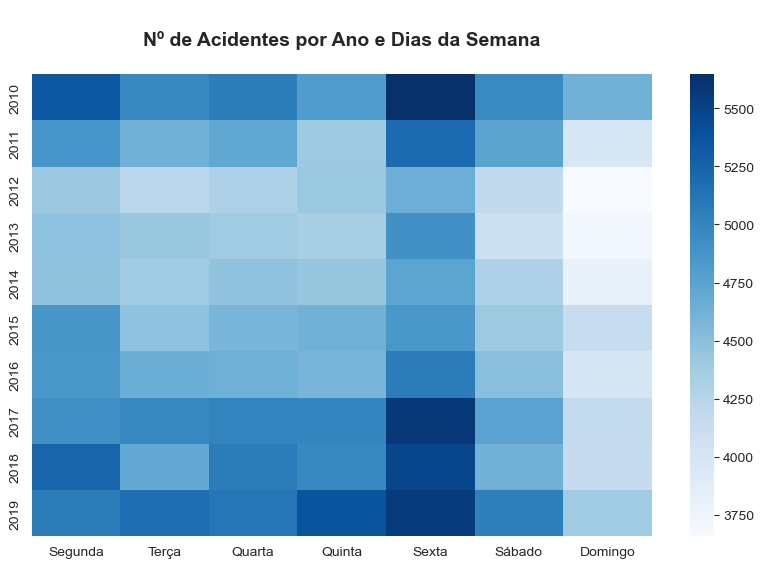

In [55]:
# Gráfico Heatmap do Nº de Acidentes por 'Ano' e 'Dias da Semana'
dia_semana_grafico = df_acidentes.groupby(['Ano', 'Dia da Semana']).size()
dia_semana_grafico = dia_semana_grafico.rename_axis(['Ano', 'Dia da Semana']).unstack('Dia da Semana')
dia_semana_grafico.columns = dia_semana_grafico.columns.str.replace('-Feira', '')
dia_semana_grafico = dia_semana_grafico.reindex(columns=['Segunda', 'Terça', 'Quarta', 'Quinta', 'Sexta', 'Sábado', 'Domingo'])

plt.figure(figsize=(10, 6))
heatmap = sns.heatmap(dia_semana_grafico, cmap='Blues')
plt.title('\nNº de Acidentes por Ano e Dias da Semana\n', fontsize=14, fontweight='bold')
plt.xlabel('')
plt.ylabel('')
heatmap.set_xticklabels(heatmap.get_xticklabels(), ha='center')
# plt.savefig("Gráficos/3_Nº de Acidentes por Ano e Dias da Semana.svg",format='svg',dpi=1200)
plt.show();

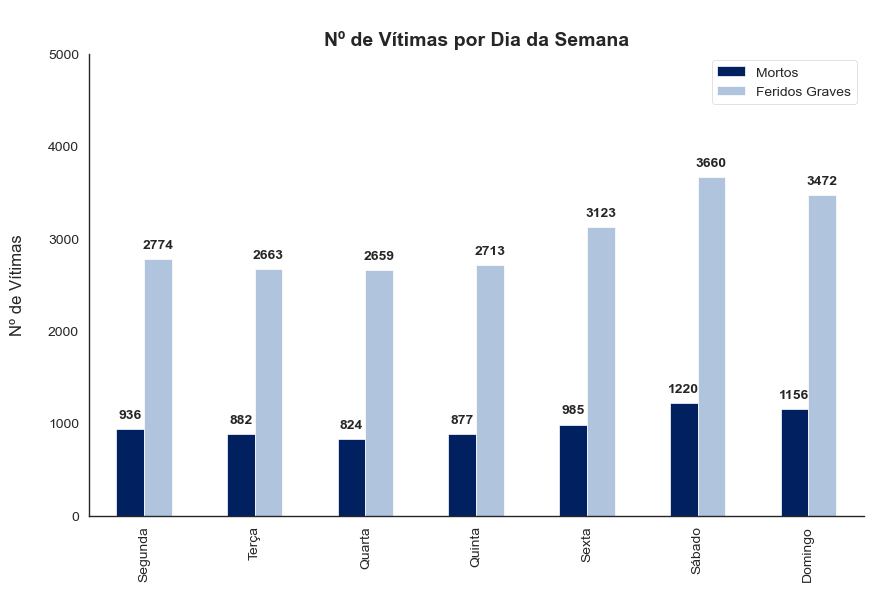

In [56]:
# Gráfico de Barras com as Vítimas Mortais, Feridos Graves e Leves segundo o dia da semana
vitimas_grafico = df_acidentes.groupby('Dia da Semana')[['Num. Mortos a 30 dias', 'Num. Feridos graves a 30 dias']].sum()
vitimas_grafico.index = vitimas_grafico.index.str.replace('-Feira', '')
vitimas_grafico = vitimas_grafico.reindex(index=['Segunda', 'Terça', 'Quarta', 'Quinta', 'Sexta', 'Sábado', 'Domingo'])
fig, ax = plt.subplots(figsize=(10,6))
vitimas_grafico.plot(kind='bar', stacked=False, color = ["#002060","#b0c4de"], ax=ax)
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points', weight="bold")    
ax.set_title('\nNº de Vítimas por Dia da Semana', fontsize=14, fontweight='bold')
ax.set_xlabel('')
ax.set_ylabel('Nº de Vítimas\n')
plt.ylim(top=5000)  
plt.legend(['Mortos', 'Feridos Graves'], loc='upper right')
sns.despine(top=True, right=True)
# plt.savefig("Gráficos/4_Nº de Vítimas por Dia da Semana.svg",format='svg',dpi=1200)
plt.show();

Para analisar a **`Hora`** do dia com maior incidência de acidentes, iremos analisar de 2 formas distintas:

1. Através de um Histograma
2. Segmentando as horas nos períodos:

- **`Madrugada `** das 0h às 4h
- **`Amanhecer`** das 5h às 8h
- **`Manhã`** das 8h às 12h
- **`Tarde`** das 12h às 16h
- **`Anoitecer`** das 16h às 20h
- **`Noite`** das 19h às 24h

In [57]:
# Arredondar as Horas
df_acidentes['Hora_Int'] = df_acidentes['Hora'].str[0:2].astype('int')

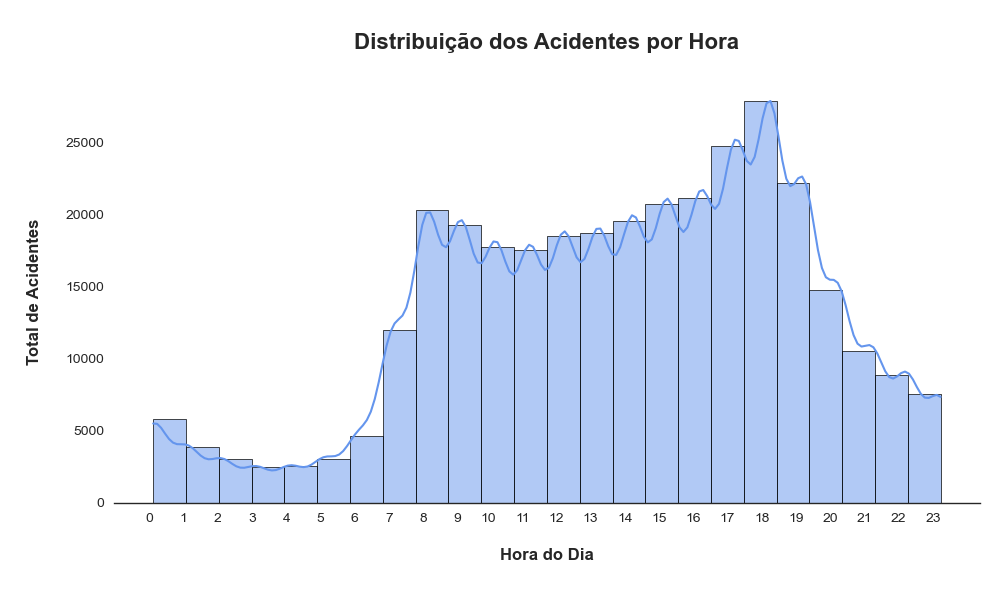

In [58]:
# Histograma com a distribuição dos acidentes por Hora 
fig, ax = plt.subplots(figsize=(10,6))

sns.histplot(df_acidentes['Hora_Int'], bins=24, ax=ax, color='cornflowerblue', edgecolor='k', kde = True)

ax.set_title('\nDistribuição dos Acidentes por Hora\n', fontweight='bold', fontsize=16)
ax.set_xlabel('\nHora do Dia\n', fontweight='bold')
ax.set_ylabel('\nTotal de Acidentes\n', fontweight='bold')
sns.despine(top=True, right=True, left=True)
plt.xticks(range(24), [str(i) for i in range(24)], ha='right')
plt.tight_layout()
# plt.savefig("Gráficos/Anexo C_Distribuição dos Acidentes por Hora.svg",format='svg',dpi=1200)
plt.show();

In [59]:
# Definir a função que transforme as horas em grupos diurnos
def when_was_it(hour):
    if hour >= 0 and hour <= 3:
        return "Madrugada (0-4)"
    elif hour >= 4 and hour <= 7:
        return "Amanhecer (4-8)"
    elif hour >= 8 and hour <= 11:
        return "Manhã (8-12)"         
    elif hour >= 12 and hour <= 15:            
        return "Tarde (12-16)"
    elif hour >= 16 and hour <= 19:
        return "Anoitecer (16-20)"
    elif hour >= 20 and hour <= 23:
        return "Noite (19-24)"

In [60]:
# Aplicar a função à coluna de 'Hora'
df_acidentes['Hora_Dia'] = df_acidentes['Hora_Int'].apply(when_was_it)
df_acidentes[['Datahora','Hora', 'Hora_Int', 'Hora_Dia']].sample(8)

,Datahora,Hora,Hora_Int,Hora_Dia
231412,2017-04-11 19:50:00,19:50,19,Anoitecer (16-20)
40408,2011-02-27 10:30:00,10:30,10,Manhã (8-12)
141355,2014-06-20 11:30:00,11:30,11,Manhã (8-12)
203779,2016-06-08 07:30:00,07:30,7,Amanhecer (4-8)
261994,2018-02-24 14:20:00,14:20,14,Tarde (12-16)
229014,2017-03-14 15:40:00,15:40,15,Tarde (12-16)
261155,2018-02-14 17:50:00,17:50,17,Anoitecer (16-20)
21359,2010-08-16 16:05:00,16:05,16,Anoitecer (16-20)


In [61]:
# Confirmar que não há valores por categorizar
df_acidentes[df_acidentes['Hora_Dia'] == '']

,Id. Acidente,Datahora,Dia,Mês,Hora,Velocidade local,Velocidade geral,Dia da Semana,Latitude GPS,Longitude GPS,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Características Tecnicas1,Cond Aderência,Distrito,Concelho,Freguesia,Nome arruamento,Tipos Vias,Cod Via,Estado Conservação,Factores Atmosféricos,Reg Circulação1,Intersecção Vias,Localizações,Luminosidade,Natureza,Traçado 1,Traçado 2,Traçado 3,Traçado 4,Ano,Hora_Int,Hora_Dia


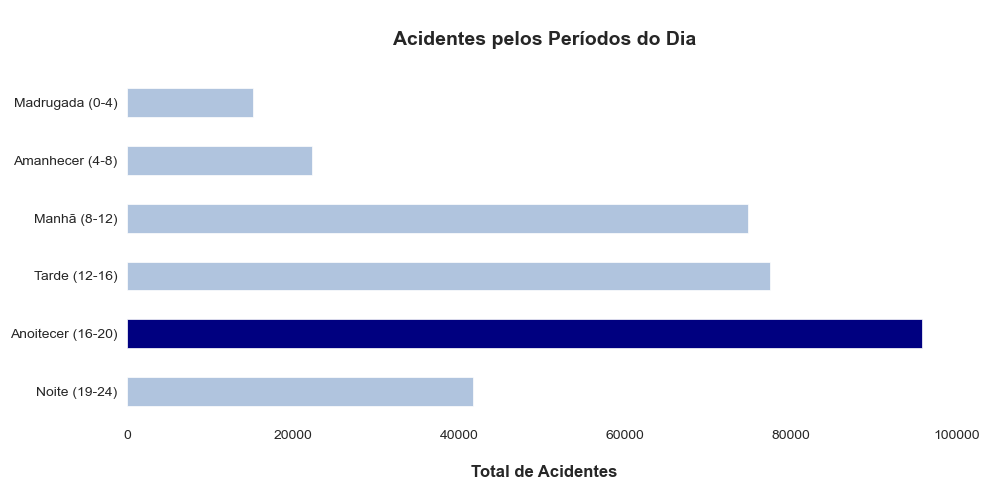

In [62]:
# Gráfico de Barras das Horas por segmentos
order = ['Madrugada (0-4)','Amanhecer (4-8)', 'Manhã (8-12)', 'Tarde (12-16)', 'Anoitecer (16-20)', 'Noite (19-24)']
df_sub = df_acidentes.groupby('Hora_Dia').size().reindex(order[::-1])

fig, ax = plt.subplots(figsize=(10, 5))
colors = ['lightsteelblue', 'lightsteelblue', 'lightsteelblue', 'lightsteelblue', 'lightsteelblue', 'navy', 'lightsteelblue']

df_sub.plot(kind='barh', ax=ax, color=colors[::-1])
ax.set_title('\nAcidentes pelos Períodos do Dia\n', fontsize=14, fontweight='bold')
ax.set_xlabel('\nTotal de Acidentes', weight='bold')
ax.set_ylabel('')
sns.despine(top=True, right=True, left=True, bottom=True)
fig.tight_layout()
# fig.savefig("Gráficos/Anexo C_Acidentes pelos Períodos do Dia.svg",format='svg',dpi=1200);

---

### **`Características Técnicas 1`**

In [63]:
caracteristicas_tecnicas = df_acidentes['Características Tecnicas1'].value_counts(normalize=True) * 100
caracteristicas_tecnicas = pd.DataFrame({'n': df_acidentes['Características Tecnicas1'].value_counts(), 
                                        '%': round(caracteristicas_tecnicas, 2)})
caracteristicas_tecnicas.index.name = 'Características Técnicas 1'
caracteristicas_tecnicas[['n', '%']]

,n,%
Características Técnicas 1,,
Estrada sem separador,265946,81.68
Outra via,39109,12.01
Auto-estrada,20551,6.31


---

### **`Condição de Aderência`**

In [64]:
aderencia = df_acidentes['Cond Aderência'].value_counts(normalize=True) * 100
aderencia = pd.DataFrame({'n': df_acidentes['Cond Aderência'].value_counts(), 
                          '%': round(aderencia, 2)})
aderencia.index.name = 'Condição de Aderência'
aderencia[['n', '%']]

,n,%
Condição de Aderência,,
Seco e limpo,236394,72.46
Molhado,50795,15.57
Húmido,33111,10.15
Com gravilha ou areia,2646,0.81
Com água acumulada na faixa de rodagem,1254,0.38
"Com gelo, geada ou neve",928,0.28
Com óleo,883,0.27
Com lama,232,0.07


---

### **`Tipos de Vias`**

In [65]:
tipos_vias = df_acidentes['Tipos Vias'].value_counts(normalize=True) * 100
tipos_vias = pd.DataFrame({'n': df_acidentes['Tipos Vias'].value_counts(), 
                           '%': round(tipos_vias, 2)})
tipos_vias.index.name = 'Tipos de Vias'
tipos_vias[['n', '%']]

,n,%
Tipos de Vias,,
Arruamento,196493,60.02
EN - Estrada Nacional,69753,21.31
A - Auto-Estrada,20540,6.27
EM - Estrada Municipal,18377,5.61
IC - Itinerário Complementar,8639,2.64
Outra Via,7447,2.27
IP- Itinerário Principal,2808,0.86
ER - Estrada Regional,1651,0.50
VAR - Variante,927,0.28


---

### **`Tipo de Veículo`**

In [66]:
tipo_veiculo = df_cond_veic['Tipo Veiculo'].value_counts(normalize=True) * 100
tipo_veiculo = pd.DataFrame({'n': df_cond_veic['Tipo Veiculo'].value_counts(), 
                           '%': round(tipo_veiculo, 2)})
tipo_veiculo.index.name = 'Tipo de Veiculo'
tipo_veiculo[['n', '%']]

,n,%
Tipo de Veiculo,,
Passageiros,311273,78.01
Mercadorias,80723,20.23
Veículo Especial,2662,0.67
Misto,2625,0.66
Tractor,1753,0.44


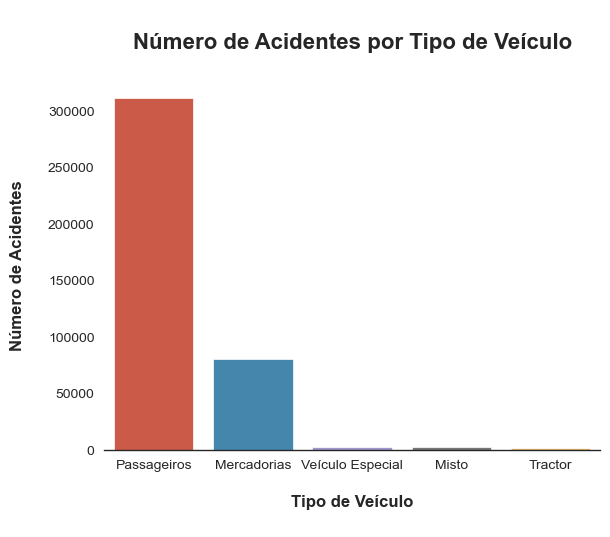

In [67]:
# Gráfico de Barras: Número de Acidentes por Tipo de Veículo
tipo_veiculo_counts = df_cond_veic['Tipo Veiculo'].value_counts()
ax = sns.barplot(x=tipo_veiculo_counts.index, y=tipo_veiculo_counts.values)

ax.set_title('\nNúmero de Acidentes por Tipo de Veículo\n', fontweight='bold', fontsize=16)
ax.set_xlabel('\nTipo de Veículo\n', fontweight='bold')
ax.set_ylabel('Número de Acidentes\n', fontweight='bold')
sns.despine(top=True, right=True, left=True)
plt.show()

---

### **`Natureza`**

In [68]:
natureza = df_acidentes['Natureza'].value_counts(normalize=True) * 100
natureza = pd.DataFrame({'n': df_acidentes['Natureza'].value_counts(), 
                         '%': round(natureza, 2)})
natureza.index.name = 'Natureza'
natureza[['n', '%']]

,n,%
Natureza,,
Colisão lateral com outro veículo em movimento,59630,18.21
Despiste simples,51552,15.75
Atropelamento de peões,47654,14.56
Colisão traseira com outro veículo em movimento,35855,10.95
Colisão frontal,29418,8.99
Colisão com outras situações,22743,6.95
Despiste com capotamento,19723,6.02
Despiste sem dispositivo de retenção,13775,4.21
Despiste com colisão com veículo imobil. ou obstáculo,11446,3.50


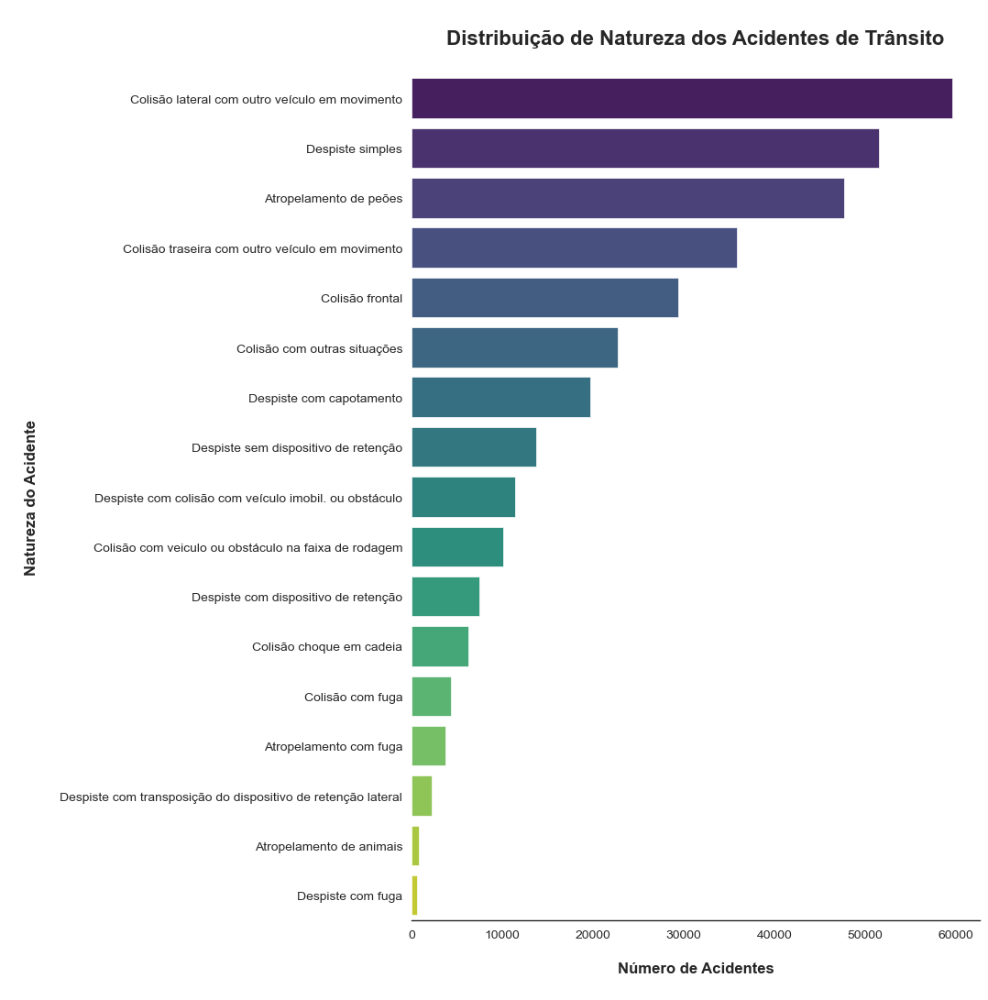

In [69]:
# Gráfico de Barras - Natureza dos Acidentes
# Ordenar os dados pela frequência
natureza = df_acidentes['Natureza'].value_counts().reset_index(name='n').sort_values(by='n', ascending=False)

# Criar o gráfico de barras horizontal
plt.figure(figsize=(8, 12))
ax = sns.barplot(x='n', y=natureza.columns[0], data=natureza, palette='viridis')
ax.set_xlabel('\nNúmero de Acidentes\n', fontweight='bold')
ax.set_ylabel('\nNatureza do Acidente\n', fontweight='bold')
plt.title('\nDistribuição de Natureza dos Acidentes de Trânsito\n', fontsize=16, fontweight='bold')
sns.despine(top=True, right=True, left=True)
# fig.savefig("Gráficos/Anexo C_Natureza do Acidente.svg",format='svg',dpi=1200)
plt.show();

---

### **`Luminosidade`**

In [70]:
luminosidade = df_acidentes['Luminosidade'].value_counts(normalize=True) * 100
luminosidade = pd.DataFrame({'n': df_acidentes['Luminosidade'].value_counts(), 
                             '%': round(luminosidade, 2)})
luminosidade.index.name = 'Luminosidade'
luminosidade[['n', '%']]

,n,%
Luminosidade,,
Em pleno dia,233268,71.39
"Noite, com iluminação",58763,17.99
"Noite, sem iluminação",22235,6.81
Aurora ou crepúsculo,10694,3.27
Sol escandeante,1770,0.54


---

### **`Estado de Conservação`**

In [71]:
estado_conservacao = df_acidentes['Estado Conservação'].value_counts(normalize=True) * 100
estado_conservacao = pd.DataFrame({'n': df_acidentes['Estado Conservação'].value_counts(), 
                                  '%': round(estado_conservacao, 2)})
estado_conservacao.index.name = 'Estado de Conservação'
estado_conservacao[['n', '%']]

,n,%
Estado de Conservação,,
Em bom estado,180475,55.29
Em estado regular,139178,42.63
Em mau estado,6791,2.08


---

### **`Fatores Atmosféricos`**

In [72]:
fatores_atmosfericos = df_acidentes['Factores Atmosféricos'].value_counts(normalize=True) * 100
fatores_atmosfericos = pd.DataFrame({'n': df_acidentes['Factores Atmosféricos'].value_counts(), 
                                     '%': round(fatores_atmosfericos, 2)})
fatores_atmosfericos.index.name = 'Fatores Atmosféricos'
fatores_atmosfericos[['n', '%']]

,n,%
Fatores Atmosféricos,,
Bom tempo,259411,79.57
Chuva,63925,19.61
Nevoeiro,1947,0.60
Vento Forte,293,0.09
Granizo,236,0.07
Neve,155,0.05
Nuvem de fumo,32,0.01


---

### **`Feridos Ligeiros, Graves e Mortos`**

---

Segundo as definições da [ANSR](http://www.ansr.pt/Estatisticas/RelatoriosDeSinistralidade/Documents/2019/Relat%C3%B3rio%20Anual%20Sinistralidade%20Rodovi%C3%A1ria%202019.pdf)
- **Acidente com vítimas mortais (AcVM):** Acidente do qual resulte pelo menos um morto.

- **Acidente com feridos graves (AcFG):** Acidente do qual resulte pelo menos um ferido grave, não tendo ocorrido qualquer morte.

- **Acidente com feridos leves (AcFL):** Acidente do qual resulte pelo menos um ferido leve e em que não se tenham registado mortos nem feridos graves.
<br>
- **Indicador de Gravidade (IG):**
$$𝐼𝐺 = 100 \times 𝑉𝑀 + 10 \times 𝐹𝐺 + 3 \times 𝐹𝐿$$
<br>Onde $VM$ é o número de mortos, $FG$ o de feridos graves e $FL$ o de feridos leves.

---

In [73]:
# Verificar a existência de acidentes apenas com 'Ilesos' = 'Acidentes apenas com danos materiais'
df_acidentes[(df_acidentes['Num. Feridos graves a 30 dias'] == 0) & 
             (df_acidentes['Num. Feridos ligeiros a 30 dias'] == 0) & 
             (df_acidentes['Num. Mortos a 30 dias'] == 0)]

,Id. Acidente,Datahora,Dia,Mês,Hora,Velocidade local,Velocidade geral,Dia da Semana,Latitude GPS,Longitude GPS,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Características Tecnicas1,Cond Aderência,Distrito,Concelho,Freguesia,Nome arruamento,Tipos Vias,Cod Via,Estado Conservação,Factores Atmosféricos,Reg Circulação1,Intersecção Vias,Localizações,Luminosidade,Natureza,Traçado 1,Traçado 2,Traçado 3,Traçado 4,Ano,Hora_Int,Hora_Dia


> Com isto, podemos concluir que neste *dataset* **apenas contém registos onde se contemplam acidentes com vítimas**, não contendo casos em que apenas houveram acidentes com apenas danos materiais.


In [74]:
# Exemplos de observações das variáveis 'Num. Feridos graves', 'Num. Feridos ligeiros'  e 'Num. Mortos'
df_acidentes[['Num. Feridos graves a 30 dias', 'Num. Feridos ligeiros a 30 dias', 'Num. Mortos a 30 dias']].sample(10)

,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Num. Mortos a 30 dias
302814,0,2,0
234812,0,1,0
106804,1,0,0
21482,0,1,0
277007,0,1,0
153893,0,1,0
96447,0,1,0
216742,0,2,0
183353,0,1,0
82081,0,2,0


---

#### Gráfico de Violinos do `Nº de Feridos` por `Gravidade`

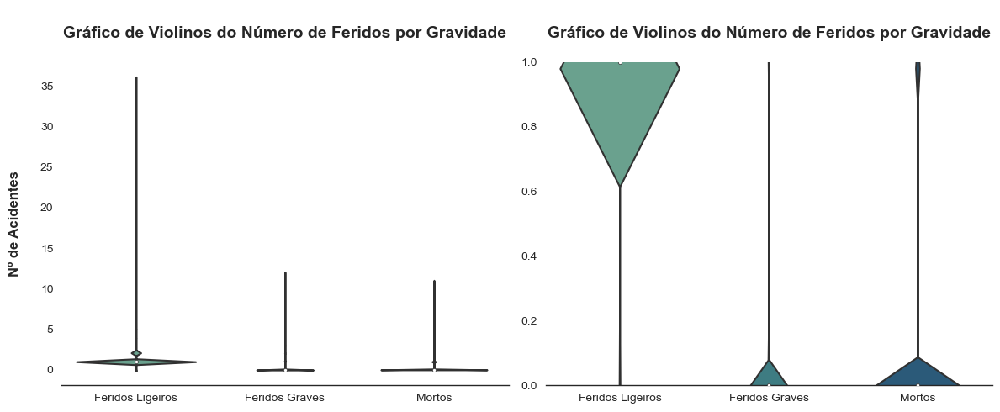

In [75]:
# Configuração do primeiro gráfico com limite no eixo y
plt.figure(figsize=(12, 5))

ax1 = plt.subplot(1, 2, 1)
ax1 = sns.violinplot(data=df_acidentes[['Num. Feridos ligeiros a 30 dias', 'Num. Feridos graves a 30 dias',
                                        'Num. Mortos a 30 dias']], palette='crest', jitter=0.2, size=2.5)
ax1.set_ylabel('Nº de Acidentes\n', fontweight='bold')
ax1.set_xticklabels(['Feridos Ligeiros', 'Feridos Graves', 'Mortos'])
plt.title("\nGráfico de Violinos do Número de Feridos por Gravidade\n", fontsize=14, fontweight='bold')
sns.despine(top=True, right=True, left=True)

# Configuração do segundo gráfico sem limite no eixo y
ax2 = plt.subplot(1, 2, 2)
ax2 = sns.violinplot(data=df_acidentes[['Num. Feridos ligeiros a 30 dias', 'Num. Feridos graves a 30 dias',
                                        'Num. Mortos a 30 dias']], palette='crest', jitter=0.2, size=2.5)
ax2.set_ylim(0, 1)
ax2.set_xticklabels(['Feridos Ligeiros', 'Feridos Graves', 'Mortos'])
plt.title("\nGráfico de Violinos do Número de Feridos por Gravidade\n", fontsize=14, fontweight='bold')
sns.despine(top=True, right=True, left=True)
plt.tight_layout()
plt.show()

In [76]:
# Cálculo do Nº de Feridos Envolvidos
df_acidentes['Total Feridos Envolvidos'] = df_acidentes['Num. Feridos ligeiros a 30 dias'] + df_acidentes['Num. Feridos graves a 30 dias'] + df_acidentes['Num. Mortos a 30 dias']
df_acidentes[['Num. Feridos ligeiros a 30 dias', 'Num. Feridos graves a 30 dias', 'Num. Mortos a 30 dias', 'Total Feridos Envolvidos']].describe()

,Num. Feridos ligeiros a 30 dias,Num. Feridos graves a 30 dias,Num. Mortos a 30 dias,Total Feridos Envolvidos
count,327384.000000,327384.000000,327384.000000,327384.000000
mean,1.214992,0.064340,0.021015,1.300348
std,0.753668,0.283124,0.157192,0.756063
min,0.000000,0.000000,0.000000,1.000000
25%,1.000000,0.000000,0.000000,1.000000
50%,1.000000,0.000000,0.000000,1.000000
75%,1.000000,0.000000,0.000000,1.000000
max,36.000000,12.000000,11.000000,51.000000


> Como os **Quantis $25$** e **$75$** coincidem, não podemos utilizar o critério da distância interquartílica pois daria $0$. 

> Assim, vamos verificar os outliers com o **`Indicador de Gravidade`** que dará uma perspetiva mais realista dos verdadeiros casos extremos.


In [77]:
# Função para calcular o Indicador de Gravidade (IG)
def calcular_indicador_gravidade(row):
    VM = row['Num. Mortos a 30 dias']
    FG = row['Num. Feridos graves a 30 dias']
    FL = row['Num. Feridos ligeiros a 30 dias']
    
    IG = 100 * VM + 10 * FG + 3 * FL
    return IG

# Aplicar a função para calcular o Indicador de Gravidade (IG) ao DataFrame
df_acidentes['Indicador de Gravidade'] = df_acidentes.apply(calcular_indicador_gravidade, axis=1)
pd.DataFrame(df_acidentes['Indicador de Gravidade'].describe())

,Indicador de Gravidade
count,327384.000000
mean,6.389888
std,16.069294
min,3.000000
25%,3.000000
50%,3.000000
75%,6.000000
max,1283.000000


#### Boxplot `Indicador de Gravidade`

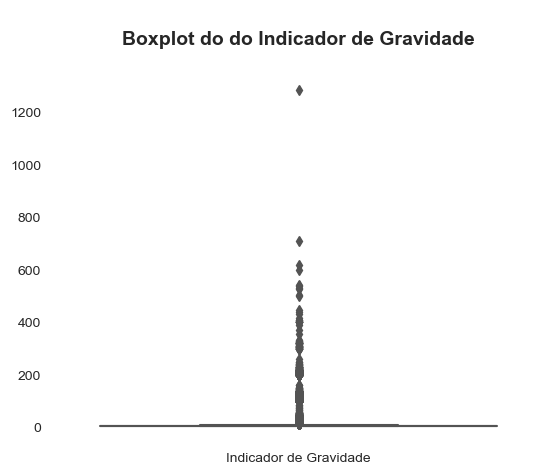

In [78]:
sns.boxplot(data=df_acidentes[['Indicador de Gravidade']])
plt.title("\nBoxplot do do Indicador de Gravidade\n", fontsize=14, fontweight='bold')
sns.despine(top=True, right=True, left=True, bottom=True)
plt.show()

In [79]:
# Fonte: Notebooks de PACDI
from collections import Counter

### Define function for outlier detection, based on IQR method
def detect_outliers(df,feature):
    outlier_indices = []
    # 1st quartile
    Q1 = np.percentile(df[feature],25)
    # 3rd quartile
    Q3 = np.percentile(df[feature],75)
    # IQR
    IQR = max(Q3 - Q1, 1)
    # Outlier step
    outlier_step = IQR * 1.5
    # detect outlier and their indeces
    outlier_list_col = df[((df[feature] < Q1 - outlier_step) | (df[feature] > Q3 + outlier_step))].index
    # store indeces
    outlier_indices.extend(outlier_list_col)
    return outlier_indices

In [80]:
# Verificar os valores 'outliers'
df_acidentes.loc[detect_outliers(df_acidentes,'Indicador de Gravidade')] \
            .sort_values(by='Indicador de Gravidade', ascending=False)

,Id. Acidente,Datahora,Dia,Mês,Hora,Velocidade local,Velocidade geral,Dia da Semana,Latitude GPS,Longitude GPS,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Características Tecnicas1,Cond Aderência,Distrito,Concelho,Freguesia,Nome arruamento,Tipos Vias,Cod Via,Estado Conservação,Factores Atmosféricos,Reg Circulação1,Intersecção Vias,Localizações,Luminosidade,Natureza,Traçado 1,Traçado 2,Traçado 3,Traçado 4,Ano,Hora_Int,Hora_Dia,Total Feridos Envolvidos,Indicador de Gravidade
99852,2013681685,2013-01-27 08:15:00,27,1,08:15,50,80,Domingo,NaN,NaN,11,12,21,Estrada sem separador,Molhado,Castelo Branco,Serta,Carvalhal,NaN,IC - Itinerário Complementar,IC8,Em estado regular,Chuva,Dois sentidos,Fora da intersecção,Fora das localidades,Em pleno dia,Despiste com transposição do dispositivo de retenção lateral,Curva,Com inclinação,Berma pavimentada,Em plena via,2013,8,Manhã (8-12),44,1283
115932,2014761428,2013-08-17 13:45:00,17,8,13:45,90,90,Sábado,37.350658,-8.155344,7,1,0,Estrada sem separador,Seco e limpo,Beja,Ourique,Ourique,NaN,IC - Itinerário Complementar,IC1,Em bom estado,Bom tempo,Dois sentidos,Fora da intersecção,Fora das localidades,Em pleno dia,Colisão frontal,Recta,Em patamar,Berma pavimentada,Em plena via,2013,13,Tarde (12-16),8,710
272246,20181448559,2018-06-21 06:54:00,21,6,06:54,90,90,Quinta-Feira,38.561951,-8.655877,6,2,0,Estrada sem separador,Molhado,Setúbal,Palmela,União das freguesias de Poceirão e Marateca,NaN,EN - Estrada Nacional,EN5,Em bom estado,Chuva,Sentido único,Fora da intersecção,Fora das localidades,Em pleno dia,Colisão frontal,Curva,Em patamar,Berma pavimentada,Em plena via,2018,6,Amanhecer (4-8),8,620
281683,20181542119,2018-09-24 07:00:00,24,9,07:00,100,100,Segunda-Feira,39.962911,-8.693991,6,0,0,Estrada sem separador,Seco e limpo,Leiria,Pombal,Almagreira,NaN,IC - Itinerário Complementar,IC8,Em bom estado,Nevoeiro,Sentido único,Fora da intersecção,Fora das localidades,Em pleno dia,Colisão frontal,Recta,Com inclinação,Berma pavimentada,Em plena via,2018,7,Amanhecer (4-8),6,600
168295,2015974342,2015-05-02 03:45:00,2,5,03:45,70,90,Sábado,40.079852,-8.284490,5,4,1,Estrada sem separador,Molhado,Coimbra,Coimbra,Cernache,NaN,IC - Itinerário Complementar,IC2,Em bom estado,Chuva,Dois sentidos,Fora da intersecção,Fora das localidades,"Noite, sem iluminação",Despiste simples,Curva,Com inclinação,Berma pavimentada,Na berma,2015,3,Madrugada (0-4),10,543
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34870,2011512208,2010-12-25 17:00:00,25,12,17:00,50,50,Sábado,NaN,NaN,0,0,4,NaN,Seco e limpo,Braga,Guimaraes,Vermil,R Conde Vermil,Arruamento,0,Em bom estado,Bom tempo,Dois sentidos,Fora da intersecção,Dentro das localidades,Em pleno dia,Colisão frontal,Curva,Em patamar,Sem berma ou impraticável,Em plena via,2010,17,Anoitecer (16-20),4,12
185140,2015990433,2015-10-29 17:00:00,29,10,17:00,50,50,Quinta-Feira,41.568684,-8.422459,0,0,4,Estrada sem separador,Molhado,Braga,Braga,Braga (São Vicente),NaN,EN - Estrada Nacional,EN101,Em bom estado,Chuva,Dois sentidos,Fora da intersecção,Dentro das localidades,Em pleno dia,Colisão lateral com outro veículo em movimento,Curva,Com inclinação,Berma pavimentada,Em plena via,2015,17,Anoitecer (16-20),4,12
83615,2012632877,2012-07-18 18:45:00,18,7,18:45,50,90,Quarta-Feira,39.256620,-9.130220,0,0,4,Estrada sem separador,Seco e limpo,Leiria,Caldas da Rainha,Foz do Arelho,Estrada Das Roulotes,Arruamento,0,Em estado regular,Bom tempo,Dois sentidos,Fora da intersecção,Dentro das localidades,Em pleno dia,Colisão frontal,Curva,Em patamar,Sem berma ou impraticável,Em plena via,2012,18,Anoitecer (16-20),4,12
185007,20161021070,2015-10-28 14:00:00,28,10,14:00,120,120,Quarta-Feira,38.358380,-9.048287,0,0,4,Auto-estrada,Seco e limpo,Setúbal,Seixal,Fernão Ferro,NaN,A - Auto-Estrada,A2,Em bom estado,Bom tempo,Sentido único,Fora da intersecção,Fora das localidad

In [81]:
# Função para determinar a 'Severidade' do acidente com base nas definições da ANSR
def determinar_severidade(row):
    if row['Num. Mortos a 30 dias'] > 0:
        return 'Fatal'
    elif row['Num. Feridos graves a 30 dias'] > 0:
        return 'Grave'
    elif row['Num. Feridos ligeiros a 30 dias'] > 0:
        return 'Ligeiro'
    else:
        return 'Sem Feridos'

# Aplicar a função para determinar a 'Severidade' ao DataFrame
df_acidentes['Severidade'] = df_acidentes.apply(determinar_severidade, axis=1)
df_acidentes[['Num. Mortos a 30 dias', 'Num. Feridos graves a 30 dias', 'Num. Feridos ligeiros a 30 dias', 'Severidade', 'Indicador de Gravidade']]

,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Severidade,Indicador de Gravidade
0,0,0,1,Ligeiro,3
1,0,0,1,Ligeiro,3
2,0,0,1,Ligeiro,3
3,0,0,1,Ligeiro,3
4,0,0,3,Ligeiro,9
...,...,...,...,...,...
327379,0,0,1,Ligeiro,3
327380,0,0,1,Ligeiro,3
327381,0,0,1,Ligeiro,3
327382,0,0,1,Ligeiro,3


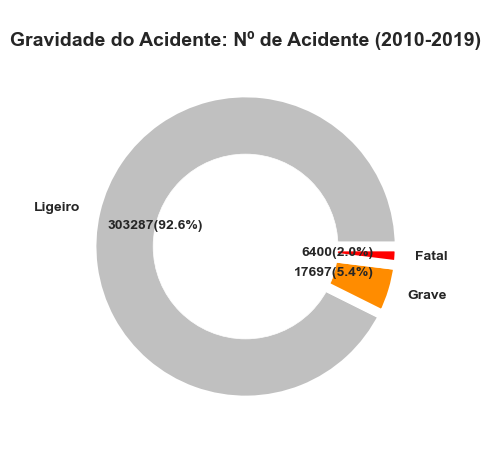

In [82]:
# Gráfico de Pizza 
plt.pie(x=df_acidentes['Severidade'].value_counts(), labels=df_acidentes['Severidade'].value_counts().index, 
        colors=['silver', 'darkorange','red'],
        pctdistance=0.6, textprops=dict(fontweight='bold'), 
        wedgeprops={'linewidth': 7, 'edgecolor': 'white'},
        autopct=lambda x: '{:.0f}({:.1%})'.format(x*len(df_acidentes)/100, x/100))

plot = plt.Circle((0, 0), 0.6, color='white')
fig = plt.gcf()
fig.set_size_inches(5, 5)
fig.gca().add_artist(plot)
plt.title('\nGravidade do Acidente: Nº de Acidente (2010-2019)', fontsize=14, fontweight='bold')
# plt.savefig("Gráficos/5_Gravidade do Acidente_Nº de Acidente (2010-2019).svg",format='svg',dpi=1200)
plt.show()

### **`Lesões a 30 dias`** do Condutor

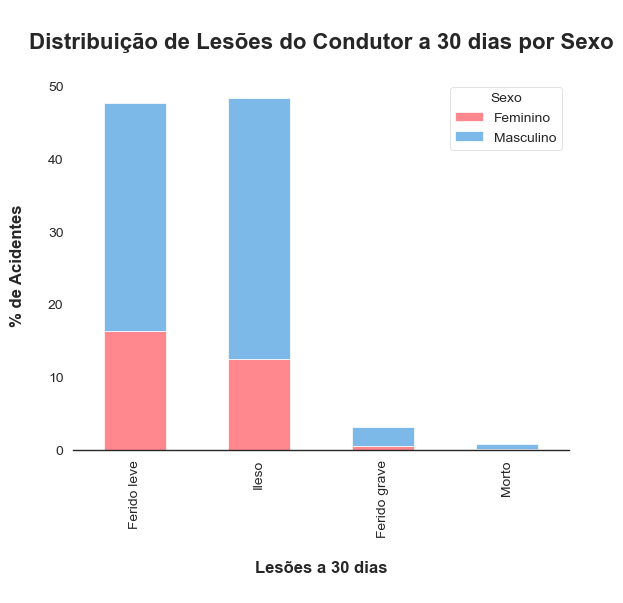

In [83]:
# Gráfico de Pilha: Comparação de Distribuição de Lesões a 30 dias por Sexo
lesoes_por_sexo = pd.crosstab(df_cond_veic['Lesões a 30 dias'], df_cond_veic['Sexo'], normalize=True) * 100
ax = lesoes_por_sexo.sort_values(by=['Feminino', 'Masculino'], ascending=False) \
                    .plot(kind='bar', stacked=True, color = ["#ff878d", "#7cb9e8"])

ax.set_title('\nDistribuição de Lesões do Condutor a 30 dias por Sexo\n', fontweight='bold', fontsize=16)
ax.set_xlabel('\nLesões a 30 dias\n', fontweight='bold')
ax.set_ylabel('% de Acidentes\n', fontweight='bold')
sns.despine(top=True, right=True, left=True)
# plt.savefig("Gráficos/Anexo C_Distribuição de Lesões do Condutor a 30 dias por Sexo.svg",format='svg',dpi=1200)
plt.show();

---

### Medidas Descritivas das Variáveis Númericas

In [84]:
# Função para calcular as estatísticas descritivas para todas as variáveis numéricas
# Mínimo; Máximo; Percentis; Amplitudes; Média; Desvio padrão; Coeficiente de variação; Assimetria (Skewness), Achatamento (Kurtosis)
def calcular_estatisticas_descritivas_para_todas(df):
    estatisticas = pd.DataFrame()

    for coluna in df.columns:
        nome_variavel = f"{coluna}"
        estatisticas[nome_variavel] = [
            df[coluna].min(),
            df[coluna].max(),
            np.percentile(df[coluna].dropna().values, 25),
            np.percentile(df[coluna].dropna().values, 50),
            np.percentile(df[coluna].dropna().values, 75),
            df[coluna].max() - df[coluna].min(),
            df[coluna].mean(),
            df[coluna].std(),
            (df[coluna].std() / df[coluna].mean()) * 100,
            df[coluna].skew(),
            df[coluna].kurtosis()
        ]
    estatisticas.index = ['Mínimo','Máximo','Percentil 25','Percentil 50 (Mediana)','Percentil 75','Amplitude','Média',
                          'Desvio Padrão','Coeficiente de Variação','Assimetria (Skewness)','Achatamento (Kurtosis)']
    return estatisticas

In [85]:
print("Estatísticas descritivas para df_acidentes:")
calcular_estatisticas_descritivas_para_todas(df_acidentes[['Id. Acidente','Dia', 'Mês', 'Ano', 'Hora_Int', 'Velocidade local', 'Velocidade geral',
                                                          'Latitude GPS', 'Longitude GPS', 'Num. Mortos a 30 dias','Num. Feridos graves a 30 dias', 
                                                          'Num. Feridos ligeiros a 30 dias','Total Feridos Envolvidos', 'Indicador de Gravidade']])

Estatísticas descritivas para df_acidentes:


,Id. Acidente,Dia,Mês,Ano,Hora_Int,Velocidade local,Velocidade geral,Latitude GPS,Longitude GPS,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Total Feridos Envolvidos,Indicador de Gravidade
Mínimo,2.010421e+09,1.000000,1.000000,2010.000000,0.000000,0.000000,0.000000,37.001771,-9.943630,0.000000,0.000000,0.000000,1.000000,3.000000
Máximo,2.020187e+10,31.000000,12.000000,2019.000000,23.000000,120.000000,120.000000,42.962314,-6.084620,11.000000,12.000000,36.000000,51.000000,1283.000000
Percentil 25,2.012624e+09,8.000000,4.000000,2012.000000,10.000000,50.000000,50.000000,38.748187,-9.010340,0.000000,0.000000,1.000000,1.000000,3.000000
Percentil 50 (Mediana),2.015932e+09,16.000000,7.000000,2015.000000,14.000000,50.000000,50.000000,40.039225,-8.532928,0.000000,0.000000,1.000000,1.000000,3.000000
Percentil 75,2.017130e+10,23.000000,10.000000,2017.000000,18.000000,50.000000,70.000000,41.160303,-8.246470,0.000000,0.000000,1.000000,1.000000,6.000000
Amplitude,1.819145e+10,30.000000,11.000000,9.000000,23.000000,120.000000,120.000000,5.960543,3.859010,11.000000,12.000000,36.000000,50.000000,1280.000000
Média,1.008383e+10,15.648129,6.719950,2014.567709,13.677107,58.812551,61.315974,39.858447,-8.517135,0.021015,0.064340,1.214992,1.300348,6.389888
Desvio Padrão,9.025430e+09,8.764839,3.411302,2.932439,5.296134,19.278435,21.206940,1.314779,0.553153,0.157192,0.283124,0.753668,0.756063,16.069294
Coeficiente de Variação,8.950396e+01,56.012056,50.763803,0.145562,38.722618,32.779458,34.586322,3.298620,-6.494596,747.996460,440.040946,62.030716,58.143109,251.480064
Assimetria (Skewness),2.240829e-01,0.027958,-0.098517,-0.047984,-0.444899,1.822580,1.525512,-0.320603,0.670745,10.046495,5.951548,4.526885,6.597781,10.358637


In [86]:
print("Estatísticas descritivas para df_cond_veic:")
calcular_estatisticas_descritivas_para_todas(df_cond_veic[['Ano matricula']])

Estatísticas descritivas para df_cond_veic:


,Ano matricula
Mínimo,0.000000
Máximo,2019.000000
Percentil 25,1998.000000
Percentil 50 (Mediana),2003.000000
Percentil 75,2008.000000
Amplitude,2019.000000
Média,2001.507677
Desvio Padrão,53.289868
Coeficiente de Variação,2.662486
Assimetria (Skewness),-36.594848


---

### Série Temporal dos Acidentes pela `Datahora`

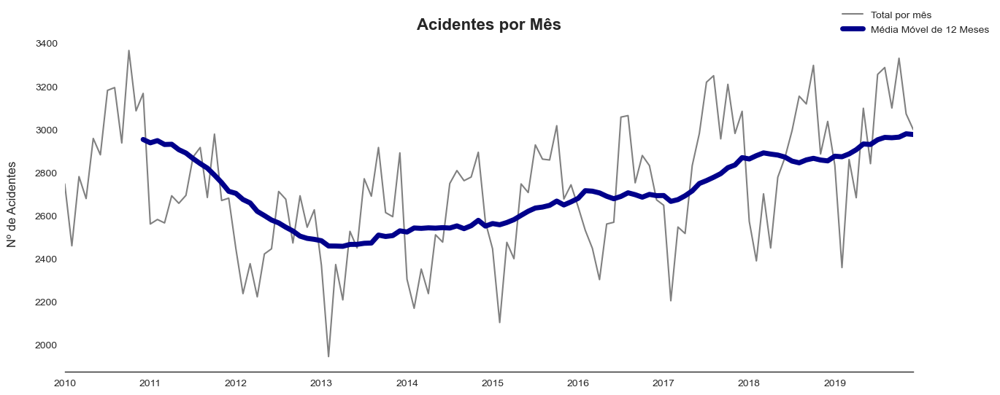

In [87]:
# Plotar a série temporal do número de acidentes por mês e da média móvel de 10 meses 
fig, ax = plt.subplots(figsize=(15,6))
df_acidentes.set_index('Datahora').resample('M').size().plot(label='Total por mês', color='grey', ax=ax)
df_acidentes.set_index('Datahora').resample('M').size().rolling(window=12).mean()\
                           .plot(color='darkblue', linewidth=5, label='Média Móvel de 12 Meses', ax=ax)
ax.set_title('Acidentes por Mês', fontsize=16, fontweight='bold')
ax.set(ylabel='Nº de Acidentes\n', xlabel='')
ax.legend(bbox_to_anchor=(1.1, 1.1), frameon=False)
sns.despine(ax=ax, top=True, right=True, left=True, bottom=False);

---

## 🛠️ Pré-Processamento

##  <a class='anchor' id='DP_1Obje'></a> 1º Objetivo | ⚡Radares

> Concluindo **AED** e a **Limpeza de dados**, procedeu-se a responder à primeira questão, que contemplava os radares, e portanto, restringiu-se às vitimas mortais que não envolvessem atropelamentos e que fossem no concelho **`Lisboa`**.

In [88]:
# Para a problemática dos Radares iremos filtrar os acidentes no Concelho de 'Lisboa' cuja 'Natureza' não foi "Atropelamento"
# e cujo 'Indicador de Gravidade' é de, pelo menos, 10
df_acidentes_radares = df_acidentes[
    (df_acidentes['Ano'] >= 2012) &
    (~df_acidentes['Natureza'].str.contains('Atropelamento')) &  
    ((df_acidentes['Concelho'] == 'Lisboa')) &
    ((df_acidentes['Indicador de Gravidade'] >= 10))
]

df_acidentes_radares.shape

(552, 38)

In [89]:
# Confirmar a filtração do dataset
df_acidentes_radares.sample(3)

,Id. Acidente,Datahora,Dia,Mês,Hora,Velocidade local,Velocidade geral,Dia da Semana,Latitude GPS,Longitude GPS,Num. Mortos a 30 dias,Num. Feridos graves a 30 dias,Num. Feridos ligeiros a 30 dias,Características Tecnicas1,Cond Aderência,Distrito,Concelho,Freguesia,Nome arruamento,Tipos Vias,Cod Via,Estado Conservação,Factores Atmosféricos,Reg Circulação1,Intersecção Vias,Localizações,Luminosidade,Natureza,Traçado 1,Traçado 2,Traçado 3,Traçado 4,Ano,Hora_Int,Hora_Dia,Total Feridos Envolvidos,Indicador de Gravidade,Severidade
242397,20171282680,2017-08-05 06:10:00,5,8,06:10,50,50,Sábado,38.740842,-9.149129,0,1,0,Outra via,Seco e limpo,Lisboa,Lisboa,Avenidas Novas,Avenida Berna,Arruamento,0,Em bom estado,Bom tempo,Sentido único,Fora da intersecção,Dentro das localidades,"Noite, com iluminação",Despiste sem dispositivo de retenção,Recta,Em patamar,Sem berma ou impraticável,Em plena via,2017,6,Amanhecer (4-8),1,10,Grave
84848,2012622643,2012-08-01 12:30:00,1,8,12:30,50,50,Quarta-Feira,38.774850,-9.105490,0,1,0,Outra via,Seco e limpo,Lisboa,Lisboa,Santa Maria dos Olivais,Túnel Praça José Queiroz,Arruamento,0,Em bom estado,Bom tempo,Dois sentidos,Fora da intersecção,Dentro das localidades,Em pleno dia,Despiste com dispositivo de retenção,Curva,Em patamar,Sem berma ou impraticável,Em plena via,2012,12,Tarde (12-16),1,10,Grave
269380,20181411961,2018-05-21 07:20:00,21,5,07:20,50,50,Segunda-Feira,38.731782,-9.146108,0,1,0,Outra via,Seco e limpo,Lisboa,Lisboa,Avenidas Novas,Avenida Fontes Pereira De Melo,Arruamento,0,Em bom estado,Bom tempo,Sentido único,Em cruzamento,Dentro das localidades,Em pleno dia,Colisão lateral com outro veículo em movimento,Recta,Com inclinação,Berma pavimentada,Em plena via,2018,7,Amanhecer (4-8),1,10,Grave


In [90]:
# Lista dos anos únicos presentes no DataFrame
anos_unicos = df_acidentes_radares['Ano'].unique()

# Iterar sobre cada ano
for ano in anos_unicos:
    
    # Filtrar dados para o ano atual
    df_subset = df_acidentes_radares[df_acidentes_radares['Ano'] == ano]
    
    # Calcular o número de NAs para Latitude e Longitude
    na_count_latitude = df_subset['Latitude GPS'].isna().sum()
    na_count_longitude = df_subset['Longitude GPS'].isna().sum()
    
    # Imprimir resultados
    print(f'Ano: {ano}')
    print(f'  Número de NAs para Latitude: {na_count_latitude} de {len(df_subset)} observações')
    print(f'  Número de NAs para Longitude: {na_count_longitude} de {len(df_subset)} observações')
    print('---')

Ano: 2012
  Número de NAs para Latitude: 47 de 73 observações
  Número de NAs para Longitude: 47 de 73 observações
---
Ano: 2013
  Número de NAs para Latitude: 27 de 61 observações
  Número de NAs para Longitude: 27 de 61 observações
---
Ano: 2014
  Número de NAs para Latitude: 0 de 85 observações
  Número de NAs para Longitude: 0 de 85 observações
---
Ano: 2015
  Número de NAs para Latitude: 0 de 77 observações
  Número de NAs para Longitude: 1 de 77 observações
---
Ano: 2016
  Número de NAs para Latitude: 0 de 49 observações
  Número de NAs para Longitude: 0 de 49 observações
---
Ano: 2017
  Número de NAs para Latitude: 0 de 68 observações
  Número de NAs para Longitude: 0 de 68 observações
---
Ano: 2018
  Número de NAs para Latitude: 8 de 73 observações
  Número de NAs para Longitude: 8 de 73 observações
---
Ano: 2019
  Número de NAs para Latitude: 43 de 66 observações
  Número de NAs para Longitude: 43 de 66 observações
---


In [91]:
# Imputar os NAs da 'Latitude GPS' e 'Longitude GPS' com o KNN
# Variáveis a utilizar: 'Velocidade local', 'Velocidade geral', 'Distrito', 'Concelho', 'Freguesia',
#                       'Nome arruamento', 'Tipos Vias', 'Cod Via', 'Estado Conservação', 'Reg Circulação1', 
#                       'Intersecção Vias','Traçado 1', 'Traçado 2', 'Traçado 3', 'Traçado 4', 'Localizações'
# Selecionar as variáveis para imputação
colunas_imputacao = ['Velocidade local', 'Velocidade geral', 'Distrito', 'Concelho', 'Freguesia',
                     'Nome arruamento', 'Tipos Vias', 'Cod Via', 'Estado Conservação', 
                     'Reg Circulação1', 'Intersecção Vias', 'Traçado 1', 'Traçado 2', 
                     'Traçado 3', 'Traçado 4', 'Localizações']

# Criar um DataFrame com as variáveis de imputação
df_acidentes_radares_KNN = df_acidentes_radares.copy(deep=True).reset_index()
df_imputacao = df_acidentes_radares_KNN[colunas_imputacao]

# Converter variáveis categóricas para numéricas usando Label Encoding
label_encoder = LabelEncoder()
for coluna in df_imputacao.select_dtypes(include='object').columns:
    df_imputacao[coluna] = label_encoder.fit_transform(df_imputacao[coluna].astype(str))

# Adicionar 'Latitude GPS' e 'Longitude GPS' ao DataFrame de imputação
df_imputacao['Latitude GPS'] = df_acidentes_radares_KNN['Latitude GPS']
df_imputacao['Longitude GPS'] = df_acidentes_radares_KNN['Longitude GPS']

# Criar um imputador KNN com k=√538≈23.2
knn_imputer = KNNImputer(n_neighbors=23)

# Imputar os valores ausentes
df_imputado = knn_imputer.fit_transform(df_imputacao)

# Criar um novo DataFrame com os valores imputados
df_imputado = pd.DataFrame(df_imputado, columns=df_imputacao.columns)
df_imputado

,Velocidade local,Velocidade geral,Distrito,Concelho,Freguesia,Nome arruamento,Tipos Vias,Cod Via,Estado Conservação,Reg Circulação1,Intersecção Vias,Traçado 1,Traçado 2,Traçado 3,Traçado 4,Localizações,Latitude GPS,Longitude GPS
0,50.0,50.0,0.0,0.0,27.0,55.0,1.0,0.0,0.0,0.0,1.0,1.0,2.0,1.0,1.0,0.0,38.747104,-9.120952
1,50.0,50.0,0.0,0.0,36.0,59.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,38.750954,-9.126990
2,70.0,120.0,0.0,0.0,1.0,215.0,6.0,8.0,0.0,0.0,7.0,1.0,2.0,2.0,1.0,0.0,38.686803,-9.176504
3,50.0,50.0,0.0,0.0,1.0,94.0,1.0,0.0,1.0,0.0,7.0,1.0,2.0,1.0,1.0,0.0,38.729333,-9.169307
4,50.0,50.0,0.0,0.0,34.0,44.0,1.0,0.0,1.0,0.0,7.0,1.0,2.0,1.0,1.0,0.0,38.755025,-9.117437
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
547,50.0,50.0,0.0,0.0,34.0,57.0,1.0,0.0,1.0,2.0,7.0,1.0,2.0,1.0,1.0,0.0,38.757129,-9.103284
548,50.0,50.0,0.0,0.0,27.0,57.0,1.0,0.0,1.0,2.0,7.0,1.0,2.0,2.0,1.0,0.0,38.719386,-9.116363
549,40.0,50.0,0.0,0.0,11.0,111.0,1.0,0.0,1.0,0.0,1.0,0.0,2.0,2.0,1.0,0.0,38.723101,-9.195745
550,50.0,50.0,0.0,0.0,8.0,125.0,1.0,0.0,1.0,2.0,7.0,0.0,2.0,1.0,1.0,0.0,38.737855,-9.156704


In [92]:
# Atualizar o DataFrame original com os valores imputados
df_acidentes_radares_KNN['Latitude GPS'] = df_imputado['Latitude GPS']
df_acidentes_radares_KNN['Longitude GPS'] = df_imputado['Longitude GPS']

df_acidentes_radares_KNN.shape

(552, 39)

In [93]:
# Eliminar observações sem a informação da latitude e da longitude
df_acidentes_radares_NA_remove = df_acidentes_radares.dropna(subset=['Latitude GPS', 'Longitude GPS'])
df_acidentes_radares_NA_remove.shape

(426, 38)

---

# <a class='anchor' id='DP_2Obje'></a> 2º Objetivo | 📅 Tendências

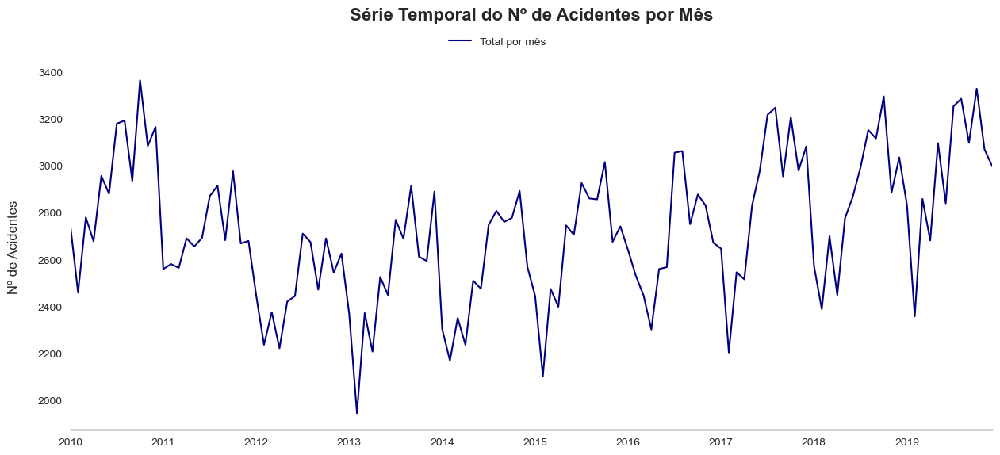

In [94]:
# Plotar a série temporal
fig, ax1 = plt.subplots(figsize=(15,6))

# Plotar a série temporal do 'Nº de Acidentes por Mês'
df_acidentes.set_index('Datahora').resample('M').size().plot(label='Total por mês', color='navy', ax=ax1)
ax1.set_title('Série Temporal do Nº de Acidentes por Mês\n\n', fontsize=16, fontweight='bold')
ax1.set(ylabel='Nº de Acidentes\n', xlabel='')

# # Adicionar 'Nº de vítimas mortais'
# ax2 = ax1.twinx()
# df_acidentes.set_index('Datahora').resample('M')['Num. Mortos a 30 dias'].sum().plot(label='Nº de Mortos', color='red', linewidth=2, alpha=0.4, ax=ax2)
# ax2.set(ylabel='Nº de Vítimas Mortais')

# # Adicionar 'Nº de Feridos Graves'
# ax3 = ax1.twinx()
# df_acidentes.set_index('Datahora').resample('M')['Num. Feridos graves a 30 dias'].sum().plot(label='Nº de Feridos Graves', color='orange', linewidth=2, ax=ax3)
# ax3.set(ylabel='Nº de Feridos Graves')

# Adicionar legenda
ax1.legend(bbox_to_anchor=(0.4, 1.1), loc='upper left', frameon=False)
# ax2.legend(bbox_to_anchor=(0.5, 1.1), loc='upper right', frameon=False)
# ax3.legend(bbox_to_anchor=(0.5, 1.1), loc='upper right', frameon=False)

# Remover eixos desnecessários
sns.despine(ax=ax1, top=True, right=True, left=True, bottom=False)
# sns.despine(ax=ax2, top=True, right=True, left=True, bottom=False)
# fig.savefig("Gráficos/6_Série Temporal do Número de Acidentes por Mês (Simples).svg",format='svg',dpi=1200)

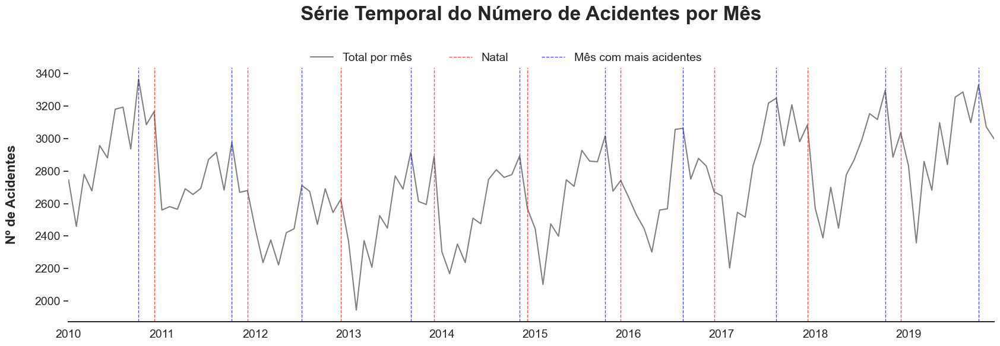

In [156]:
# Plotar a série temporal
fig, ax1 = plt.subplots(figsize=(17,6))
ax2 = ax1.twinx()
ax3 = ax2.twinx()

# Plotar a série temporal do 'Nº de Acidentes por Mês'
df_acidentes.set_index('Datahora').resample('M').size().plot(label='Total por mês', color='grey', ax=ax1)
ax1.set_title('Série Temporal do Número de Acidentes por Mês\n\n', fontsize=24, fontweight='bold')
ax1.set_ylabel('Nº de Acidentes\n', fontweight='bold', fontsize=16)
ax1.set_xlabel('')
# # Adicionar O 'Nº de vítimas mortais'
# df_acidentes.set_index('Datahora').resample('M')['Num. Mortos a 30 dias'].sum().plot(label='Nº de Mortos', color='red', linewidth=2, ax=ax2)
# ax2.set(ylabel='Nº de Vítimas Mortais')

# Adicionar legenda
ax1.legend(bbox_to_anchor=(0.25, 1.1), loc='upper left', frameon=False, fontsize=14)
# ax2.legend(bbox_to_anchor=(0.7, 1.1), loc='upper right', frameon=False)

# Remover eixos desnecessários
sns.despine(ax=ax1, top=True, right=True, left=True, bottom=False)
# sns.despine(ax=ax2, top=True, right=True, left=True, bottom=False)

# Adicionar linhas verticais para destacar meses específicos 
# -------------------------------------- Natal ----------------------------------------
meses_destacados = pd.date_range(start=f'{2010}-12-01', end=f'{2019}-12-01', freq='12M')
for mes_destacado in meses_destacados:
    ax1.axvline(pd.Timestamp(mes_destacado), color='red', linestyle='--', linewidth=1, alpha=0.7)
    # ax2.axvline(pd.Timestamp(mes_destacado), color='red', linestyle='--', linewidth=1, alpha=0.7)

# -------------------------------- Mais Acidentes --------------------------------
# Encontrar o mês com o maior número de acidentes para cada ano
meses_destacados_2 = df_acidentes.groupby(['Ano', 'Mês'])['Id. Acidente'].count().reset_index().rename(columns={'Id. Acidente': 'Nº de Acidentes'})

# Normalizar pelo número de dias em cada mês
meses_destacados_2['Nº Acidentes por Dia'] = meses_destacados_2['Nº de Acidentes'] / pd.to_datetime(df_acidentes['Ano'].astype(str) + '-' + df_acidentes['Mês'].astype(str) + '-1').dt.days_in_month

# Encontrar o índice do máximo para cada ano
indices_maximos = meses_destacados_2.groupby('Ano')['Nº Acidentes por Dia'].idxmax()

# Obter as datas correspondentes aos índices calculados
meses_destacados_2 = meses_destacados_2.loc[indices_maximos, ['Ano', 'Mês', 'Nº de Acidentes', 'Nº Acidentes por Dia']]

# Criar a lista de meses para destacar
meses_destacados_list = meses_destacados_2.apply(lambda x: pd.Timestamp(f'{int(x["Ano"])}-{int(x["Mês"])}-01'), axis=1).dt.strftime('%Y-%m-%d').tolist()
for mes_destacado in meses_destacados_list:
    ax1.axvline(pd.Timestamp(mes_destacado), color='blue', linestyle='--', linewidth=1, alpha=0.7)
    # ax2.axvline(pd.Timestamp(mes_destacado), color='blue', linestyle='--', linewidth=1, alpha=0.7) 

# Adicionar linhas adicionais apenas para a legenda
ax2.axvline(0, color='red', linestyle='--', linewidth=1, alpha=0.7, label='Natal')
ax3.axvline(0, color='blue', linestyle='--', linewidth=1, alpha=0.7, label='Mês com mais acidentes')
ax2.set_yticks([])
ax3.set_yticks([])
ax2.legend(bbox_to_anchor=(0.4, 1.1), loc='upper left', frameon=False, fontsize=14)
ax3.legend(bbox_to_anchor=(0.5, 1.1), loc='upper left', frameon=False, fontsize=14)
ax1.tick_params(axis='x', labelsize=14)
ax1.tick_params(axis='y', labelsize=14)
sns.despine(top=True, right=True, left=True, bottom=False)
plt.tight_layout()
# plt.savefig("Gráficos/PPT_6_Série Temporal do Número de Acidentes por Mês.svg",format='svg',dpi=1200)
plt.show();

> Marcando as linhas verticais nos meses de <b style='color: red;'>Natal</b> e nos que tiveram <b style='color:blue;'>+ Acidentes</b>.

In [96]:
# Meses do Ano com mais acidentes
nomes_meses = {1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho', 7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'}
meses_destacados_2['Mês'] = meses_destacados_2['Mês'].map(nomes_meses)
meses_destacados_2.loc[indices_maximos, ['Ano', 'Mês','Nº de Acidentes', 'Nº Acidentes por Dia']].round(0).set_index('Ano')

,Mês,Nº de Acidentes,Nº Acidentes por Dia
Ano,,,
2010,Outubro,3365,109.0
2011,Outubro,2977,96.0
2012,Julho,2711,87.0
2013,Setembro,2915,94.0
2014,Novembro,2893,93.0
2015,Outubro,3016,97.0
2016,Agosto,3063,99.0
2017,Agosto,3248,105.0
2018,Outubro,3296,106.0


> Devido à tendência em termos de meses com mais acidentes ser **outubro**, que não teve nenhuma campanha associada, pretende-se estudar as tendências existentes nos acidentes de forma a poder descobrir mais sobre as mesmas, sendo assim este, o **2º Objetivo**.

---

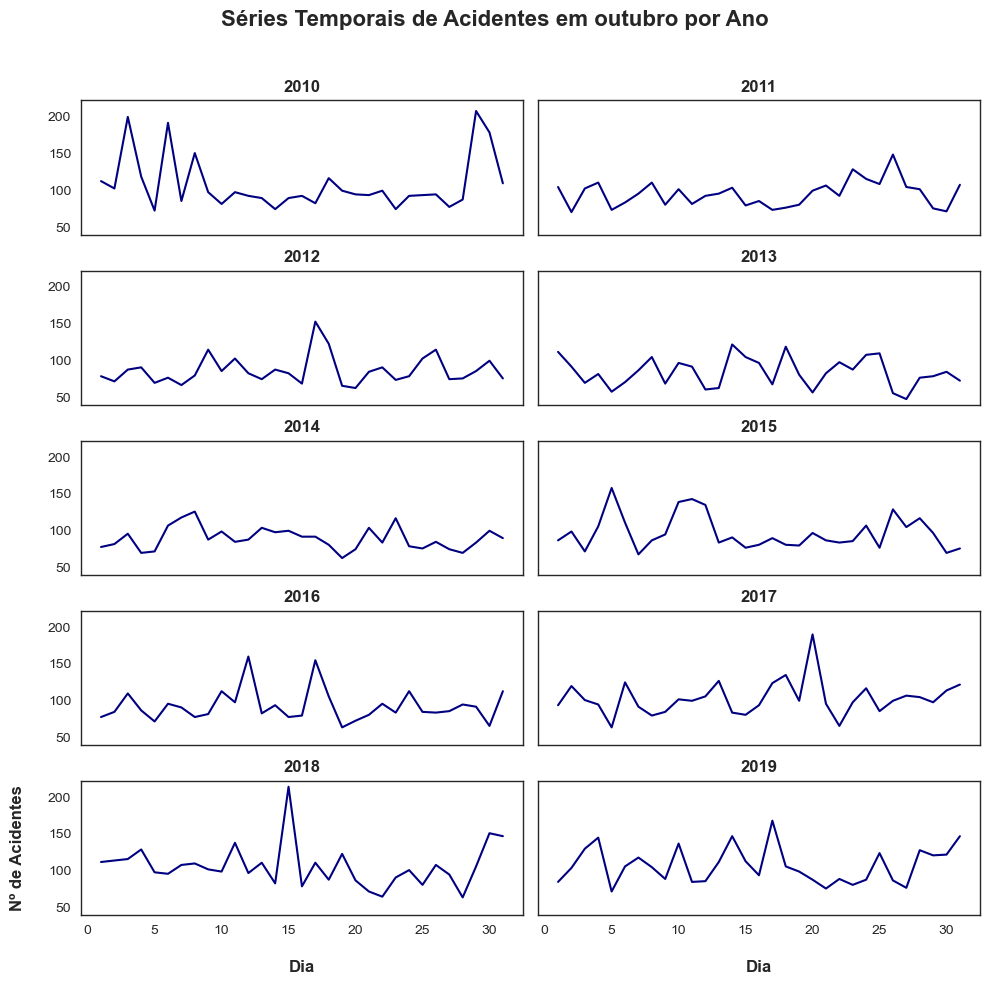

In [97]:
# Filtrar os dados apenas para o mês de outubro
dados_outubro = df_acidentes[df_acidentes['Mês'] == 10]
anos_unicos = dados_outubro['Ano'].unique()

# Configurar o número de subplots
num_subplots = len(anos_unicos)
num_rows = (len(anos_unicos) + 2 - 1) // 2

# Criar subplots
fig, axs = plt.subplots(num_rows, 2, figsize=(10, 10), sharex=True, sharey=True)
fig.suptitle('Séries Temporais de Acidentes em outubro por Ano', fontweight='bold',  fontsize=16)

# Iterar sobre os anos e criar gráficos
for i, ano in enumerate(anos_unicos):
    
    # Filtrar os dados para o ano específico
    dados_ano = dados_outubro[dados_outubro['Ano'] == ano]
    
    # Contar o número de acidentes por IDs diferentes
    contagem_acidentes_por_id = dados_ano.groupby('Id. Acidente').size()
    
    # Criar uma série temporal para o mês de outubro
    serie_temporal = pd.Series(dados_ano.groupby('Dia')['Id. Acidente'].nunique(), name=f'{nomes_meses[10]} de {ano}')
    
    # Série Temporal
    row = i // 2
    col = i % 2
    axs[row, col].plot(serie_temporal, label=f'{ano}', color='navy')
    axs[row, col].set_title(f'{ano}', fontsize=12, fontweight='bold')
    
    # Rótulos do eixo x e y
    if row == num_rows - 1:  # Colocar 'xlab' na última linha
        if col == 0:
            axs[row, col].set_xlabel('\nDia', fontweight='bold')
            axs[row, col].set_ylabel('Nº de Acidentes\n', fontweight='bold')
        else:
            axs[row, col].set_xlabel('\nDia', fontweight='bold')

# Ajustar layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
# fig.savefig("Gráficos/7_Séries Temporais de Acidentes em outubro por Ano.svg",format='svg',dpi=1200)
plt.show();

---

# <a class='anchor' id='3'></a>
<br>
<style>
@import url('https://fonts.cdnfonts.com/css/avenir-next-lt-pro?styles=29974');
</style>

<div style="background: linear-gradient(to right,#95B6DF, #222E65); 
            padding: 10px; color: white; border-radius: 300px; text-align: center;">
    <center><h1 style="margin-left: 120px;margin-top: 10px; margin-bottom: 4px; color: white;
                       font-size: 34px; font-family: 'Avenir Next LT Pro', sans-serif;"><b>3 | Modeling</b></h1></center>
</div>

# <a class='anchor' id='M_1Obje'></a> 1º Objetivo | ⚡Radares

### Etapas:

- Dividir a análise entre 2012 a 2015 e 2016 e 2019
- Presença de radares no raio de $500m$
---
- Clusterização dos pontos negros 
- Análise dos locais mais prepoderantes para a colocação de novos radares

#### Dividir a Análise entre 2012 a 2015 e 2016 a 2019:

In [98]:
# Filtrar dados para os períodos desejados
df_acidentes_radares_NA_remove_2012_2015 = df_acidentes_radares_NA_remove[(df_acidentes_radares_NA_remove['Ano'] >= 2012) & (df_acidentes_radares_NA_remove['Ano'] <= 2015)]
df_acidentes_radares_NA_remove_2016_2019 = df_acidentes_radares_NA_remove[(df_acidentes_radares_NA_remove['Ano'] >= 2016) & (df_acidentes_radares_NA_remove['Ano'] <= 2019)]

df_acidentes_radares_KNN_2012_2015 = df_acidentes_radares_KNN[(df_acidentes_radares_KNN['Ano'] >= 2012) & (df_acidentes_radares_KNN['Ano'] <= 2015)]
df_acidentes_radares_KNN_2016_2019 = df_acidentes_radares_KNN[(df_acidentes_radares_KNN['Ano'] >= 2016) & (df_acidentes_radares_KNN['Ano'] <= 2019)]

In [99]:
# Fonte: https://pt-pt.topographic-map.com/map-1zv3q/Lisboa/?center=39.15392%2C-6.58896&zoom=7
# Considerando as coordenadas de Lisboa entre:
#    Lisboa, 1100-148
#    Portugal (38.68775 -9.29659 | 38.80775 -8.97659)

lisboa_lat_range = (38.68775, 38.80775)
lisboa_lon_range = (-9.29659, -8.97659)

# Filtrar os 'Radares de Portugal' para o Concelho de Lisboa
radares_Portugal_Lisboa = radares_Portugal[
    (radares_Portugal['Latitude'] >= lisboa_lat_range[0]) & (radares_Portugal['Latitude'] <= lisboa_lat_range[1]) &
    (radares_Portugal['Longitude'] >= lisboa_lon_range[0]) & (radares_Portugal['Longitude'] <= lisboa_lon_range[1])
]

# Restringir a 'Lisboa' [NOTA: Na base de dados o 'Concelho' representa o Distrito onde o radar está colocado]
radares_ANSR_lisboa = radares_ANSR[radares_ANSR['Freguesia'] == 'Lisboa']

print('Nº de Radares em Lisboa segundo os "Radares de Portugal":', len(radares_Portugal_Lisboa))
print('Nº de Radares em Lisboa segundo a "ANSR":', len(radares_ANSR_lisboa))

Nº de Radares em Lisboa segundo os "Radares de Portugal": 65
Nº de Radares em Lisboa segundo a "ANSR": 8


#### Presença de Radares no Raio de 500m:

In [100]:
# pip install geopy

In [101]:
from geopy.distance import geodesic

# Função para verificar a presença de radares próximos
def verifica_presenca_radares(coord_acidente, radares, limite_distancia=200):
    return any(geodesic(coord_acidente,                                 # Coordenadas do Acidente
                        (radar['Latitude'], radar['Longitude'])         # Coordenadas do Radar
                       ).meters <= limite_distancia for _, radar in radares.iterrows())

# Aplicar a função para os dois períodos a ambas as bases de dados dos radares 
print('Com a base de dados do website \033[1mANSR\033[0m:')
df_acidentes_radares_NA_remove_2012_2015['Presenca_Radares'] = df_acidentes_radares_NA_remove_2012_2015.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_ANSR_lisboa), axis=1)
df_acidentes_radares_NA_remove_2016_2019['Presenca_Radares'] = df_acidentes_radares_NA_remove_2016_2019.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_ANSR_lisboa), axis=1)

df_acidentes_radares_KNN_2012_2015['Presenca_Radares'] = df_acidentes_radares_KNN_2012_2015.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_ANSR_lisboa), axis=1)
df_acidentes_radares_KNN_2016_2019['Presenca_Radares'] = df_acidentes_radares_KNN_2016_2019.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_ANSR_lisboa), axis=1)

print(f'Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (removendo NAs): {len(df_acidentes_radares_NA_remove_2012_2015[df_acidentes_radares_NA_remove_2012_2015["Presenca_Radares"] == True])}/{len(df_acidentes_radares_NA_remove_2012_2015)} ({round(len(df_acidentes_radares_NA_remove_2012_2015[df_acidentes_radares_NA_remove_2012_2015["Presenca_Radares"] == True])/len(df_acidentes_radares_NA_remove_2012_2015)*100, 2)}%)')
print(f'Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (removendo NAs): {len(df_acidentes_radares_NA_remove_2016_2019[df_acidentes_radares_NA_remove_2016_2019["Presenca_Radares"] == True])}/{len(df_acidentes_radares_NA_remove_2016_2019)} ({round(len(df_acidentes_radares_NA_remove_2016_2019[df_acidentes_radares_NA_remove_2016_2019["Presenca_Radares"] == True])/len(df_acidentes_radares_NA_remove_2016_2019)*100, 2)}%)\n')

print(f'Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (c/ Imputação KNN): {len(df_acidentes_radares_KNN_2012_2015[df_acidentes_radares_KNN_2012_2015["Presenca_Radares"] == True])}/{len(df_acidentes_radares_KNN_2012_2015)} ({round(len(df_acidentes_radares_KNN_2012_2015[df_acidentes_radares_KNN_2012_2015["Presenca_Radares"] == True])/len(df_acidentes_radares_KNN_2012_2015)*100, 2)}%)')
print(f'Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (c/ Imputação KNN): {len(df_acidentes_radares_KNN_2016_2019[df_acidentes_radares_KNN_2016_2019["Presenca_Radares"] == True])}/{len(df_acidentes_radares_KNN_2016_2019)} ({round(len(df_acidentes_radares_KNN_2016_2019[df_acidentes_radares_KNN_2016_2019["Presenca_Radares"] == True])/len(df_acidentes_radares_KNN_2016_2019)*100, 2)}%)')


print('\n\n\nCom a base de dados do website \033[1mRadares de Portugal\033[0m:')
df_acidentes_radares_NA_remove_2012_2015['Presenca_Radares'] = df_acidentes_radares_NA_remove_2012_2015.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_Portugal_Lisboa), axis=1)
df_acidentes_radares_NA_remove_2016_2019['Presenca_Radares'] = df_acidentes_radares_NA_remove_2016_2019.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_Portugal_Lisboa), axis=1)

df_acidentes_radares_KNN_2012_2015['Presenca_Radares'] = df_acidentes_radares_KNN_2012_2015.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_Portugal_Lisboa), axis=1)
df_acidentes_radares_KNN_2016_2019['Presenca_Radares'] = df_acidentes_radares_KNN_2016_2019.apply(lambda row: verifica_presenca_radares((row['Latitude GPS'], row['Longitude GPS']), radares_Portugal_Lisboa), axis=1)

print(f'Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (removendo NAs): {len(df_acidentes_radares_NA_remove_2012_2015[df_acidentes_radares_NA_remove_2012_2015["Presenca_Radares"] == True])}/{len(df_acidentes_radares_NA_remove_2012_2015)} ({round(len(df_acidentes_radares_NA_remove_2012_2015[df_acidentes_radares_NA_remove_2012_2015["Presenca_Radares"] == True])/len(df_acidentes_radares_NA_remove_2012_2015)*100, 2)}%)')
print(f'Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (removendo NAs): {len(df_acidentes_radares_NA_remove_2016_2019[df_acidentes_radares_NA_remove_2016_2019["Presenca_Radares"] == True])}/{len(df_acidentes_radares_NA_remove_2016_2019)} ({round(len(df_acidentes_radares_NA_remove_2016_2019[df_acidentes_radares_NA_remove_2016_2019["Presenca_Radares"] == True])/len(df_acidentes_radares_NA_remove_2016_2019)*100, 2)}%)\n')

print(f'Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (c/ Imputação KNN): {len(df_acidentes_radares_KNN_2012_2015[df_acidentes_radares_KNN_2012_2015["Presenca_Radares"] == True])}/{len(df_acidentes_radares_KNN_2012_2015)} ({round(len(df_acidentes_radares_KNN_2012_2015[df_acidentes_radares_KNN_2012_2015["Presenca_Radares"] == True])/len(df_acidentes_radares_KNN_2012_2015)*100, 2)}%)')
print(f'Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (c/ Imputação KNN): {len(df_acidentes_radares_KNN_2016_2019[df_acidentes_radares_KNN_2016_2019["Presenca_Radares"] == True])}/{len(df_acidentes_radares_KNN_2016_2019)} ({round(len(df_acidentes_radares_KNN_2016_2019[df_acidentes_radares_KNN_2016_2019["Presenca_Radares"] == True])/len(df_acidentes_radares_KNN_2016_2019)*100, 2)}%)')

Com a base de dados do website ANSR:
Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (removendo NAs): 9/221 (4.07%)
Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (removendo NAs): 6/205 (2.93%)

Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (c/ Imputação KNN): 9/296 (3.04%)
Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (c/ Imputação KNN): 7/256 (2.73%)



Com a base de dados do website Radares de Portugal:
Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (removendo NAs): 27/221 (12.22%)
Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (removendo NAs): 19/205 (9.27%)

Número de acidentes dentro do raio de 200m do radar entre 2012 a 2015 (c/ Imputação KNN): 33/296 (11.15%)
Número de acidentes dentro do raio de 200m do radar entre 2016 a 2019 (c/ Imputação KNN): 23/256 (8.98%)


---

In [102]:
# Contagem do Nº de Acidentes por Coordenada Geográfica
acidentes_counts = df_acidentes.groupby(['Latitude GPS', 'Longitude GPS']).size().reset_index(name='N')

# Criar uma lista de dados para o HeatMap
heat_data = []
for index, row in acidentes_counts.iterrows():
    heat_data.append([row['Latitude GPS'], row['Longitude GPS'], row['N']])
    
# Adicionar o HeatMap do 'Nº de Acidentes' ao mapa
# Fonte: https://github.com/python-visualization/folium/issues/1374
#        https://stackoverflow.com/questions/47163728/how-to-add-legend-gradient-in-folium-heat-map
steps=20
colormap = cm.LinearColormap(colors=['darkblue', 'blue', 'cyan', 'yellow', 'orange', 'red'],
                             caption='Nº de Acidentes',
                             ).scale(0, 1).to_step(steps)
gradient_map=defaultdict(dict)
for i in range(steps):
    gradient_map[1/steps*i] = colormap.rgb_hex_str(1/steps*i)

heatmap = HeatMap(data=heat_data,
                  name='Nº de Acidentes',
                  radius=17,
                  show= False,
                  control =True,
                  gradient = gradient_map
                  )

In [103]:
# Representação do Mapa

# Coordenadas centrais para o mapa
latitude_central = df_acidentes_radares_NA_remove_2012_2015['Latitude GPS'].mean()
longitude_central = df_acidentes_radares_NA_remove_2012_2015['Longitude GPS'].mean()

# Criar um Mapa
mapa = folium.Map(location=[latitude_central, longitude_central], zoom_start=12, control_scale=True)
basemaps['Google Maps'].add_to(mapa)
basemaps['Google Satellite'].add_to(mapa)
plugins.Fullscreen(position='topright').add_to(mapa)  # Opção de Fullscreen
mapa.add_child(plugins.MiniMap(toggle_display=True))  # Minimapa do lado direito
# plugins.Draw().add_to(mapa)                           # Opções de Desenhar
heatmap.add_to(mapa)                                  # HeatMap
# colormap.add_to(mapa)                               # Barra de Cor do HeatMap
mapa.add_child(folium.LayerControl())                 # Camadas de Diferentes Mapas
plugins.FloatImage(image = 'https://radaresavista.pt/wp-content/uploads/2023/01/logo-ANSR.svg', bottom=8, left=2, width='100px').add_to(mapa)        # Logo ANSR
# mapa.add_child(ClickForOneMarker())

# Mostrar o mapa
sw = df_acidentes_radares_NA_remove_2012_2015[['Latitude GPS', 'Longitude GPS']].min().values.tolist()
ne = df_acidentes_radares_NA_remove_2012_2015[['Latitude GPS', 'Longitude GPS']].max().values.tolist()

# Adicionar marcadores para os Acidente
for index, acidente in df_acidentes_radares_NA_remove_2012_2015.dropna().iterrows():
    # Criar a localização para o marcador
    location = [acidente["Latitude GPS"], acidente["Longitude GPS"]]
    
    acidente['Cluster'] = "Não Aplicável" # Apenas para questões de visualização do popup
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  popup=folium.Popup(generate_acidentes_popup(acidente), max_width=300),
                  icon=folium.Icon(color='red', icon='car', prefix='fa')).add_to(mapa)

# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR_lisboa.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
    # Adicione um círculo de 200m ao redor do radar
    folium.Circle(location, radius=200, color='lightblue', fill=True, fill_color='blue', fill_opacity=0.1).add_to(mapa)
    
for index, radar_ in radares_Portugal_Lisboa.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)
    
    # Adicione um círculo de 200m ao redor do radar
    folium.Circle(location, radius=200, color='lightgray', fill=True, fill_color='blue', fill_opacity=0.1).add_to(mapa)
    
mapa

> Desta forma, os resultados obtidos validam que a implementação de radares é eficaz na diminuição da incidência de acidentes rodoviários.

---

##  Clusterização dos Pontos Negros usando o `KMeans`:

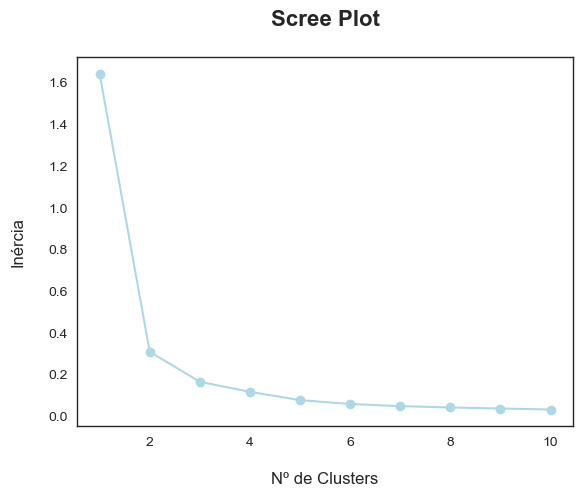

In [104]:
# Selecionar as colunas relevantes para o K-means
X = df_acidentes_radares_NA_remove_2016_2019[['Latitude GPS', 'Longitude GPS']]

# Variar o número de clusters de 1 a 10
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)           # inertia_: Sum of squared distances of samples to their closest cluster center

# Criar o Scree Plot
plt.plot(range(1, 11), inertia, marker='o', color='lightblue')
plt.title('Scree Plot\n', fontsize=16, fontweight='bold')
plt.xlabel('\nNº de Clusters')
plt.ylabel('Inércia\n')
plt.show()

> Sendo a **Inércia**, a *soma das distâncias quadradas das amostras ao centro do cluster mais próximo* [K-Means sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html), o cotovelo está entre $2$ e $3$.

In [105]:
# Selecionar as colunas relevantes para o K-means
df_cluster_kmeans = df_acidentes_radares_NA_remove_2016_2019.copy(deep=True)
df_cluster_kmeans = df_cluster_kmeans.loc[df_cluster_kmeans['Latitude GPS'] <= 39]

# K-means com k=3
kmeans = KMeans(n_clusters=3, random_state=42)

# Ajustar o modelo aos dados
kmeans.fit(df_cluster_kmeans[['Latitude GPS', 'Longitude GPS']])

# Adicionar as previsões de cluster de volta ao DataFrame
df_cluster_kmeans['Cluster'] = kmeans.labels_
df_cluster_kmeans[['Latitude GPS', 'Longitude GPS', 'Cluster']]

,Latitude GPS,Longitude GPS,Cluster
190913,38.741344,-9.204570,0
191238,38.726732,-9.155010,2
191838,38.709780,-9.136507,2
192066,38.704199,-9.173632,0
193715,38.738123,-9.136494,2
...,...,...,...
325854,38.757129,-9.103284,1
325870,38.719386,-9.116363,1
326461,38.723101,-9.195745,0
326595,38.737855,-9.156704,2


In [106]:
# Contar o número de pontos em cada cluster
df_cluster_kmeans['Cluster'].value_counts()

Cluster
2    100
0     60
1     44
Name: count, dtype: int64

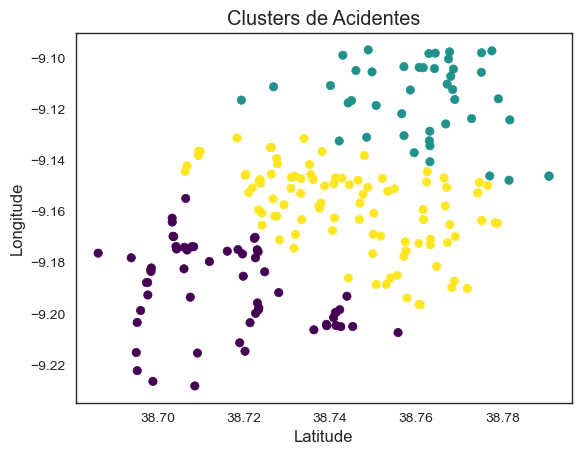

In [107]:
# Visualização dos Clusters
plt.scatter(df_cluster_kmeans['Latitude GPS'], df_cluster_kmeans['Longitude GPS'], 
            c=df_cluster_kmeans['Cluster'], cmap='viridis')
plt.title('Clusters de Acidentes')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.show()

In [108]:
# Coordenadas centrais para o mapa
latitude_central = df_cluster_kmeans['Latitude GPS'].mean()
longitude_central = df_cluster_kmeans['Longitude GPS'].mean()

# Criar um Mapa
mapa = folium.Map(location=[latitude_central, longitude_central], zoom_start=12, control_scale=True)
basemaps['Google Maps'].add_to(mapa)
basemaps['Google Satellite'].add_to(mapa)
plugins.Fullscreen(position='topright').add_to(mapa)  # Opção de Fullscreen
mapa.add_child(plugins.MiniMap(toggle_display=True))  # Minimapa do lado direito
# plugins.Draw().add_to(mapa)                           # Opções de Desenhar
heatmap.add_to(mapa)                                  # HeatMap
# colormap.add_to(mapa)                               # Barra de Cor do HeatMap
mapa.add_child(folium.LayerControl())                 # Camadas de Diferentes Mapas
plugins.FloatImage(image = 'https://radaresavista.pt/wp-content/uploads/2023/01/logo-ANSR.svg', bottom=8, left=2, width='100px').add_to(mapa)        # Logo ANSR
# mapa.add_child(ClickForOneMarker())

# Cores
import matplotlib.colors as colors
mapper = dict(zip(df_cluster_kmeans.index, df_cluster_kmeans.Cluster))
colors_dict = {'1': '#440154', '2':'#21918C', '3':'#FDE725'}                          
colors_code = {}

# Adicionar cores ao dicionário mapper
for key, value in mapper.items():
    colors_code[key] = f"{colors_dict[list(colors_dict.keys())[value]]}"

# Adicionar marcadores para cada ponto no cluster com cores diferentes
for idx, row in df_cluster_kmeans.iterrows():
    folium.Circle(
        location=[row['Latitude GPS'], row['Longitude GPS']],
        radius=150,
        popup=folium.Popup(generate_acidentes_popup(row), max_width=300),
        fill_color=colors_code[idx],
        fill_opacity=0.6, 
        color='transparent'
    ).add_to(mapa)

# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR_lisboa.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
for index, radar_ in radares_Portugal_Lisboa.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)
mapa

---

##  Clusterização dos Pontos Negros usando o `OPTICS`: 

In [109]:
# Algoritmo: https://scikit-learn.org/stable/modules/generated/sklearn.cluster.OPTICS.html

# Selecionar os dados para a clusterização
df_cluster_OPTICS = df_acidentes_radares_NA_remove_2016_2019

# Aplicar o OPTICS
optics = OPTICS(min_samples= 4)  # 4 com base na literatura (Ester et al., 1996)
df_cluster_OPTICS['Cluster'] = optics.fit_predict(df_cluster_OPTICS[['Latitude GPS', 'Longitude GPS']])

# Contar o número de pontos em cada cluster
num_clusters = len(set(df_cluster_OPTICS['Cluster']))
print("Número de clusters:", num_clusters-1, '\n')
df_cluster_OPTICS['Cluster'].value_counts()

Número de clusters: 19 



Cluster
-1     83
 14    11
 2     10
 12     9
 15     8
 9      7
 17     7
 16     7
 8      7
 1      7
 11     6
 18     6
 4      6
 5      6
 10     5
 0      4
 7      4
 13     4
 6      4
 3      4
Name: count, dtype: int64

In [110]:
# Coordenadas centrais para o mapa
latitude_central = df_cluster_OPTICS['Latitude GPS'].mean()
longitude_central = df_cluster_OPTICS['Longitude GPS'].mean()

# Criar um Mapa
mapa = folium.Map(location=[latitude_central, longitude_central], zoom_start=12, control_scale=True)
basemaps['Google Maps'].add_to(mapa)
basemaps['Google Satellite'].add_to(mapa)
plugins.Fullscreen(position='topright').add_to(mapa)  # Opção de Fullscreen
mapa.add_child(plugins.MiniMap(toggle_display=True))  # Minimapa do lado direito
# plugins.Draw().add_to(mapa)                           # Opções de Desenhar
heatmap.add_to(mapa)                                  # HeatMap
# colormap.add_to(mapa)                               # Barra de Cor do HeatMap
mapa.add_child(folium.LayerControl())                 # Camadas de Diferentes Mapas
plugins.FloatImage(image = 'https://radaresavista.pt/wp-content/uploads/2023/01/logo-ANSR.svg', bottom=8, left=2, width='100px').add_to(mapa)        # Logo ANSR
# mapa.add_child(ClickForOneMarker())


# Cores
mapper = dict(zip(df_cluster_OPTICS.index, df_cluster_OPTICS.Cluster))
colors_dict = colors.CSS4_COLORS                          
colors_code = {}

# Adicionar cores ao dicionário mapper
for key, value in mapper.items():
    colors_code[key] = f"{colors_dict[list(colors_dict.keys())[value+1]]}"

# Adicionar marcadores para cada ponto no cluster com cores diferentes
for idx, row in df_cluster_OPTICS.iterrows():
    if row['Cluster'] != -1:
        folium.Circle([row['Latitude GPS'], row['Longitude GPS']], 
                      radius=100,
                      popup=folium.Popup(generate_acidentes_popup(row), max_width=300), 
                      fill_color=colors_code[idx],
                      fill_opacity=0.6, 
                      color='transparent').add_to(mapa)

# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR_lisboa.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
for index, radar_ in radares_Portugal_Lisboa.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)
    
mapa

> Outras tentativas com o **`min_samples`** e os clusters provenientes de cada:

<!DOCTYPE html>
<html lang="en">
<head>
  <meta charset="UTF-8">
  <meta name="viewport" content="width=device-width, initial-scale=1.0">
  <style>
    body {
      font-family: Arial, sans-serif;
      margin: 20px;
    }

    h2 {
      text-align: center;
    }

    table {
      width: 80%;
      margin: 20px auto;
      border-collapse: collapse;
      border-spacing: 0;
      box-shadow: 0 4px 8px rgba(0, 0, 0, 0.1);
    }

    th, td {
      padding: 12px;
      text-align: center;
      border-bottom: 1px solid #ddd;
    }

    th {
      background-color: #f2f2f2;
    }

    tr:nth-child(even) {
      background-color: #f9f9f9;
    }

    tr:hover {
      background-color: #f5f5f5;
    }
  </style>
</head>
<body>
  <table>
    <thead>
      <tr>
        <th>Valores de min_samples</th>
        <th>Nº de clusters formados</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>2</td>
        <td>66</td>
      </tr>
      <tr>
        <td>3</td>
        <td>29</td>
      </tr>
      <tr>
        <td>4</td>
        <td>19</td>
      </tr>
      <tr>
        <td>5</td>
        <td>16</td>
      </tr>
      <tr>
        <td>6</td>
        <td>12</td>
      </tr>
    </tbody>
  </table>

</body>
</html>


---

## Clusterização dos Pontos Negros usando o `DBSCAN`: 

### Clusterização com o dataframe com imputação por `KNN`

De forma a testar a eficiência da imputação por **`KNN`** na clusterização de pontos negros, experimentou-se o seguinte:

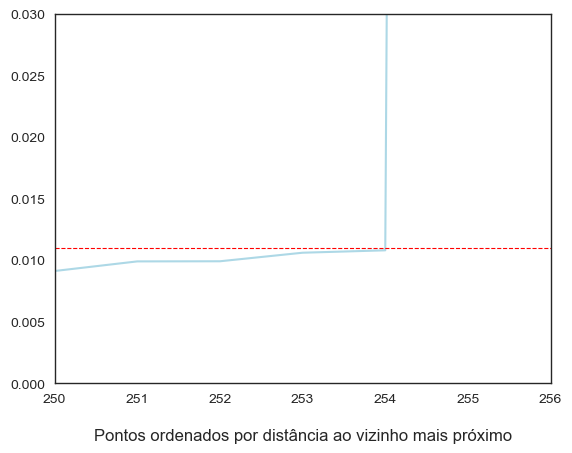

In [111]:
# Fonte: https://medium.com/@tarammullin/dbscan-parameter-estimation-ff8330e3a3bd 

# Calcular a distância média entre cada ponto do conjunto de dados e os seus vizinhos mais próximos.
neighbors = NearestNeighbors()
neighbors_fit = neighbors.fit(df_acidentes_radares_KNN_2016_2019[['Latitude GPS', 'Longitude GPS']])
distances, indices = neighbors_fit.kneighbors(df_acidentes_radares_KNN_2016_2019[['Latitude GPS', 'Longitude GPS']])

# Ordenar os valores das distâncias por ordem crescente e desenhar
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances, color='lightblue')
plt.xlabel('\nPontos ordenados por distância ao vizinho mais próximo')
plt.axhline(y=0.011, linestyle='--', color='red', linewidth=0.8)
plt.xlim(250,256)
plt.ylim(0,0.03)
plt.show();

In [112]:
# Algortimo: https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html 
#            https://geoffboeing.com/2014/08/clustering-to-reduce-spatial-data-set-size


# Selecionar os dados para a clusterização
df_cluster_DBSCAN_KNN = df_acidentes_radares_KNN_2016_2019.copy(deep=True)

# Converter para radianos
df_radians = np.radians(df_cluster_DBSCAN_KNN[['Latitude GPS', 'Longitude GPS']])

# Calcular a distância usando BallTree
kms_per_radian = 6371.0088
epsilon = 0.5 / kms_per_radian         # Considerando uma distância entre pontos de 500m
print(f'Valor atual do Epsilon: {epsilon:.10f}')
ball_tree = BallTree(df_radians, metric='haversine')

# Aplicar o DBSCAN
db = DBSCAN(eps=epsilon,            # Medida de distância que é usada para localizar os pontos na vizinhança de qualquer ponto
            min_samples=4,          # Nº mínimo de pontos a considerar num cluster para que este traduza uma região densa
            algorithm='ball_tree', 
            metric='haversine'
           ).fit(df_radians)

df_cluster_DBSCAN_KNN['Cluster'] = db.labels_
num_clusters = len(set(df_cluster_DBSCAN_KNN['Cluster']))

print("Número de clusters:", num_clusters -1, '\n')
df_cluster_DBSCAN_KNN['Cluster'].value_counts()

Valor atual do Epsilon: 0.0000784805
Número de clusters: 15 



Cluster
 3     88
-1     67
 4     17
 7     12
 0     11
 2     11
 6      9
 12     6
 1      5
 13     5
 8      5
 10     5
 5      4
 14     4
 9      4
 11     3
Name: count, dtype: int64

In [113]:
##### Adaptado de: https://sarkiskassounian.medium.com/using-folium-dbscan-and-foursquare-for-spatial-analysis-3b862e5e7207

# Coordenadas centrais para o mapa
latitude_central = df_cluster_DBSCAN_KNN['Latitude GPS'].mean()
longitude_central = df_cluster_DBSCAN_KNN['Longitude GPS'].mean()

# Criar um Mapa
mapa = folium.Map(location=[latitude_central, longitude_central], zoom_start=12, control_scale=True)
basemaps['Google Maps'].add_to(mapa)
basemaps['Google Satellite'].add_to(mapa)
plugins.Fullscreen(position='topright').add_to(mapa)  # Opção de Fullscreen
mapa.add_child(plugins.MiniMap(toggle_display=True))  # Minimapa do lado direito
# plugins.Draw().add_to(mapa)                           # Opções de Desenhar
heatmap.add_to(mapa)                                  # HeatMap
# colormap.add_to(mapa)                               # Barra de Cor do HeatMap
mapa.add_child(folium.LayerControl())                 # Camadas de Diferentes Mapas
plugins.FloatImage(image = 'https://radaresavista.pt/wp-content/uploads/2023/01/logo-ANSR.svg', bottom=8, left=2, width='100px').add_to(mapa)        # Logo ANSR
# mapa.add_child(ClickForOneMarker())

# Cores
mapper = dict(zip(df_cluster_DBSCAN_KNN.index, df_cluster_DBSCAN_KNN.Cluster))
colors_dict = colors.CSS4_COLORS                          
colors_code = {}

# Adicionar cores ao dicionário mapper
for key, value in mapper.items():
    colors_code[key] = f"{colors_dict[list(colors_dict.keys())[value+1]]}"

# Adicionar marcadores para cada ponto no cluster com cores diferentes
for idx, row in df_cluster_DBSCAN_KNN.iterrows():
    if row['Cluster'] != -1:
        folium.Circle([row['Latitude GPS'], row['Longitude GPS']], 
                      radius=100,
                      popup=folium.Popup(generate_acidentes_popup(row), max_width=300), 
                      fill_color=colors_code[idx],
                      fill_opacity=0.6, 
                      color='transparent').add_to(mapa)

# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR_lisboa.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
for index, radar_ in radares_Portugal_Lisboa.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)
mapa

### Clustering com dataframe sem `NAs`

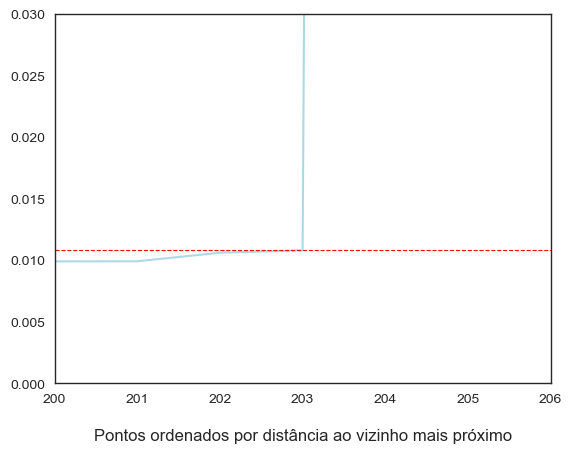

In [114]:
# Calcular a distância média entre cada ponto do conjunto de dados e os seus vizinhos mais próximos
neighbors = NearestNeighbors()
neighbors_fit = neighbors.fit(df_acidentes_radares_NA_remove_2016_2019[['Latitude GPS', 'Longitude GPS']])
distances, indices = neighbors_fit.kneighbors(df_acidentes_radares_NA_remove_2016_2019[['Latitude GPS', 'Longitude GPS']])

# Ordenar os valores das distâncias por ordem crescente e desenhar
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances, color='lightblue')
plt.xlabel('\nPontos ordenados por distância ao vizinho mais próximo')
plt.axhline(y=0.0108, linestyle='--', color='red', linewidth=0.8)
plt.xlim(200,206)
plt.ylim(0,0.03)
plt.show();

In [115]:
# Selecionar os dados para a clusterização
df_cluster_DBSCAN_NA_remove = df_acidentes_radares_NA_remove_2016_2019.copy(deep=True)

# Converter para radianos
df_radians = np.radians(df_cluster_DBSCAN_NA_remove[['Latitude GPS', 'Longitude GPS']])

# Calcular a distância usando BallTree
kms_per_radian = 6371.0088
epsilon = 0.5 / kms_per_radian  # Considerando uma distância entre pontos de 500m
print(f'Valor atual do Epsilon: {epsilon:.10f}')
ball_tree = BallTree(df_radians, metric='haversine')

# Aplicar o DBSCAN
db = DBSCAN(eps=epsilon,            # Medida de distância que é usada para localizar os pontos na vizinhança de qualquer ponto
            min_samples=4,          # Nº mínimo de pontos a considerar num cluster para que este traduza uma região densa
            algorithm='ball_tree', 
            metric='haversine'
           ).fit(df_radians)
df_cluster_DBSCAN_NA_remove['Cluster'] = db.labels_
num_clusters = len(set(df_cluster_DBSCAN_NA_remove['Cluster']))

print("Número de clusters:", num_clusters -1, '\n') 
df_cluster_DBSCAN_NA_remove['Cluster'].value_counts()

Valor atual do Epsilon: 0.0000784805
Número de clusters: 16 



Cluster
-1     75
 6     20
 5     15
 3     13
 0     11
 2     11
 9      8
 8      8
 13     6
 12     5
 7      5
 1      5
 14     5
 10     5
 11     5
 4      4
 15     4
Name: count, dtype: int64

In [116]:
# Adaptado de: https://sarkiskassounian.medium.com/using-folium-dbscan-and-foursquare-for-spatial-analysis-3b862e5e7207
#              https://medium.com/@kumartan1912/spatial-visualization-folium-maps-python-43c3bc150603

# Coordenadas centrais para o mapa
latitude_central = df_cluster_DBSCAN_NA_remove['Latitude GPS'].mean()
longitude_central = df_cluster_DBSCAN_NA_remove['Longitude GPS'].mean()

# Criar um Mapa
mapa = folium.Map(location=[latitude_central, longitude_central], zoom_start=12, control_scale=True)
basemaps['Google Maps'].add_to(mapa)
basemaps['Google Satellite'].add_to(mapa)
plugins.Fullscreen(position='topright').add_to(mapa)  # Opção de Fullscreen
mapa.add_child(plugins.MiniMap(toggle_display=True))  # Minimapa do lado direito
# plugins.Draw().add_to(mapa)                           # Opções de Desenhar
heatmap.add_to(mapa)                                  # HeatMap
# colormap.add_to(mapa)                               # Barra de Cor do HeatMap
mapa.add_child(folium.LayerControl())                 # Camadas de Diferentes Mapas
plugins.FloatImage(image = 'https://radaresavista.pt/wp-content/uploads/2023/01/logo-ANSR.svg', bottom=8, left=2, width='100px').add_to(mapa)        # Logo ANSR
# mapa.add_child(ClickForOneMarker())

# Cores
mapper = dict(zip(df_cluster_DBSCAN_NA_remove.index, df_cluster_DBSCAN_NA_remove.Cluster))
colors_dict = colors.CSS4_COLORS          
colors_code = {}

# Adicionar cores ao dicionário mapper
for key, value in mapper.items():
    colors_code[key] = f"{colors_dict[list(colors_dict.keys())[value]]}"

# Adicionar marcadores para cada ponto no cluster com cores diferentes
for idx, row in df_cluster_DBSCAN_NA_remove.iterrows():
    if row['Cluster'] != -1:
        folium.Circle([row['Latitude GPS'], row['Longitude GPS']], 
                      radius=100,
                      popup=folium.Popup(generate_acidentes_popup(row), max_width=300), 
                      fill_color=colors_code[idx],
                      fill_opacity=0.6, 
                      color='transparent').add_to(mapa)

# Adicionar marcadores para os Radares da ANSR (Azul) e 'Radares de Portugal' (Cizento)
for index, radar in radares_ANSR_lisboa.iterrows():
    location = [radar['Latitude'], radar['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar['Tipo'] == 'VI':
        color = 'darkblue'   # Velocidade Instantânea
    else:
        color = 'lightblue'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(generate_radares_ANSR_popup(radar), max_width=300)
                 ).add_to(mapa)
    
for index, radar_ in radares_Portugal_Lisboa.iterrows():
    location = [radar_['Latitude'], radar_['Longitude']]
    
    # Escolher a cor com base no tipo de radar
    if radar_['Type'] == 'VI':
        color = 'gray'       # Velocidade Instantânea
    else:
        color = 'lightgray'  # Velocidade Média
    
    # Adicionar marcador ao mapa
    folium.Marker(location, 
                  icon=folium.Icon(color=color, icon='circle-exclamation', prefix='fa'),
                  popup=folium.Popup(f'<b>Velocidade:</b> {radar_["Speed"]} <br> \
                                       <b>Tipo de Radar:</b> {radar_["Type"]} \
                                       <a href=https://www.google.com/maps?layer=c&cbll={radar_["Latitude"]},{radar_["Longitude"]} target=blank><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/Google_Street_View_icon.svg/768px-Google_Street_View_icon.svg.png" style="width:40px;margin:0 auto;display: block;margin-left: auto; margin-right: auto; margin-top:5px"></img></a>',
                                     max_width=300)).add_to(mapa)

# mapa.save('MapaFolium_Clusters.html')
mapa

> Mais uma vez, foi possível concluír que os resultados obtidos pela imputação por **KNN** e os resultados obtidos **removendo os omissos** são relativamente os mesmos, levando à decisão

>Outras experiências feitas alterando o parâmetro **`Epsilon`**: 


<!DOCTYPE html>
<html lang="en">
<head>
  <meta charset="UTF-8">
  <meta name="viewport" content="width=device-width, initial-scale=1.0">
  <style>
    body {
      font-family: Arial, sans-serif;
      margin: 20px;
    }

    h2 {
      text-align: center;
    }

    table {
      width: 80%;
      margin: 20px auto;
      border-collapse: collapse;
      border-spacing: 0;
      box-shadow: 0 4px 8px rgba(0, 0, 0, 0.1);
    }

    th, td {
      padding: 12px;
      text-align: center;
      border-bottom: 1px solid #ddd;
    }

    th {
      background-color: #f2f2f2;
    }

    tr:nth-child(even) {
      background-color: #f9f9f9;
    }

    tr:hover {
      background-color: #f5f5f5;
    }
  </style>
</head>
<body>  
  <table>
    <thead>
      <tr>
        <th>Valores de ε</th>
        <th>Equivalência Métrica (m)</th>
        <th>Nº de clusters formados</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>0.0000157</td>
        <td>100</td>
        <td>0</td>
      </tr>
      <tr>
        <td>0.0000314</td>
        <td>200</td>
        <td>3</td>
      </tr>
      <tr>
        <td>0.0000471</td>
        <td>300</td>
        <td>7</td>
      </tr>
      <tr>
        <td>0.0000628</td>
        <td>400</td>
        <td>15</td>
      </tr>
      <tr>
        <td>0.0000785</td>
        <td>500</td>
        <td>16</td>
      </tr>
    </tbody>
  </table>

</body>
</html>


---

## Análise dos Locais Mais Preponderantes para a Colocação de Novos Radares:

In [117]:
# Agrupar por 'Cod Via' e contar o número de pontos em cada cluster
clusters_por_via = df_cluster_DBSCAN_NA_remove.groupby(['Cod Via', 'Cluster']).size().reset_index(name='Contagem')

# Encontrar o cluster para cada 'Cod Via'
cluster_mais_comum_por_via = clusters_por_via.groupby('Cod Via')['Contagem'].idxmax()

# Filtrar os clusters para cada 'Cod Via'
clusters_mais_comuns = clusters_por_via.loc[cluster_mais_comum_por_via]

# Clusters por 'Cod Via'
print("Clusters mais comuns por Cod Via:")
clusters_mais_comuns

Clusters mais comuns por Cod Via:


,Cod Via,Cluster,Contagem
0,0,-1,63
17,A2,-1,1
21,A5,11,4
23,IC17,0,5
24,IC19,0,1
25,IC2,-1,1
26,IP7,-1,4
28,PNT25ABRIL,-1,1


# Caracterização dos Clusters - Variáveis de *Profile*

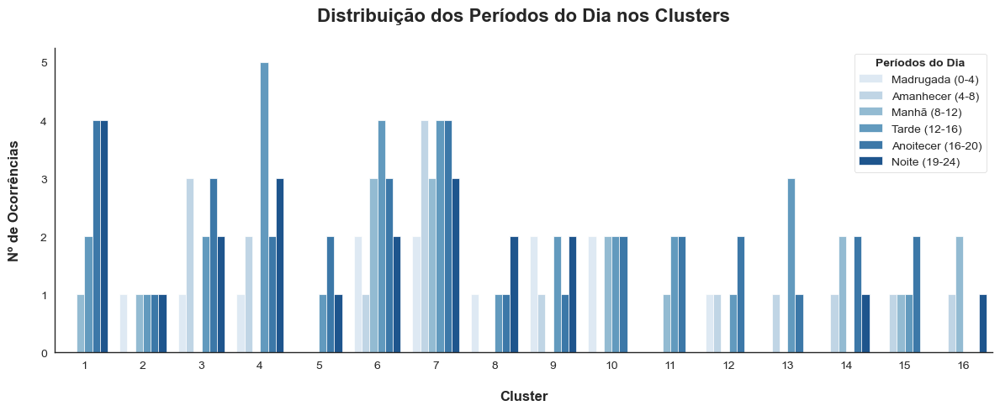

In [118]:
# Criar um DataFrame com as variáveis relevantes
ordem_periodos_dia = ['Madrugada (0-4)', 'Amanhecer (4-8)', 'Manhã (8-12)', 'Tarde (12-16)', 'Anoitecer (16-20)', 'Noite (19-24)']
df_plot = df_cluster_DBSCAN_NA_remove[['Cluster', 'Hora_Dia']]
df_plot['Hora_Dia'] = pd.Categorical(df_plot['Hora_Dia'], categories=ordem_periodos_dia, ordered=True)
df_plot['Cluster'] = df_plot['Cluster'] + 1
df_plot = df_plot[df_plot['Cluster'] != 0]

# Criar um gráfico de barras empilhadas
fig, ax = plt.subplots(figsize=(12, 5))
sns.countplot(x='Cluster', hue='Hora_Dia', data=df_plot, palette='Blues')
plt.title('Distribuição dos Períodos do Dia nos Clusters\n', fontsize=16, fontweight='bold')
plt.xlabel('\nCluster', fontweight='bold')
plt.ylabel('Nº de Ocorrências\n', fontweight='bold')
legenda = plt.legend(title='Períodos do Dia')
legenda.get_title().set_fontweight('bold')
sns.despine(top=True, right=True, left=False, bottom=False)
fig.tight_layout()
# fig.savefig("Gráficos/8_Caracterização dos Clusters_Períodos do Dia.svg",format='svg',dpi=1200)
plt.show();

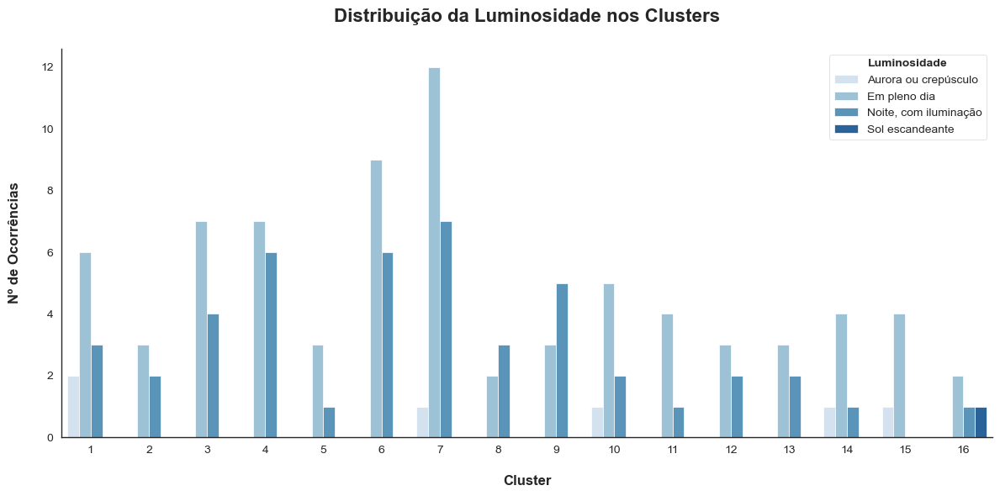

In [119]:
# Criar um DataFrame com as variáveis relevantes
df_plot = df_cluster_DBSCAN_NA_remove[['Cluster', 'Luminosidade']]
df_plot['Cluster'] = df_plot['Cluster'] + 1
df_plot = df_plot[df_plot['Cluster'] != 0]

# Criar um gráfico de barras empilhadas
fig, ax = plt.subplots(figsize=(12, 6))
sns.countplot(x='Cluster', hue='Luminosidade', data=df_plot, palette='Blues')
plt.title('Distribuição da Luminosidade nos Clusters\n', fontsize=16, fontweight='bold')
plt.xlabel('\nCluster', fontweight='bold')
plt.ylabel('Nº de Ocorrências\n', fontweight='bold')
legenda = plt.legend(title='Luminosidade')
legenda.get_title().set_fontweight('bold')
sns.despine(top=True, right=True, left=False, bottom=False)
fig.tight_layout()
# fig.savefig("Gráficos/9_Caracterização dos Clusters_Luminosidade.svg",format='svg',dpi=1200)
plt.show();

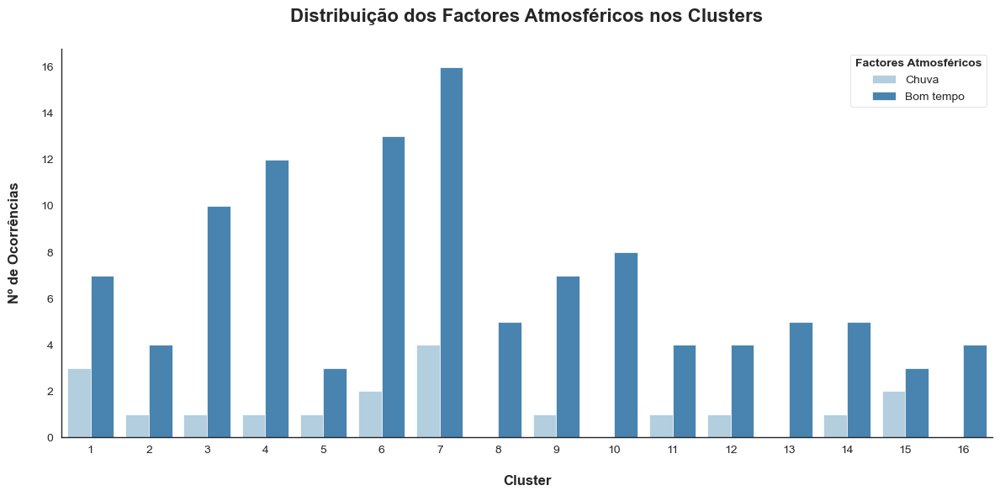

In [120]:
# Criar um DataFrame com as variáveis relevantes
df_plot = df_cluster_DBSCAN_NA_remove[['Cluster', 'Factores Atmosféricos']]
df_plot['Cluster'] = df_plot['Cluster'] + 1
df_plot = df_plot[df_plot['Cluster'] != 0]

# Criar um gráfico de barras empilhadas
fig, ax = plt.subplots(figsize=(12, 6))
sns.countplot(x='Cluster', hue='Factores Atmosféricos', data=df_plot, palette='Blues')
plt.title('Distribuição dos Factores Atmosféricos nos Clusters\n', fontsize=16, fontweight='bold')
plt.xlabel('\nCluster', fontweight='bold')
plt.ylabel('Nº de Ocorrências\n', fontweight='bold')
legenda = plt.legend(title='Factores Atmosféricos')
legenda.get_title().set_fontweight('bold')
sns.despine(top=True, right=True, left=False, bottom=False)
fig.tight_layout()
# fig.savefig("Gráficos/10_Caracterização dos Clusters_Factores Atmosféricos.svg",format='svg',dpi=1200)
plt.show();

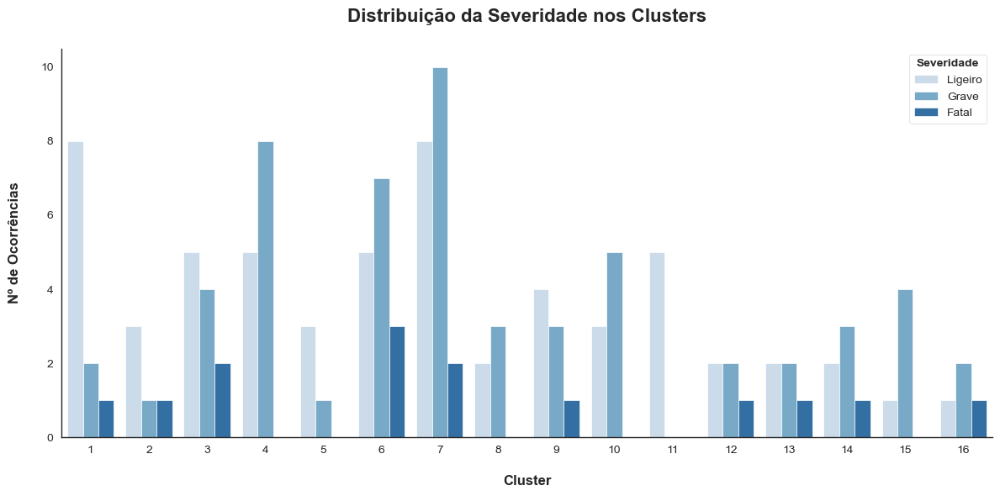

In [121]:
# Criar um DataFrame com as variáveis relevantes
df_plot = df_cluster_DBSCAN_NA_remove[['Cluster', 'Severidade']]
df_plot['Cluster'] = df_plot['Cluster'] + 1
df_plot = df_plot[df_plot['Cluster'] != 0]

# Criar um gráfico de barras empilhadas
fig, ax = plt.subplots(figsize=(12, 6))
sns.countplot(x='Cluster', hue='Severidade', data=df_plot, palette='Blues')
plt.title('Distribuição da Severidade nos Clusters\n', fontsize=16, fontweight='bold')
plt.xlabel('\nCluster', fontweight='bold')
plt.ylabel('Nº de Ocorrências\n', fontweight='bold')
legenda = plt.legend(title='Severidade')
legenda.get_title().set_fontweight('bold')
sns.despine(top=True, right=True, left=False, bottom=False)
fig.tight_layout()
# fig.savefig("Gráficos/11_Caracterização dos Clusters_Severidade.svg",format='svg',dpi=1200)
plt.show();

---

# <a class='anchor' id='M_2Obje'></a> 2º Objetivo | 📅 Tendências

### Etapas

- Analisar a série temporal
---
- Criar um modelo de previsão temporal que consiga prever o número de acidentes mensais.

---

### 💡 Análise da Série Temporal e Modelo Arima
##### Análise da Série Temporal | Sazonalidade, Tendência e Resíduos

In [122]:
# pip install pmdarima

In [123]:
# Bibliotecas para a Série Temporal
from pmdarima.arima import auto_arima
from pmdarima import arima
from pmdarima.utils import tsdisplay, autocorr_plot, decomposed_plot, plot_acf, plot_pacf
from pmdarima.arima import ADFTest

# Restaurar as cores padrão
sns.set()
sns.set_style("white")

In [124]:
# Reamostrar os dados para a frequência mensal
df_acidentes['Datahora'] = pd.to_datetime(df_acidentes['Datahora'])
df_mensal = df_acidentes.resample('M', on='Datahora')['Id. Acidente'].count()

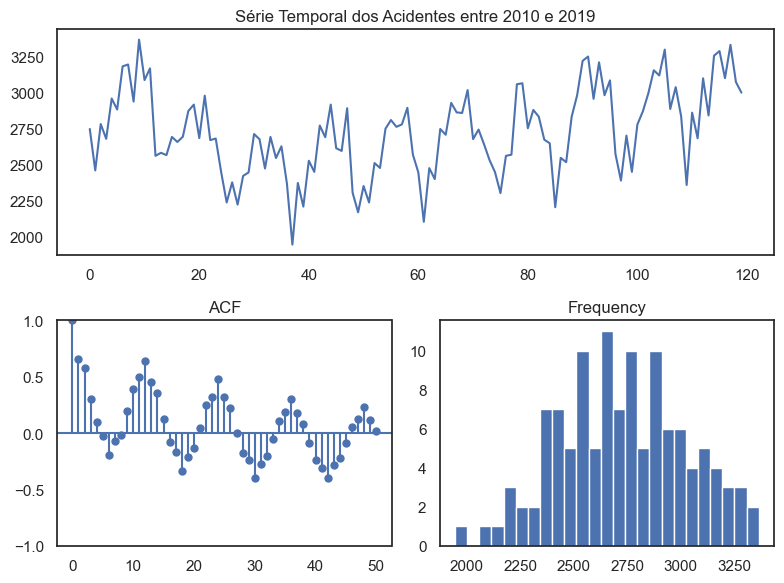

In [125]:
# Gráficos da função tsdisplay
#      - Série Temporal dos Acidentes entre 2010 e 2019
#      - Gráfico da Autocorrelação
#      - Histograma das Frequências
tsdisplay(df_mensal, title='Série Temporal dos Acidentes entre 2010 e 2019')
# plot.savefig("Gráficos/12_Gráficos da função tsdisplay.svg",format='svg',dpi=1200) # Sendo a o plt o gráfico de cima com parâmetro 'show=False'

> O nosso $x$ na Série Temporal é o tempo em **meses**.

##### Análise da Série Temporal | Sazonalidade, Tendência e Resíduos

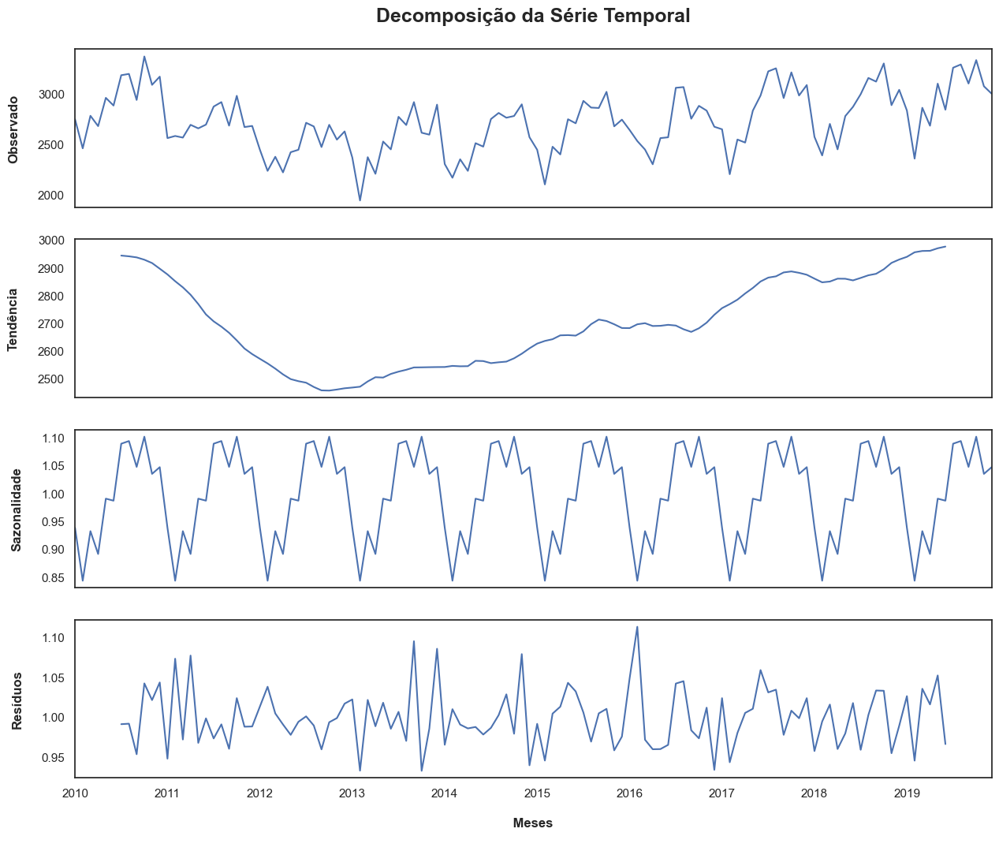

In [126]:
# Agrupar os acidentes pelo mês
time_series = df_acidentes.set_index('Datahora').resample('M').size().reset_index().rename(columns={0: 'Acidentes_Mensal'})
time_series.index = time_series['Datahora']
del time_series['Datahora']


# Restaurar as cores padrão
sns.set()
sns.set_style("white")

# Estudar a Sazonalidade, Tendência e Resíduos da Série Temporal
decompose = seasonal_decompose(time_series['Acidentes_Mensal'], model='multiplicative')
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(15, 12), sharex=True)

# Adicionar títulos em negrito e quebrar linha
ax1.set_title('Decomposição da Série Temporal\n', fontweight='bold', fontsize=18)
decompose.observed.plot(ax=ax1)
ax1.set_ylabel('Observado\n', fontweight='bold')

decompose.trend.plot(ax=ax2)
ax2.set_ylabel('Tendência\n', fontweight='bold')

decompose.seasonal.plot(ax=ax3)
ax3.set_ylabel('Sazonalidade\n', fontweight='bold')

decompose.resid.plot(ax=ax4)
ax4.set_ylabel('Resíduos\n', fontweight='bold')
plt.xlabel('\n Meses \n', fontweight='bold')
# fig.savefig("Gráficos/Decomposição da Série Temporal.svg",format='svg',dpi=1200)
plt.show();

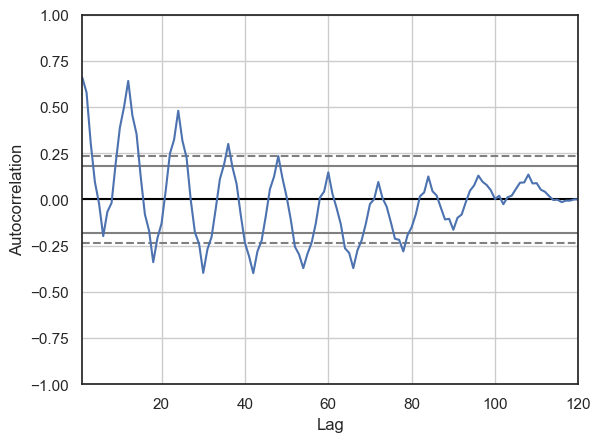

In [127]:
# Gráfico de autocorrelação para todos os períodos da série
autocorr_plot(df_mensal)

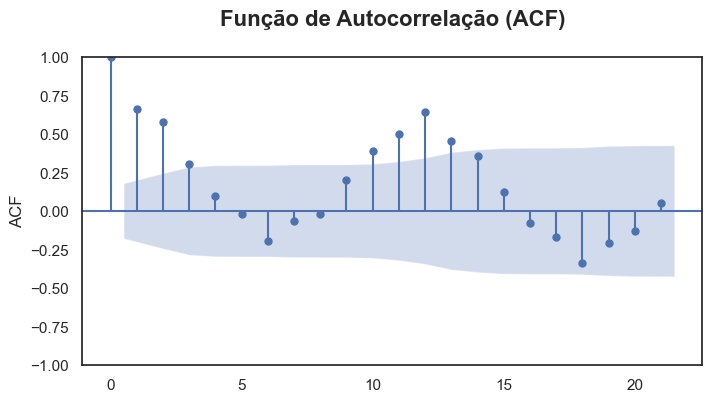

In [128]:
# ACF - Função de Autocorrelação
# fig, ax = plt.subplots(figsize=(16, 4))
fig, ax = plt.subplots(figsize=(8, 4))
plot_acf(df_mensal, alpha=0.05, ax=ax, show=False)
ax.set_ylabel('ACF')
ax.set_title('Função de Autocorrelação (ACF)\n', fontweight='bold', fontsize=16)
# plt.savefig("Gráficos/13_ACF.svg",format='svg',dpi=1200)
plt.show();

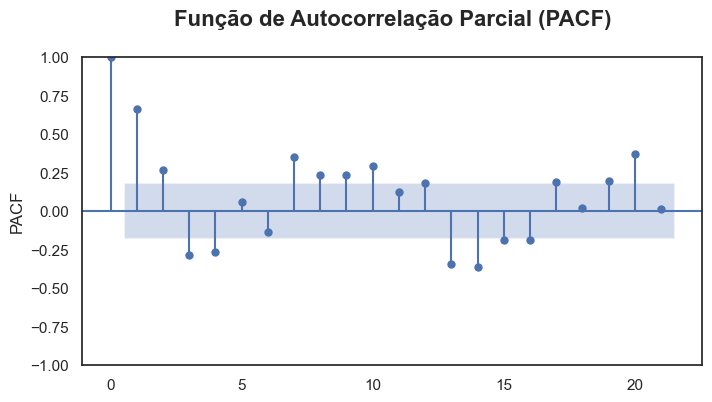

In [129]:
# PACF - Função de Autocorrelação Parcial
# fig, ax = plt.subplots(figsize=(16, 4))
fig, ax = plt.subplots(figsize=(8, 4))
plot_pacf(df_mensal, alpha=0.05, ax=ax, show=False)
ax.set_ylabel('PACF')
ax.set_title('Função de Autocorrelação Parcial (PACF)\n', fontweight='bold', fontsize=16)
# plt.savefig("Gráficos/14_PACF.svg",format='svg',dpi=1200)
plt.show();

- Cada valor do **AFC** e **PAFC** é o valor da correlação.

> Através da observação do **1º Gráfico** ve-se que a série é Sazonal - **Anual**

> Ao longo de $k$ lags ve-se que a ST vai perdendo a dependencia $\rightarrow$ Logo **perde memória de forma lenta**

## 🌱 Raiz Unitária

### Testes de Hipóteses

- Verificar se a série temporal é **Estacionária** (média, variância e covariância constantes)

> **Teste de Raiz Unitária - ADF**

   - $H_0$: existe uma raiz unitária = série temporal não-estacionária

        - $p-value > 0.05$, indique que não rejeitamos a H0, logo a série é não-estacionária
        
        - $p-value < 0.05$, indique que rejeitamos a H0, logo a série é estacionária
        
> **Teste de Estacionaridade de KPSS**

- $H_0$: série estacionária

    - p-value > 0.05, indique que não rejeitamos a H0, logo a série é estacionária
    - p-value < 0.05, indique que rejeitamos a H0, logo a série é não-estacionária

In [130]:
from statsmodels.tsa.stattools import adfuller

# Teste ADF - Teste de Augmented Dickey Fuller
ADF = adfuller(df_mensal, autolag='AIC', regression='c')
print("ADF Statistic:", ADF[0])
print("P-value:", ADF[1])
print("Critical Values:", ADF[4])

ADF Statistic: -1.044031132617612
P-value: 0.7368682826133194
Critical Values: {'1%': -3.4936021509366793, '5%': -2.8892174239808703, '10%': -2.58153320754717}


In [131]:
from statsmodels.tsa.stattools import kpss

# Teste KPSS - Teste Kwiatkowski-Phillips-Schmidt-Shin
KPSS = kpss(df_mensal, regression='c')
print("KPSS Statistic:", KPSS[0])
print("P-value:", KPSS[1])

KPSS Statistic: 0.518337684054797
P-value: 0.037536557645316


> Como seria de esperar a série temporal é não-estacionária dado que tem sazonalidade.

### Modelo `autoARIMA`

In [132]:
# Fonte: https://ivanildo-batista13.medium.com/autoarima-em-python-26303d650de3
# Função AutoARIMA: Escolhe os melhores parâmetros p,d e q e, para presença de sazonalidade 
#                   na série temporal, os parâmetros P, D e Q.
# Parâmetros:
# ARIMA
# - p (Componente Autorregressivo da série e que vai variar entre 1 e 6) 
# - d (Componente de Diferenciação até ser estacionária e será 1 e o máximo, por padrão, será 2)
# - q (Componente de médias móveis e que vai variar entre 1 e 6)

# Sazonalidade
# - P (Componente Autorregressivo da Sazonalidade, que vai de 1 a 2)
# - D (Componente de Diferenciação da Sazonalidade)
# - Q (Componente de Médias Móveis da Sazonalidade, que varia de 1 a 2) 
# - m (Periodicidade da Sazonalidade - 12 - Mensal).

# Stepwise é uma técnica de ajuste de modelos de regressão em que a escolha das 
#          variáveis preditivas é realizada por um procedimento automático.
stepwise=auto_arima(df_mensal,
                    start_p=0,
                    start_q=0,
                    d=0,
                    max_p=6,
                    max_q=6,
                    max_d=2,
                    start_P=1,
                    start_Q=1,
                    D=1,
                    max_P=2, max_D=1, max_Q=2, max_order=5,
                    m=12,
                    seasonal=True,
                    trace=True,
                    error_action='ignore',
                    suppress_warnings=True,
                    stepwise=True)

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.70 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=1460.985, Time=0.02 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=1421.228, Time=0.28 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.61 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=1459.002, Time=0.02 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=1442.124, Time=0.08 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=1417.821, Time=0.84 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=1.45 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.86 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=1459.558, Time=0.60 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=1396.362, Time=1.08 sec
 ARIMA(2,0,0)(1,1,0)[12] intercept   : AIC=1402.392, Time=0.38 sec
 ARIMA(2,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=1.70 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.73 sec
 ARIMA(3,0,0)(2,1,0)[12] intercept   : AIC=1393.6

In [133]:
# Melhor Modelo - Parâmetros
stepwise

ARIMA(order=(4, 0, 0), scoring_args={}, seasonal_order=(0, 1, 1, 12),
      suppress_warnings=True, with_intercept=False)

In [134]:
# Melhor Modelo - AIC e BIC
print('AIC:', stepwise.aic())
print('BIC:', stepwise.bic())

AIC: 1374.4771415898779
BIC: 1390.5699289526233


### ⚖️ Divisão em Conjunto Treino/Teste

In [135]:
# Divisão em Conjuntos de Treino e Teste
train_size = int(len(df_mensal) * 0.8)
train, test = df_mensal[:train_size], df_mensal[train_size:]

### 📈 Treino do Melhor Modelo Encontrado

In [136]:
# Melhor Modelo - Treino e Previsão nos dados de Teste
stepwise.fit(train)
previsao = stepwise.predict(n_periods=len(test))
df_previsao = pd.DataFrame(previsao,index=test.index, columns=['Previsão Teste'])
df_previsao

,Previsão Teste
Datahora,
2018-01-31,2709.562140
2018-02-28,2494.707852
2018-03-31,2655.801995
2018-04-30,2583.836443
2018-05-31,2792.017627
2018-06-30,2789.955590
2018-07-31,3055.042740
2018-08-31,3046.856000
2018-09-30,2895.007588


---

# <a class='anchor' id='4'></a>
<br>
<style>
@import url('https://fonts.cdnfonts.com/css/avenir-next-lt-pro?styles=29974');
</style>

<div style="background: linear-gradient(to right,#95B6DF, #222E65); 
            padding: 10px; color: white; border-radius: 300px; text-align: center;">
    <center><h1 style="margin-left: 120px;margin-top: 10px; margin-bottom: 4px; color: white;
                       font-size: 34px; font-family: 'Avenir Next LT Pro', sans-serif;"><b>4 | Evaluation & Deployment</b></h1></center>
</div>

# 1º Objetivo | ⚡Radares

> Dado ser um **Modelo de Aprendizagem Não Supervisionada**, não é possivel considerar métricas de avaliação dos resultados obtidos, pelo que apenas iremos fazer a análise da caracterização dos *clusters* que pode ser lida no relatório e a alocação de radares a 2 troços especificos.

# 2º Objetivo | 📅 Tendências

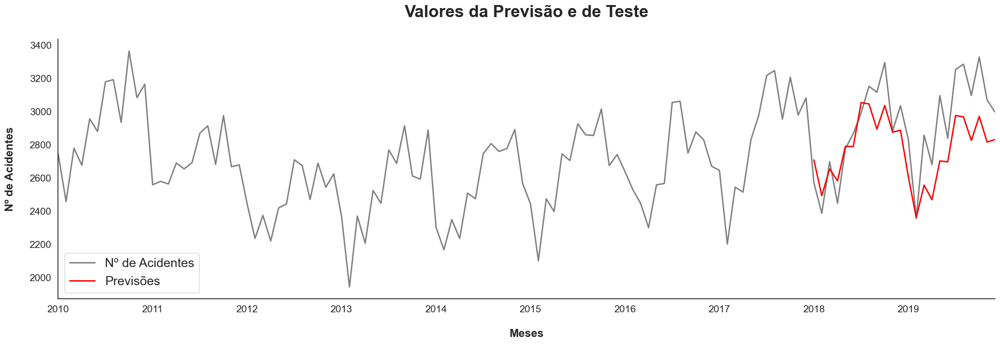

In [159]:
# Gráfico das valores de treino, teste e previsões
pd.concat([df_mensal,df_previsao],axis=1).plot(linewidth=2, figsize=(20,7), color=['gray','red'])
plt.title('Valores da Previsão e de Teste\n', fontsize=24, fontweight='bold')
plt.legend(['Nº de Acidentes','Previsões'], fontsize=18)
plt.xlabel('\nMeses', fontsize=16, fontweight='bold')
plt.ylabel('Nº de Acidentes\n',fontsize=16, fontweight='bold')
plt.tick_params(axis='x', labelsize=14)
plt.tick_params(axis='y', labelsize=14)
sns.despine(top=True, right=True, left=False, bottom=False)
plt.tight_layout()
plt.savefig("Gráficos/PPT_15_Valores da Previsão e de Teste.svg",format='svg',dpi=1200)
plt.show();

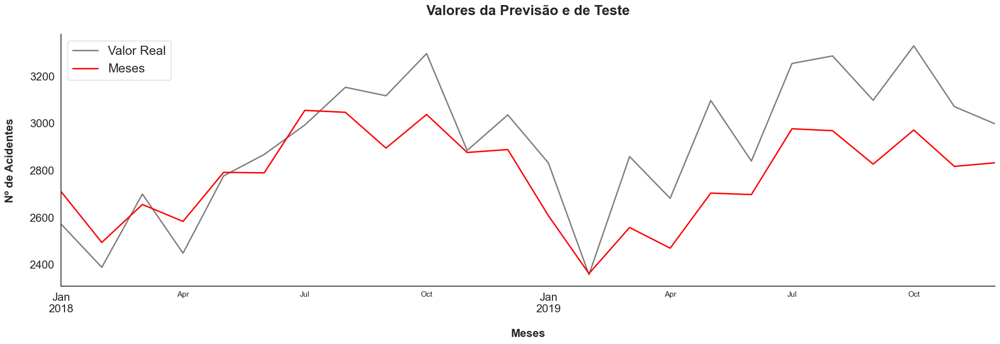

In [167]:
# Gráfico comparativo dos Valores da Previsão e de Teste Ampliado ao período da previsão
pd.concat([test,df_previsao],axis=1).plot(linewidth=2, figsize=(20,7), color=['gray','red'])
plt.title('Valores da Previsão e de Teste\n', fontsize=20, fontweight='bold')
plt.xlabel('\nMeses', fontsize=16, fontweight='bold')
plt.ylabel('Nº de Acidentes\n',fontsize=16, fontweight='bold')
plt.legend(['Valor Real', 'Meses'], fontsize=18)
sns.despine(top=True, right=True, left=False, bottom=False)
plt.tick_params(axis='both', labelsize=16)
plt.tight_layout()
# plt.savefig("Gráficos/PPT_16_Valores da Previsão e de Teste_Zoom.svg",format='svg',dpi=1200)
plt.show();

In [139]:
# Sumário do Melhor Modelo
stepwise.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:                                    y   No. Observations:                   96
Model:             SARIMAX(4, 0, 0)x(0, 1, [1], 12)   Log Likelihood                -532.541
Date:                              Mon, 11 Dec 2023   AIC                           1077.081
Time:                                      17:53:05   BIC                           1091.666
Sample:                                  01-31-2010   HQIC                          1082.944
                                       - 12-31-2017                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2078      0.092      2.251      0.024       0.027       0.389
ar.L2          0.3635      0.108      3.370      0.001       0.152       0.575
ar.L3          0.0668      0.102      0.654      0.513      -0.134       0.267
ar.L4          0.1975      0.124      1.597      0.110      -0.045       0.440
ma.S.L12      -0.9741      1.614     -0.604      0.546      -4.137       2.189
sigma2      1.423e+04   2.16e+04      0.660      0.509    -2.8e+04    5.65e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 1.73
Prob(Q):                              0.95   Prob(JB):                         0.42
Heteroskedasticity (H):               2.26   Skew:                             0.35
Prob(H) (two-sided):                  0.03   Kurtosis:                         2.98
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [140]:
print(stepwise.summary())

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   96
Model:             SARIMAX(4, 0, 0)x(0, 1, [1], 12)   Log Likelihood                -532.541
Date:                              Mon, 11 Dec 2023   AIC                           1077.081
Time:                                      17:53:05   BIC                           1091.666
Sample:                                  01-31-2010   HQIC                          1082.944
                                       - 12-31-2017                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2078      0.092      2.251      0.024       0.027       0.389
ar.L2          0.36

In [141]:
# Média dos Resíduos
residuals = test - previsao
print("Média dos Resíduos:",  residuals.mean())

Média dos Resíduos: 138.23796881714904


### Pressupostos dos Resíduos para o modelo ARMA

1. $E(ε_t )=0$ (os erros têm média zero)
    -  Calcular a Média

<br>

2. $Var⁡(ε_t )=σ^2$ (a variância dos erros é constante e finita - Erros homocedásticos)
     - **`Teste ARCH`** $ \rightarrow H0:$ erros homocedásticos (variância constante)
         - $p-value > 0.05$, indique que não rejeitamos a $H0$, logo os resíduos são homocedásticos
         - $p-value < 0.05$, indique que rejeitamos a $H0$, logo os resíduos são heterocedásticos

<br>

3. $Cov⁡(ε_i,ε_j )=0, i\neq j$ (os erros são linearmente independentes)
      - **`Teste de Box-Ljung`** $\rightarrow$ Permite avaliar a autocorrelação entre uma variável e qualquer lag de qualquer ordem da variável
          - Hipótese nula, $H0$ : o erro presente não é relacionados com nenhum dos seus $r$ valores prévios
          - Rejeitar a $H0$: significa que os erros são auto-correlacionados (não são independentes).
     
<br>

4. $ε_t \sim N(\mu, \sigma)$ - Normalidade (Não é obrigatório)
    - **`Teste Jarque-Bera`** 
        - Rejeitamos a $H_0$ se $\alpha > 0.05$, logo os resíduos **não são normalmente distribuidos**.
        - Não rejeitamos a $H_0$, logo os *Resíduos são Independentes*


<br>

---

> O **`log likelihood`** é outro critério de informação, mas a interprestação é oposta aos outros, ou seja
- Quanto maior for o valor do **`log likelihood`**, melhor é o modelo!     

### Análise do Modelo  SARIMA

> **SARIMA** (*Seasonal AutoRegressive Integrated Moving Average*)

-  **1º Pressuposto** $\rightarrow$ Não se verifica 
-  **2º Pressuposto** $\rightarrow$ Não se verifica 
-  **3º Pressuposto** $\rightarrow$ Não se verifica 
-  **4º Pressuposto** $\rightarrow$ Não se verifica

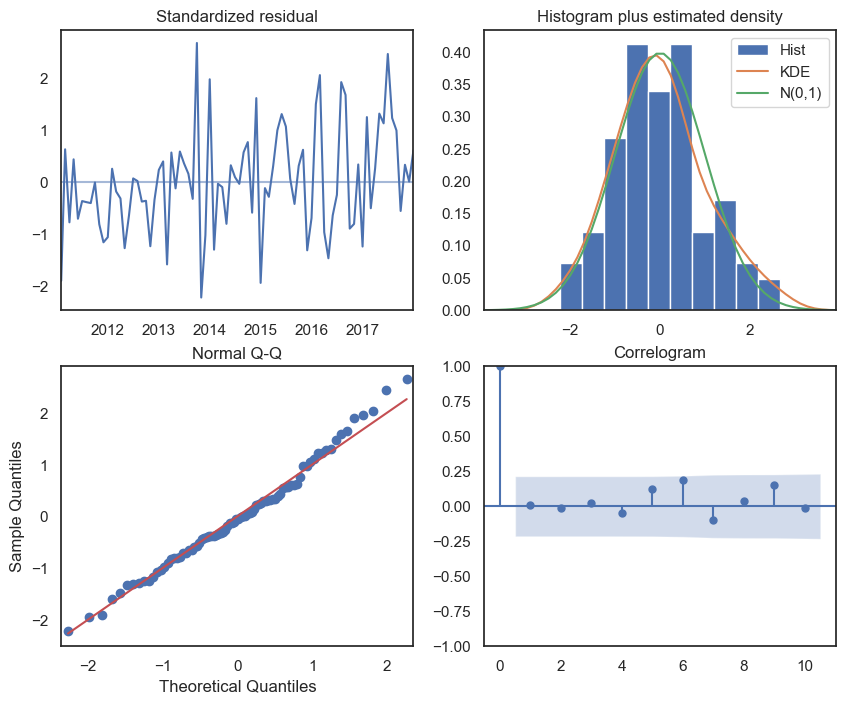

In [142]:
# Análise Gráfica dos Resíduos
stepwise.plot_diagnostics(figsize=(10,8));
# plot.savefig("Gráficos/17_Análise Gráfica dos Resíduos.svg",format='svg',dpi=1200) # Sendo a o plot o gráfico de cima com parâmetro 'show=False'


### Análise Gráfica dos Resíduos

- **Gráfico 2:** A variância é *Leptocurtica* $\rightarrow$ Não constante!

- **Gráfico 4:**  Tudo o que está dentro da zona sombreada, é independete em termos de resíduos!


---

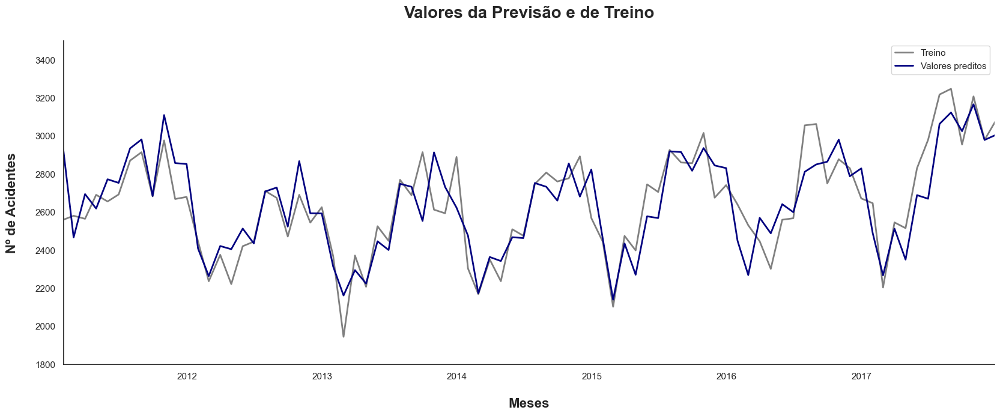

In [143]:
# Modelo SARIMA com os parâmetros que a função autoARIMA definiu.
modelo = SARIMAX(train, order=(4,0,0), seasonal_order=(0, 1, 1, 12)).fit(disp=0)

# Previsão do Modelo nos dados de Treino
predito = modelo.predict(typ='levels')

plt.figure(figsize=(20,7))
plt.plot(train, color='gray', linewidth=2) 
plt.plot(predito,color='navy', linewidth=2)
plt.title('Valores da Previsão e de Treino\n', fontsize=20, fontweight='bold')
plt.xlabel('\nMeses', fontsize=16, fontweight='bold')
plt.ylabel('Nº de Acidentes\n',fontsize=16, fontweight='bold')
plt.xlim(pd.Timestamp('2011-02-01'), pd.Timestamp('2017-12-27'))
plt.ylim(1800,3500)
plt.legend(['Treino','Valores preditos'])
sns.despine(top=True, right=True, left=False, bottom=False)
# plt.savefig("Gráficos/18_Valores da Previsão e de Treino.svg",format='svg',dpi=1200)
plt.show();

---

## 📑 Resumo dos Resultados

In [144]:
# Comparação das Métricas do Modelo no Treino e Teste 
pd.DataFrame({
    'Conjunto': ['Treino', 'Teste'],
    'RMSE': [round(np.sqrt(mean_squared_error(train[12:], predito[12:])),2), 
             round(np.sqrt(mean_squared_error(test, previsao)),1)],
    'MAPE': [round(mean_absolute_percentage_error(train[12:], predito[12:]) * 100, 2),
             round(mean_absolute_percentage_error(test, previsao) * 100, 2)],
    'MAE': [round(mean_absolute_error(train[12:], predito[12:]),2), 
           round(mean_absolute_error(test, previsao),2)]
}).set_index('Conjunto')

,RMSE,MAPE,MAE
Conjunto,,,
Treino,137.07,4.05,107.23
Teste,208.10,5.89,176.54


---

## 🔮 Previsão

In [145]:
# Modelo com todos os dados e previsão futura
stepwise.fit(df_mensal)
previsao_futura = stepwise.predict(n_periods=12)
df_previsao_futura = pd.DataFrame(previsao_futura, columns=['Previsão Futura'])
df_previsao_futura

,Previsão Futura
2020-01-31,2785.281067
2020-02-29,2493.469989
2020-03-31,2743.458353
2020-04-30,2603.195432
2020-05-31,2887.880644
2020-06-30,2853.560817
2020-07-31,3131.679463
2020-08-31,3144.060221
2020-09-30,3002.619819
2020-10-31,3157.885248


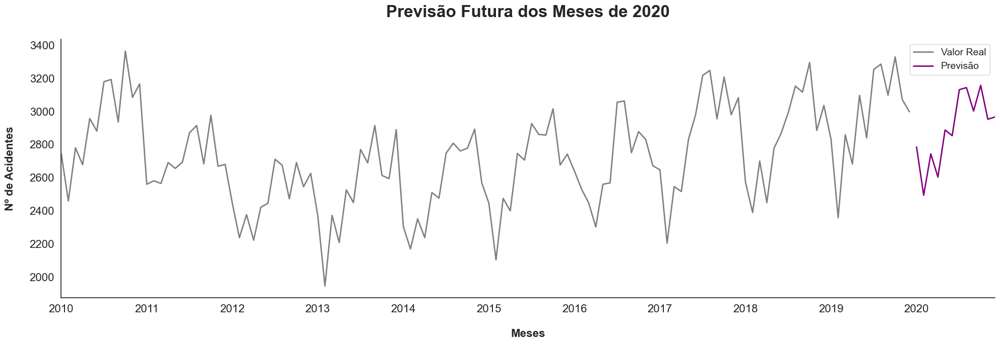

In [169]:
# Gráfico com os Valores Reais entre 2010 e 2019 + Previsão para os meses de 2020
pd.concat([df_mensal,df_previsao_futura],axis=1).plot(linewidth=2, figsize=(20,7), color=['gray','purple'])
plt.title('Previsão Futura dos Meses de 2020\n', fontsize=24, fontweight='bold')
plt.xlabel('\nMeses', fontsize=16, fontweight='bold')
plt.ylabel('Nº de Acidentes\n',fontsize=16, fontweight='bold')
plt.legend(['Valor Real', 'Previsão'], fontsize=14)
sns.despine(top=True, right=True, left=False, bottom=False)
plt.tick_params(axis='both', labelsize=16)
plt.tight_layout()
plt.savefig("Gráficos/PPT_19_Previsão Futura dos Meses de 2020.svg",format='svg',dpi=1200)
plt.show();

---

```Python
# Exportar os dados limpos para vizualização no Dashboard do PowerBI
df_acidentes.to_csv('dados/acidentes_2010_2019_PowerBI.csv', sep=';', index=False)
df_cond_veic.to_csv('dados/cond_veic_2010_2019_PowerBI.csv', sep=';', index=False)
```

---